# Importing the Dependencies and Libraries

In [136]:




import os
import pandas as pd
import numpy as np


import os
from tensorflow.keras.callbacks import ModelCheckpoint, TensorBoard, EarlyStopping

from utils import load_data, split_data, create_model


import pandas as pd  # Library for data manipulation and analysis (e.g., working with DataFrames).
import numpy as np  # Library for mathematical operations and array manipulation.
import os  # Library for interacting with the operating system (e.g., file and directory operations).
import tqdm  # Library for creating progress bars.

from tensorflow.keras.models import Sequential  # Class for creating a sequential model in Keras.
from tensorflow.keras.layers import Dense, LSTM, Dropout  # Classes for creating different types of layers in a Keras model.
from sklearn.model_selection import train_test_split  # Function for splitting data into training and testing sets.

import pyaudio  # Library for audio input and output.
import wave  # Library for reading and writing WAV files.
import librosa  # Library for audio analysis and feature extraction.
from sys import byteorder  # Module for determining the byte order of the system.
from array import array  # Module for creating array objects.
from struct import pack  # Module for converting values to binary data.

import glob  # Library for finding files and directories.
import shutil  # Library for file and directory operations.
from tqdm import tqdm  # Library for creating progress bars.

from tensorflow.keras.callbacks import ModelCheckpoint, TensorBoard, EarlyStopping  # Callbacks for training a Keras model.

from utils import load_data, split_data, create_model  # Custom utility functions for data loading, splitting, and model creation.
import IPython.display as ipd


In [121]:
import glob
import os
import pandas as pd
import numpy as np
import shutil
import librosa
from tqdm import tqdm



dirname = "data" # Create a directory to store the preprocessed data

if not os.path.isdir(dirname):
    os.mkdir(dirname)

# Find all CSV files in the current directory
csv_files = glob.glob("*.csv")
# Process each CSV file
for j, csv_file in enumerate(csv_files):
    print("[+] Preprocessing", csv_file)
    
    df = pd.read_csv(csv_file)
    
    
    # only take filename and gender columns
    
    new_df = df[["filename", "gender"]]
    print("Previously:", len(new_df), "rows")
    
    # take only male & female genders (i.e droping NaNs & 'other' gender)
    
    new_df = new_df[np.logical_or(new_df['gender'] == 'female', new_df['gender'] == 'male')]
    print("Now:", len(new_df), "rows")
    new_csv_file = os.path.join(dirname, csv_file)
    
    # save new preprocessed CSV 
    
    new_df.to_csv(new_csv_file, index=False)
    
    # get the folder name
    
    folder_name, _ = csv_file.split(".")
    audio_files = glob.glob(f"{folder_name}/{folder_name}/*")
    all_audio_filenames = set(new_df["filename"])
    for i, audio_file in tqdm(list(enumerate(audio_files)), f"Extracting features of {folder_name}"):
        splited = os.path.split(audio_file)
    
    # audio_filename = os.path.join(os.path.split(splited[0])[-1], splited[-1])
    
    audio_filename = f"{os.path.split(splited[0])[-1]}/{splited[-1]}"
    
    # print("audio_filename:", audio_filename)
    
    if audio_filename in all_audio_filenames:
    
    # print("Copyying", audio_filename, "...")
    
            src_path = f"{folder_name}/{audio_filename}"
            
            target_path = f"{dirname}/{audio_filename}"
            
            #create that folder if it doesn't exist
            
            if not os.path.isdir(os.path.dirname(target_path)):
                os.mkdir(os.path.dirname(target_path))
            features = extract_feature(src_path, mel=True)
            target_filename = target_path.split(".")[0]
            np.save(target_filename, features)
            # shutil.copyfile(src_path, target_path)

[+] Preprocessing balanced-all.csv
Previously: 66938 rows
Now: 66938 rows


Extracting features of balanced-all: 0it [00:00, ?it/s]


## Function for Loading the Data

In [122]:
import pandas as pd
import numpy as np
import os
import tqdm
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Dropout
from sklearn.model_selection import train_test_split


label2int = {
    "male": 1,
    "female": 0
}


def load_data(vector_length=128):
    """A function to load gender recognition dataset from `data` folder
    After the second run, this will load from results/features.npy and results/labels.npy files
    as it is much faster!"""
    # make sure results folder exists
    if not os.path.isdir("results"):
        os.mkdir("results")
    # if features & labels already loaded individually and bundled, load them from there instead
    if os.path.isfile("results/features.npy") and os.path.isfile("results/labels.npy"):
        X = np.load("results/features.npy")
        y = np.load("results/labels.npy")
        return X, y
    # read dataframe
    df = pd.read_csv("balanced-all.csv")
    # get total samples
    n_samples = len(df)
    # get total male samples
    n_male_samples = len(df[df['gender'] == 'male'])
    # get total female samples
    n_female_samples = len(df[df['gender'] == 'female'])
    print("Total samples:", n_samples)
    print("Total male samples:", n_male_samples)
    print("Total female samples:", n_female_samples)
    # initialize an empty array for all audio features
    X = np.zeros((n_samples, vector_length))
    # initialize an empty array for all audio labels (1 for male and 0 for female)
    y = np.zeros((n_samples, 1))
    for i, (filename, gender) in tqdm.tqdm(enumerate(zip(df['filename'], df['gender'])), "Loading data", total=n_samples):
        features = np.load(filename)
        X[i] = features
        y[i] = label2int[gender]
    # save the audio features and labels into files
    # so we won't load each one of them next run
    np.save("results/features", X)
    np.save("results/labels", y)
    return X, y


def split_data(X, y, test_size=0.1, valid_size=0.1):
    # split training set and testing set
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=7)
    # split training set and validation set
    X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=valid_size, random_state=7)
    # return a dictionary of values
    return {
        "X_train": X_train,
        "X_valid": X_valid,
        "X_test": X_test,
        "y_train": y_train,
        "y_valid": y_valid,
        "y_test": y_test
    }




## Function For Creating the Model

In [ ]:
def create_model(vector_length=128):
    """5 hidden dense layers from 256 units to 64, not the best model, but not bad."""
    model = Sequential()
    model.add(Dense(256, input_shape=(vector_length,)))
    model.add(Dropout(0.3))
    model.add(Dense(256, activation="relu"))
    model.add(Dropout(0.3))
    model.add(Dense(128, activation="relu"))
    model.add(Dropout(0.3))
    model.add(Dense(128, activation="relu"))
    model.add(Dropout(0.3))
    model.add(Dense(64, activation="relu"))
    model.add(Dropout(0.3))
    # one output neuron with sigmoid activation function, 0 means female, 1 means male
    model.add(Dense(1, activation="sigmoid"))
    # using binary crossentropy as it's male/female classification (binary)
    model.compile(loss="binary_crossentropy", metrics=["accuracy"], optimizer="adam")
    # print summary of the model
    model.summary()
    return model

In [125]:
import pyaudio
import os
import wave
import librosa
import numpy as np
from sys import byteorder
from array import array
from struct import pack


THRESHOLD = 500
CHUNK_SIZE = 1024
FORMAT = pyaudio.paInt16
RATE = 16000

SILENCE = 30

def is_silent(snd_data):
    "Returns 'True' if below the 'silent' threshold"
    return max(snd_data) < THRESHOLD

def normalize(snd_data):
    "Average the volume out"
    MAXIMUM = 16384
    times = float(MAXIMUM)/max(abs(i) for i in snd_data)

    r = array('h')
    for i in snd_data:
        r.append(int(i*times))
    return r


## Trims the Data :


def trim(snd_data):
    "Trim the blank spots at the start and end"
    def _trim(snd_data):
        snd_started = False
        r = array('h')

        for i in snd_data:
            if not snd_started and abs(i)>THRESHOLD:
                snd_started = True
                r.append(i)

            elif snd_started:
                r.append(i)
        return r

    # Trim to the left
    snd_data = _trim(snd_data)

    # Trim to the right
    snd_data.reverse()
    snd_data = _trim(snd_data)
    snd_data.reverse()
    return snd_data

def add_silence(snd_data, seconds):
    "Add silence to the start and end of 'snd_data' of length 'seconds' (float)"
    r = array('h', [0 for i in range(int(seconds*RATE))])
    r.extend(snd_data)
    r.extend([0 for i in range(int(seconds*RATE))])
    return r

def record():
    """
    Record a word or words from the microphone and 
    return the data as an array of signed shorts.
    Normalizes the audio, trims silence from the 
    start and end, and pads with 0.5 seconds of 
    blank sound to make sure VLC et al can play 
    it without getting chopped off.
    """
    p = pyaudio.PyAudio()
    stream = p.open(format=FORMAT, channels=1, rate=RATE,
        input=True, output=True,
        frames_per_buffer=CHUNK_SIZE)

    num_silent = 0
    snd_started = False

    r = array('h')

    while 1:
        # little endian, signed short
        snd_data = array('h', stream.read(CHUNK_SIZE))
        if byteorder == 'big':
            snd_data.byteswap()
        r.extend(snd_data)

        silent = is_silent(snd_data)

        if silent and snd_started:
            num_silent += 1
        elif not silent and not snd_started:
            snd_started = True

        if snd_started and num_silent > SILENCE:
            break

    sample_width = p.get_sample_size(FORMAT)
    stream.stop_stream()
    stream.close()
    p.terminate()

    r = normalize(r)
    r = trim(r)
    r = add_silence(r, 0.5)
    return sample_width, r


import numpy as np
import pyaudio
import wave
import librosa

def record_to_file(file_name, duration=5, sample_rate=44100):
    CHUNK = 1024
    FORMAT = pyaudio.paInt16
    CHANNELS = 1

    audio = pyaudio.PyAudio()

    stream = audio.open(format=FORMAT,
                        channels=CHANNELS,
                        rate=sample_rate,
                        input=True,
                        frames_per_buffer=CHUNK)

    frames = []
    for i in range(0, int(sample_rate / CHUNK * duration)):
        data = stream.read(CHUNK)
        frames.append(data)

    stream.stop_stream()
    stream.close()
    audio.terminate()

    wf = wave.open(file_name, 'wb')
    wf.setnchannels(CHANNELS)
    wf.setsampwidth(audio.get_sample_size(FORMAT))
    wf.setframerate(sample_rate)
    wf.writeframes(b''.join(frames))
    print('#######')
    wf.close()
    return file_name






## Function for extracting the Features

In [ ]:
 """    Extract feature from audio file `file_name`
            Features supported:
                - MFCC (mfcc)
                - Chroma (chroma)
                - MEL Spectrogram Frequency (mel)
                - Contrast (contrast)
                - Tonnetz (tonnetz)
        e.g:
        `features = extract_feature(path, mel=True, mfcc=True)`
    """


def extract_feature(file_name, **kwargs):
   
    mfcc = kwargs.get("mfcc")
    chroma = kwargs.get("chroma")
    mel = kwargs.get("mel")
    contrast = kwargs.get("contrast")
    tonnetz = kwargs.get("tonnetz")
    X, sample_rate = librosa.core.load(file_name)
    if chroma or contrast:
        stft = np.abs(librosa.stft(X))
    result = np.array([])
    if mfcc:
        mfccs = np.mean(librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=40).T, axis=0)
        result = np.hstack((result, mfccs))
    if chroma:
        chroma = np.mean(librosa.feature.chroma_stft(S=stft, sr=sample_rate).T,axis=0)
        result = np.hstack((result, chroma))
    if mel:
        mel = np.mean(librosa.feature.melspectrogram(y=X, sr=sample_rate).T,axis=0)
        result = np.hstack((result, mel))
    if contrast:
        contrast = np.mean(librosa.feature.spectral_contrast(S=stft, sr=sample_rate).T,axis=0)
        result = np.hstack((result, contrast))
    if tonnetz:
        tonnetz = np.mean(librosa.feature.tonnetz(y=librosa.effects.harmonic(X), sr=sample_rate).T,axis=0)
        result = np.hstack((result, tonnetz))
    return result


In [126]:
import os
from tensorflow.keras.callbacks import ModelCheckpoint, TensorBoard, EarlyStopping

from utils import load_data, split_data, create_model

# load the dataset
X, y = load_data()
# split the data into training, validation and testing sets
data = split_data(X, y, test_size=0.1, valid_size=0.1)
# construct the model
model = create_model()

# use tensorboard to view metrics
tensorboard = TensorBoard(log_dir="logs")
# define early stopping to stop training after 5 epochs of not improving
early_stopping = EarlyStopping(mode="min", patience=5, restore_best_weights=True)

batch_size = 64
epochs = 100

# train the model using the training set and validating using validation set
model.fit(data["X_train"], data["y_train"], epochs=epochs, batch_size=batch_size, validation_data=(data["X_valid"], data["y_valid"]),
          callbacks=[tensorboard, early_stopping])

# save the model to a file
model.save("results/model.h5")

# evaluating the model using the testing set
print(f"Evaluating the model using {len(data['X_test'])} samples...")
loss, accuracy = model.evaluate(data["X_test"], data["y_test"], verbose=0)
print(f"Loss: {loss:.4f}")
print(f"Accuracy: {accuracy*100:.2f}%")

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_6 (Dense)             (None, 256)               33024     
                                                                 
 dropout_5 (Dropout)         (None, 256)               0         
                                                                 
 dense_7 (Dense)             (None, 256)               65792     
                                                                 
 dropout_6 (Dropout)         (None, 256)               0         
                                                                 
 dense_8 (Dense)             (None, 128)               32896     
                                                                 
 dropout_7 (Dropout)         (None, 128)               0         
                                                                 
 dense_9 (Dense)             (None, 128)              

/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Loss: 0.1988
Accuracy: 92.89%


In [ ]:
def pad_and_reshape(array, desired_shape):
    """
    Pad and reshape the array to the desired shape.
    """
    current_shape = array.shape
    pad_width = [(0, max(desired_shape[i] - current_shape[i], 0)) for i in range(len(desired_shape))]
    padded_array = np.pad(array, pad_width, mode='constant')
    reshaped_array = padded_array.reshape(desired_shape)
    return reshaped_array


In [ ]:
def reshape_features(features, num_features):
    num_samples, _ = features.shape
    reshaped_features = features.reshape(num_samples, num_features)
    return reshaped_features


In [127]:

if __name__ == "__main__":
    # load the saved model (after training)
    # model = pickle.load(open("result/mlp_classifier.model", "rb"))
    from utils import load_data, split_data, create_model
    import argparse
    parser = argparse.ArgumentParser(description="""Gender recognition script, this will load the model you trained, 
                                    and perform inference on a sample you provide (either using your voice or a file)""")
    parser.add_argument("-f", "--file", help="The path to the file, preferred to be in WAV format")
    args = parser.parse_args()
    file = args.file
    # construct the model
    model = create_model()
    # load the saved/trained weights
    model.load_weights("results/model.h5")
    file = 'audios/2023_06_10_13_00_29.mp3'
    features = extract_feature(file,mel=True).reshape(1, -1)
    # predict the gender!
    male_prob = model.predict(features)[0][0]
    female_prob = 1 - male_prob
    gender = "male" if male_prob > female_prob else "female"
    # show the result!
    print("Result:", gender)
    print(f"Probabilities:     Male: {male_prob*100:.2f}%    Female: {female_prob*100:.2f}%")


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_12 (Dense)            (None, 256)               33024     
                                                                 
 dropout_10 (Dropout)        (None, 256)               0         
                                                                 
 dense_13 (Dense)            (None, 256)               65792     
                                                                 
 dropout_11 (Dropout)        (None, 256)               0         
                                                                 
 dense_14 (Dense)            (None, 128)               32896     
                                                                 
 dropout_12 (Dropout)        (None, 128)               0         
                                                                 
 dense_15 (Dense)            (None, 128)              

## Using the Tensorboard For Visualization of the Loss and Accuracy

In [157]:
! tensorboard --logdir logs/ --port 8000


Serving TensorBoard on localhost; to expose to the network, use a proxy or pass --bind_all
TensorBoard 2.13.0 at http://localhost:8000/ (Press CTRL+C to quit)
^C


In [133]:
! tensorboard --logdir /Users/nanda/Documents/mini_project/logs/ --port 8001


W0612 07:09:28.422097 6341816320 plugin_event_accumulator.py:369] Found more than one graph event per run, or there was a metagraph containing a graph_def, as well as one or more graph events.  Overwriting the graph with the newest event.
W0612 07:09:28.423622 6341816320 plugin_event_accumulator.py:369] Found more than one graph event per run, or there was a metagraph containing a graph_def, as well as one or more graph events.  Overwriting the graph with the newest event.
W0612 07:09:28.424288 6341816320 plugin_event_accumulator.py:369] Found more than one graph event per run, or there was a metagraph containing a graph_def, as well as one or more graph events.  Overwriting the graph with the newest event.
W0612 07:09:28.426103 6341816320 plugin_event_accumulator.py:369] Found more than one graph event per run, or there was a metagraph containing a graph_def, as well as one or more graph events.  Overwriting the graph with the newest event.
W0612 07:09:28.427054 6341816320 plugin_even

In [134]:
! tensorboard --logdir /Users/nanda/Documents/mini_project/new_logs --port 8002

Serving TensorBoard on localhost; to expose to the network, use a proxy or pass --bind_all
TensorBoard 2.13.0 at http://localhost:8002/ (Press CTRL+C to quit)
^C


In [135]:
!tensorboardoard --logdir /Users/nanda/Documents/min_project2/logs/ --port 8003

Serving TensorBoard on localhost; to expose to the network, use a proxy or pass --bind_all
TensorBoard 2.13.0 at http://localhost:8003/ (Press CTRL+C to quit)
^C


In [ ]:
import subprocess
file = record_to_file("/Users/nanda/Documents/mini_project2/sample1")
print(file)

In [73]:
# file1 ='2023_06_10_16_21_19.mp3'
# comand = python test.py --file -{file1}
# subprocess.run(command, shell=True)
import subprocess
file = audios.iter

file1 = '2023_06_10_16_21_19.mp3'
command = f"python test.py --file {file1}"
subprocess.run(command, shell=True)
ipd.Audio(file1)

Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

In [ ]:
file = "/Users/nanda/Documents/mini_project/recorded11.wav"
!python test.py --file "/Users/nanda/Documents/mini_project/recorded11.wav"

Metal device set to: Apple M1 Pro

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                         

In [119]:
import os
import subprocess
from IPython.display import Audio

data_folder = 'audios/'  # Path to your data folder

# Iterate over audio files in the data folder
for filename in os.listdir(data_folder):
    if filename.endswith('.mp3'):  # Adjust the file extension if necessary
        file1 = os.path.join(data_folder, filename)
        command = f"python test.py --file {file1}"
        subprocess.run(command, shell=True)
        audio = Audio(file1)
        display(audio)
        input("Press Enter to process the next file...")


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

Note: Illegal Audio-MPEG-Header 0x39515177 at offset 124550.
Note: Trying to resync...
Note: Skipped 24 bytes in input.


1/1 [==============================] - 0s 120ms/step
Result: male
Probabilities:     Male: 87.07%    Female: 12.93%

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB



Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

Note: Illegal Audio-MPEG-Header 0x408c1436 at offset 54333.
Note: Trying to resync...
Note: Skipped 30 bytes in input.


1/1 [==============================] - 0s 87ms/step
Result: female
Probabilities:     Male: 13.37%    Female: 86.63%

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB



Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

KeyboardInterrupt: Interrupted by user

In [160]:
! python test1.py --file "test_new1"

Metal device set to: Apple M1 Pro

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                         

In [111]:
ipd.Audio(file)

In [175]:
def record():
    """
    Record a word or words from the microphone and 
    return the data as an array of signed shorts.
    Normalizes the audio, trims silence from the 
    start and end, and pads with 0.5 seconds of 
    blank sound to make sure VLC et al can play 
    it without getting chopped off.
    """
#     p = pyaudio.PyAudio()
#     stream = p.open(format=FORMAT, channels=1, rate=RATE,
#         input=True, output=True,
#         frames_per_buffer=CHUNK_SIZE)

#     num_silent = 0
#     snd_started = False

#     r = array('h')

#     while 1:
#         # little endian, signed short
#         snd_data = array('h', stream.read(CHUNK_SIZE))
#         if byteorder == 'big':
#             snd_data.byteswap()
#         r.extend(snd_data)

#         silent = is_silent(snd_data)

#         if silent and snd_started:
#             num_silent += 1
#         elif not silent and not snd_started:
#             snd_started = True

#         if snd_started and num_silent > SILENCE:
#             break

#     sample_width = p.get_sample_size(FORMAT)
#     stream.stop_stream()
#     stream.close()
#     p.terminate()

#     r = normalize(r)
#     r = trim(r)
#     r = add_silence(r, 0.5)
#     return sample_width, r
# import os

# def record_to_file(file_name, duration=5, sample_rate=44100):
#     CHUNK = 1024
#     FORMAT = pyaudio.paInt16
#     CHANNELS = 1

#     audio = pyaudio.PyAudio()

#     stream = audio.open(format=FORMAT,
#                         channels=CHANNELS,
#                         rate=sample_rate,
#                         input=True,
#                         frames_per_buffer=CHUNK)

#     frames = []
#     for i in range(0, int(sample_rate / CHUNK * duration)):
#         data = stream.read(CHUNK)
#         frames.append(data)

#     stream.stop_stream()
#     stream.close()
#     audio.terminate()

#     # Get the working directory path
#     working_dir = os.getcwd()
#     # Set the file path to the working directory
#     file_path = os.path.join(working_dir, file_name)

#     wf = wave.open(file_path, 'wb')
#     wf.setnchannels(CHANNELS)
#     wf.setsampwidth(audio.get_sample_size(FORMAT))
#     wf.setframerate(sample_rate)
#     wf.writeframes(b''.join(frames))
#     wf.close()
    
#     return file_path
    p = pyaudio.PyAudio()
    stream = p.open(format=FORMAT, channels=1, rate=RATE,
        input=True, output=True,
        frames_per_buffer=CHUNK_SIZE)

    num_silent = 0
    snd_started = False

    r = array('h')

    while 1:
        # little endian, signed short
        snd_data = array('h', stream.read(CHUNK_SIZE))
        if byteorder == 'big':
            snd_data.byteswap()
        r.extend(snd_data)

        silent = is_silent(snd_data)

        if silent and snd_started:
            num_silent += 1
        elif not silent and not snd_started:
            snd_started = True

        if snd_started and num_silent > SILENCE:
            break

    sample_width = p.get_sample_size(FORMAT)
    stream.stop_stream()
    stream.close()
    p.terminate()

    r = normalize(r)
    r = trim(r)
    r = add_silence(r, 0.5)
    return sample_width, r

import os
import wave

def record_to_file(file_name, duration=5, sample_rate=44100):
    CHUNK = 1024
    FORMAT = pyaudio.paInt16
    CHANNELS = 1

    audio = pyaudio.PyAudio()

    stream = audio.open(format=FORMAT,
                        channels=CHANNELS,
                        rate=sample_rate,
                        input=True,
                        frames_per_buffer=CHUNK)

    frames = []
    for i in range(0, int(sample_rate / CHUNK * duration)):
        data = stream.read(CHUNK)
        frames.append(data)

    stream.stop_stream()
    stream.close()
    audio.terminate()

    # Get the working directory path
    working_dir = os.getcwd()
    # Set the file path to the working directory
    file_path = os.path.join(working_dir, file_name)

    wf = wave.open(file_path, 'wb')
    wf.setnchannels(CHANNELS)
    wf.setsampwidth(audio.get_sample_size(FORMAT))
    wf.setframerate(sample_rate)
    wf.writeframes(b''.join(frames))
    wf.close()

    return file_path









In [180]:
file =record_to_file("recorded_audio2.wav", duration=10, sample_rate=44100)
ipd.Audio(file)

# Data Visualization

In [163]:
import librosa
import matplotlib.pyplot as plt

def feature_viz(audio_path):
    import librosa
    import IPython.display as ipd 
    from sklearn.preprocessing import minmax_scale
    ### Feature Visualization
    ipd.Audio(audio_path)
    

    music_array,sample_rate = librosa.load(audio_path)
    type(music_array),type(sample_rate)
    music_array.shape
    ## changing the sample rate 

    music_array2,sample_rate2 = librosa.load(audio_path,sr = 44100)
    music_array2.shape,sample_rate2
    
   ## Visualization or Seeing the Waveforms 
    

    import matplotlib.pyplot as plt
    import librosa.display

    librosa.display.waveshow(music_array2,sr =sample_rate2,color = "pink")

    plt.show()
    
    ## Spectogram Visualization
    X = librosa.stft(music_array2)
    Xdb = librosa.amplitude_to_db(abs(X))
    plt.clf()
    plt.figure(figsize=(15,10))
    librosa.display.specshow(Xdb,sr = sample_rate2,x_axis="time",y_axis="hz")
    plt.colorbar()
    plt.show()
    import numpy as np

    def extract_pitch_range(music_array2,sample_rate2):
        pitches, magnitudes = librosa.piptrack(y=music_array2,sr=sample_rate2)
        pitch_range = np.ptp(pitches)
        return pitch_range
    
    pitch_range = extract_pitch_range(music_array2, sample_rate2)  # Corrected syntax
    

    print('    ')
    print("Pitch Range:", pitch_range)
    print('    ')
    
    def extract_energy_distributions(music_array, sample_rate):
        hop_length = 512
        frame_length = 2048
        energy = np.array([
            np.sum(np.abs(music_array[i:i+frame_length]**2))
            for i in range(0, len(music_array) - frame_length, hop_length)
        ])
        normalized_energy = energy / np.max(energy)  # Normalize energy values between 0 and 1
        return normalized_energy
    # Extract energy distributions
    energy_distributions = extract_energy_distributions(music_array, sample_rate)
    print("Energy Distributions:", energy_distributions)
    # Plot energy distributions
    plt.figure(figsize=(10, 6))
    frames = np.arange(len(energy_distributions))
    plt.plot(frames, energy_distributions)
    plt.xlabel('Frame Index')
    plt.ylabel('Energy')
    plt.title('Energy Distributions')
    plt.grid(True)
    plt.show()
    
    
    
    
    def extract_harmonic_structure(music_array, sample_rate):
        harmonic, percussive = librosa.effects.hpss(y=music_array2)
        return harmonic


    # Extract harmonic structure
    music_array, sample_rate = librosa.load(audio_path)
    harmonic_structure = extract_harmonic_structure(music_array2, sample_rate2)
    
    # Visualization - Waveform
    plt.figure(figsize=(10, 6))
    time = np.arange(len(harmonic_structure)) / sample_rate
    plt.plot(time, harmonic_structure)
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.title('Harmonic Structure - Waveform')
    plt.grid(True)
    plt.show()
    
    def extract_spectral_flux(music_array, sample_rate):
    # Spectral flux extraction code
    # Calculate the magnitude spectrogram
        stft = librosa.stft(music_array)
        magnitude = np.abs(stft)

    # Calculate the temporal difference of the magnitude spectrogram
        diff = np.diff(magnitude, axis=1)

    # Calculate the spectral flux as the sum of squared differences
        spectral_flux = np.sum(diff**2, axis=0)

        return spectral_flux
    
    # Extract spectral flux
    spectral_flux = extract_spectral_flux(harmonic_structure, sample_rate)
    
    # Plot spectral flux
    plt.figure(figsize=(10, 6))
    time = np.arange(len(spectral_flux)) / sample_rate
    plt.plot(time, spectral_flux)
    plt.xlabel('Time (s)')
    plt.ylabel('Spectral Flux')
    plt.title('Spectral Flux')
    plt.grid(True)
    plt.show()

    
    ## Graph ---> In logarathanmic scale
    plt.clf()
    plt.figure(figsize=(15,10))
    librosa.display.specshow(Xdb,sr = sample_rate2,x_axis="time",y_axis="log")
    plt.colorbar()
    plt.title("Spectogram Visualization in logarathimic scale")
    plt.show()
    ## Checking the number of beats per second by running the default beat tracker
    tempo , beat_frames = librosa.beat.beat_track(y = music_array2,sr = sample_rate2) 
    print("estimated temopo is ",tempo)
    ## Frames
    
    beat_times  = librosa.frames_to_time(beat_frames,sr = sample_rate2)
    print(beat_times.shape)
    
    
    ## Finding the zero crossing rate
    wave_x, sample_rate = librosa.load(audio_path)
    ipd.Audio(wave_x,rate=sample_rate)
    librosa.feature.spectral_centroid(y=wave_x)
    plt.figure(figsize=(15,10))
    librosa.display.waveshow(y=wave_x,sr=sample_rate,color = "red")
    plt.show()
    wave_x.shape
##Lets zoom in and find more in sights
    print("zero crossing ################")
    n0 = 1000
    n1 = 1050
    #plt.figure(figsize=(15,10))
    plt.plot(wave_x[n0:n1])
    plt.title("Zero Crossing")
    plt.grid()
    
    zero_crossing = librosa.zero_crossings(wave_x,pad=False)
    print("Zero Crossings in totla are : ",sum(zero_crossing))
    
    def get_zero_crossing_count(file_name):
        wave_x,sample_rate = librosa.load(file_name)
        zero_crossing_count = librosa.zero_crossings(wave_x,pad=False)
        return sum(zero_crossing_count)
        ## Spectral Centroid
        from sklearn.preprocessing import minmax_scale
    def normalize(x,axis = 0):
        return minmax_scale(x,axis=axis)

    def get_spectral_centroid(file_name):
        wave_x,sample_rate = librosa.load(file_name)
        all_centroids = librosa.feature.spectral_centroid(y=wave_x,sr=sample_rate)
        spectral_centroid = librosa.feature.spectral_centroid(y=wave_x,sr=sample_rate)[0]
        #print(librosa.feature.spectral_centroid(y=wave_x,sr=sample_rate)[0])
        frames = range(len(spectral_centroid))
        print("frames :  ",frames)
    
        t= librosa.frames_to_time(frames,sr = sample_rate)
        print("Shape of frames to time is  :",t.shape)
    
    
        print("Plotting the Spectral Centroid along with the wave form")
    
        librosa.display.waveshow(wave_x,sr = sample_rate)
    
        plt.plot(t,normalize(spectral_centroid),color ="r")
        print("The audio wave form is in blue color")
        print("The spectral centroid in red color")
        plt.title("Spectral Centroids")
        plt.legend()
    get_spectral_centroid(audio_path)
    
    ## Spectral Roll Off

    def get_spectral_rolloff(file_path):
        wave_x1,sample_rate1 = librosa.load(file_path)
        all_spectral_rolloff = librosa.feature.spectral_rolloff(y=wave_x1,sr = sample_rate1)
    
        spectral_rolloff = librosa.feature.spectral_rolloff(y=wave_x1,sr = sample_rate1)[0]
        print("Shape of Spectral Rolloff",spectral_rolloff.shape)
    
        frames = range(len(spectral_rolloff))
        t= librosa.frames_to_time(frames,sr=sample_rate1)
    
    
        print("Shape of frames to time is  :",t.shape)
    
    
        print("Plotting the Spectral Centroid along with the wave form")
        plt.figure(figsize=(20,10))
        librosa.display.waveshow(wave_x1,sr = sample_rate1,alpha = 0.4)
    
        plt.plot(t,normalize(spectral_rolloff),color ="r")
        print("The audio wave form is in blue color")
        print("The spectral Rolloff in red color")
        plt.title("Spectral Rolloff")
        plt.legend()
    get_spectral_rolloff(audio_path)


#     from sklearn.preprocessing import scale
#     def get_mfcc(file_path,num_mfcc=20):
#         wave_x,sample_rate = librosa.load(file_path)
#         num_mfcc= int(input(("Enter the number of MFCC need to be to extracted")))
#         mfcc = librosa.feature.mfcc(y=wave_x,sr= sample_rate,n_mfcc=num_mfcc)
#         plt.figure(figsize=(10,5))
#         librosa.display.specshow(mfcc,sr = sample_rate,x_axis="time")
#         plt.xlabel('Time')
#         plt.ylabel('MFCC Coefficients')
#         plt.tight_layout()
#         plt.title("MFCC Without scaling")
#         plt.show()
#         mfcc = scale(mfcc,axis=1)
#         plt.figure(figsize=(10,5))
#         print(mfcc.mean(axis=1))
#         print(mfcc.var(axis=1))
#         librosa.display.specshow(mfcc,sr = sample_rate,x_axis="time")
#         plt.title("MFCC With scaling")
#         plt.xlabel('Time')
#         plt.ylabel('MFCC Coefficients')
#         plt.tight_layout()
#         plt.show()
#         print("\n")
    
#         print(f"Total MFCC feeatures are : {mfcc.shape[0]} for total {mfcc.shape[1]}  frames .")
    from sklearn.preprocessing import scale

    def get_mfcc(file_path, num_mfcc=20):
        wave_x, sample_rate = librosa.load(file_path)
        try:
            num_mfcc = int(input("Enter the number of MFCC to be extracted: "))
        except ValueError:
            print("No input provided. Using default value for num_mfcc.")
        mfcc = librosa.feature.mfcc(y=wave_x, sr=sample_rate, n_mfcc=num_mfcc)
        plt.figure(figsize=(10, 5))
        librosa.display.specshow(mfcc, sr=sample_rate, x_axis="time")
        plt.xlabel('Time')
        plt.ylabel('MFCC Coefficients')
        plt.tight_layout()
        plt.title("MFCC Without scaling")
        plt.show()
        mfcc = scale(mfcc, axis=1)
        plt.figure(figsize=(10, 5))
        print(mfcc.mean(axis=1))
        print(mfcc.var(axis=1))
        librosa.display.specshow(mfcc, sr=sample_rate, x_axis="time")
        plt.title("MFCC With scaling")
        plt.xlabel('Time')
        plt.ylabel('MFCC Coefficients')
        plt.tight_layout()
        plt.show()
        print("\n")
        print(f"Total MFCC features are: {mfcc.shape[0]} for total {mfcc.shape[1]} frames.")

    
    get_mfcc(audio_path)
    def get_chromas(file_path):
        wave_x,sample_rate= librosa.load(file_path)
        chromagram = librosa.feature.chroma_stft(y= wave_x,sr = sample_rate,hop_length=512)
        chromagram.shape
    
        plt.figure(figsize=(10,5))
        librosa.display.specshow(chromagram,x_axis="time",y_axis="chroma",hop_length=512,cmap="coolwarm")
        plt.tight_layout()
        plt.title("Chroma Frequencies")
        plt.show()
    get_chromas(audio_path)
   
    

In [111]:
filex='audios/2023_06_10_13_00_29.mp3'
print(ipd.Audio(filex))
!python test.py --file 'audios/2023_06_10_13_00_29.mp3'

<IPython.lib.display.Audio object>
Metal device set to: Apple M1 Pro

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
      

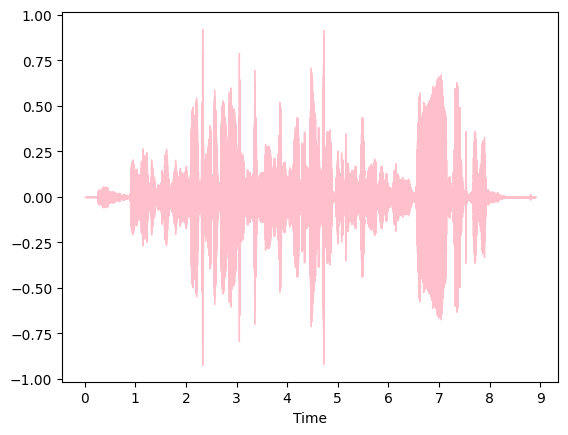

<Figure size 640x480 with 0 Axes>

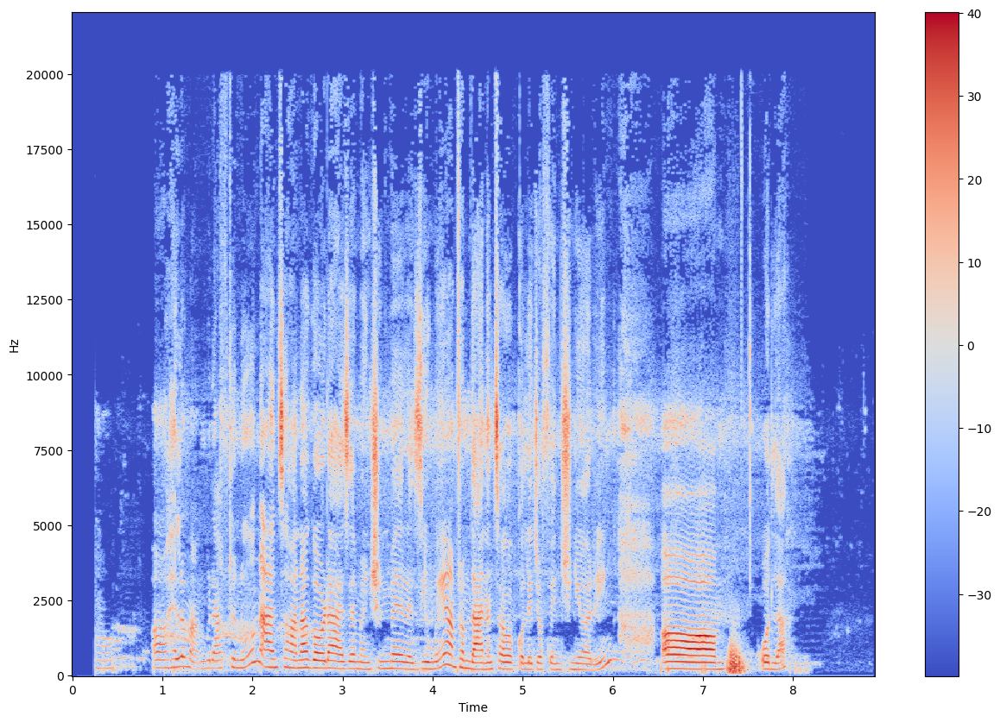

    
Pitch Range: 3991.9575
    
Energy Distributions: [7.93983368e-09 1.23546409e-08 1.67693841e-08 1.76592874e-08
 1.76592252e-08 1.76592252e-08 1.76591364e-08 1.53437461e-04
 1.25894661e-03 2.75888992e-03 4.31201095e-03 6.05197670e-03
 7.68439658e-03 8.86208005e-03 1.00561008e-02 1.05346078e-02
 8.96400306e-03 6.88724453e-03 4.88494802e-03 3.01144179e-03
 2.55343295e-03 2.74969079e-03 2.55389954e-03 2.29765405e-03
 1.82227790e-03 1.33137929e-03 1.10663939e-03 9.23910702e-04
 7.66868761e-04 8.25234980e-04 7.21616729e-04 7.27627194e-04
 8.01832182e-04 4.87111276e-04 2.68174481e-04 2.41231732e-03
 2.02159341e-02 4.24235649e-02 6.23583272e-02 7.42292479e-02
 6.72640055e-02 5.47385700e-02 4.04367894e-02 3.45531069e-02
 3.74668613e-02 5.07455058e-02 7.85677731e-02 1.11530460e-01
 1.17747068e-01 1.44803613e-01 1.28513813e-01 9.18864310e-02
 7.76893422e-02 4.70559932e-02 4.53480445e-02 4.72269021e-02
 4.50735874e-02 2.65830997e-02 1.23979300e-02 1.02270888e-02
 9.53889545e-03 1.34232370e-02

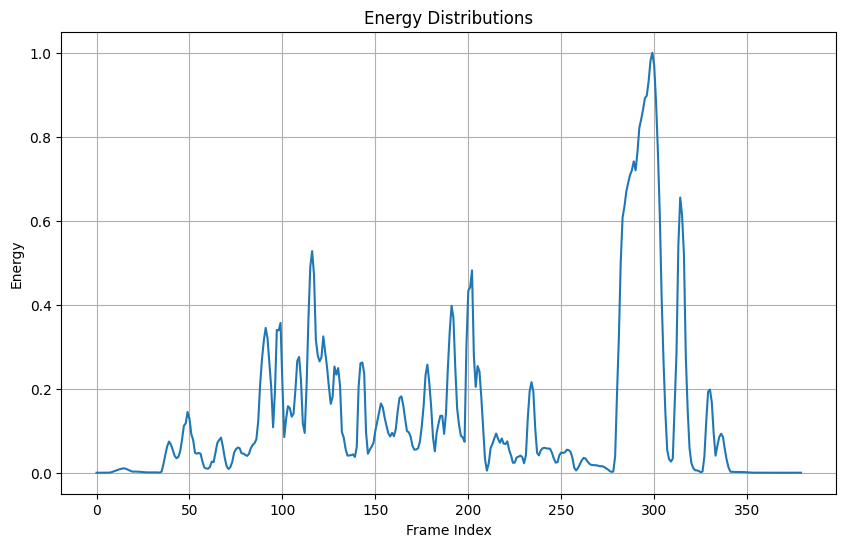

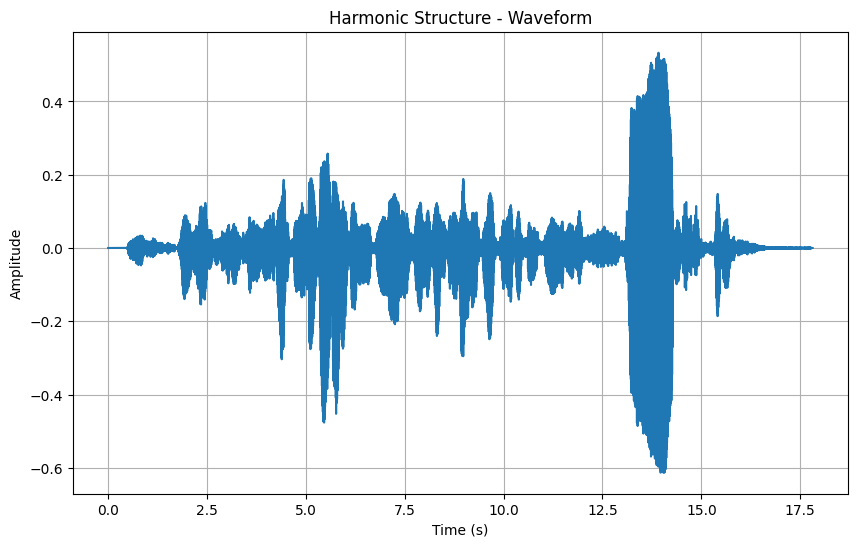

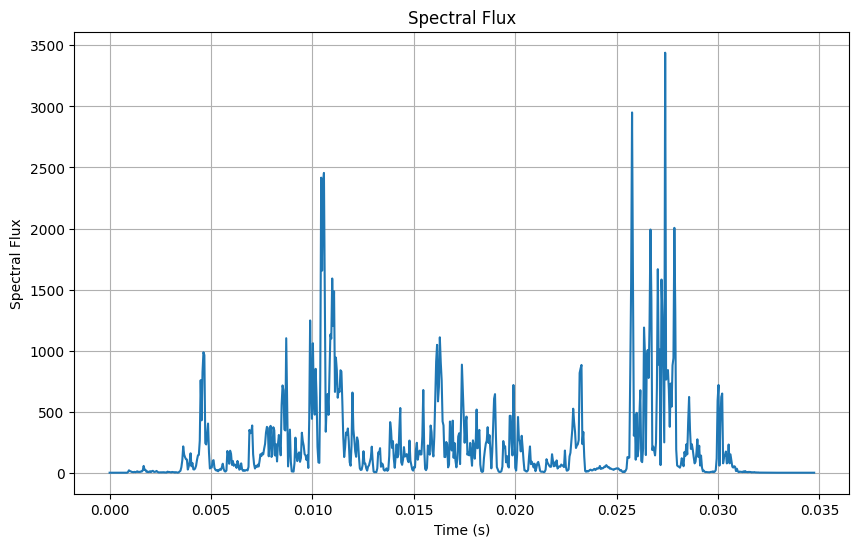

<Figure size 640x480 with 0 Axes>

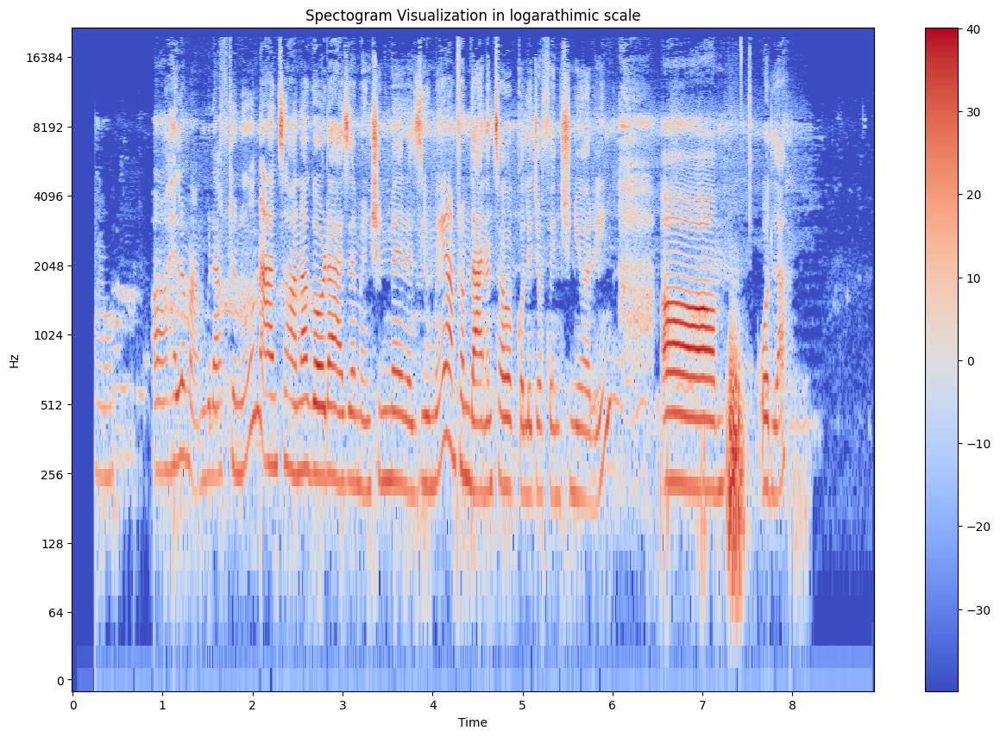

estimated temopo is  90.66611842105263
(9,)


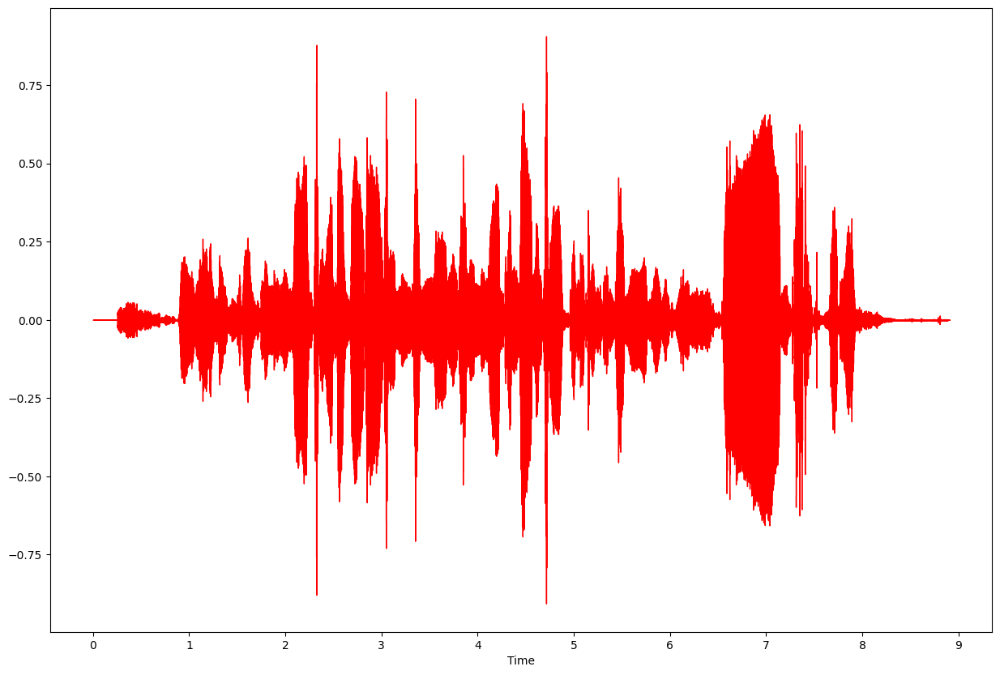

zero crossing ################
Zero Crossings in totla are :  38446


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


frames :   range(0, 384)
Shape of frames to time is  : (384,)
Plotting the Spectral Centroid along with the wave form
The audio wave form is in blue color
The spectral centroid in red color
Shape of Spectral Rolloff (384,)
Shape of frames to time is  : (384,)
Plotting the Spectral Centroid along with the wave form


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


The audio wave form is in blue color
The spectral Rolloff in red color


Enter the number of MFCC to be extracted:  5


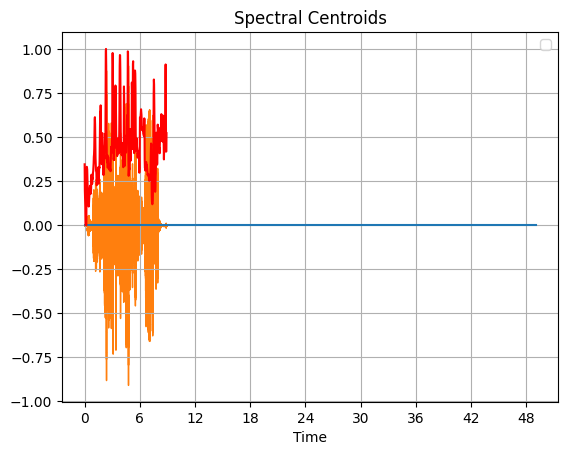

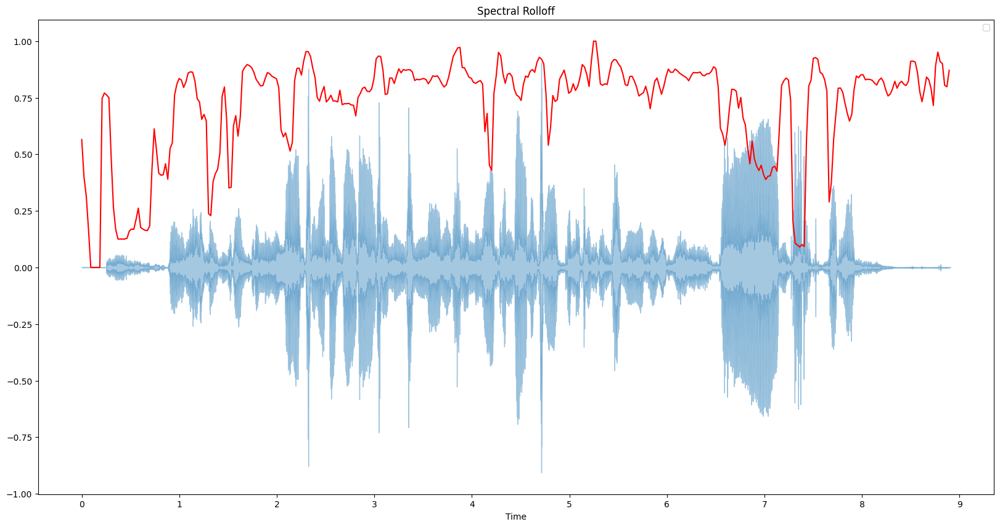

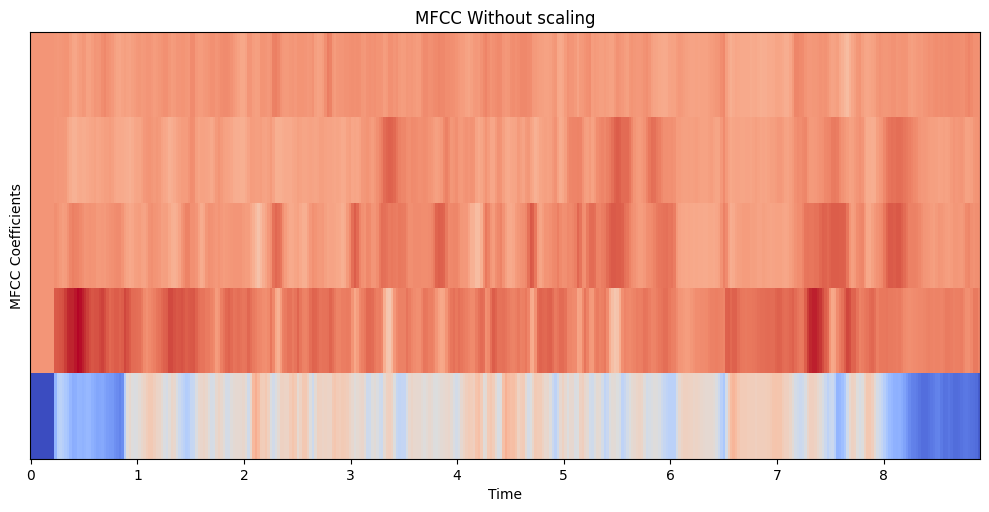

[-9.934108e-09  0.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00]
[1.        0.9999998 1.0000001 1.0000001 1.0000001]


/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


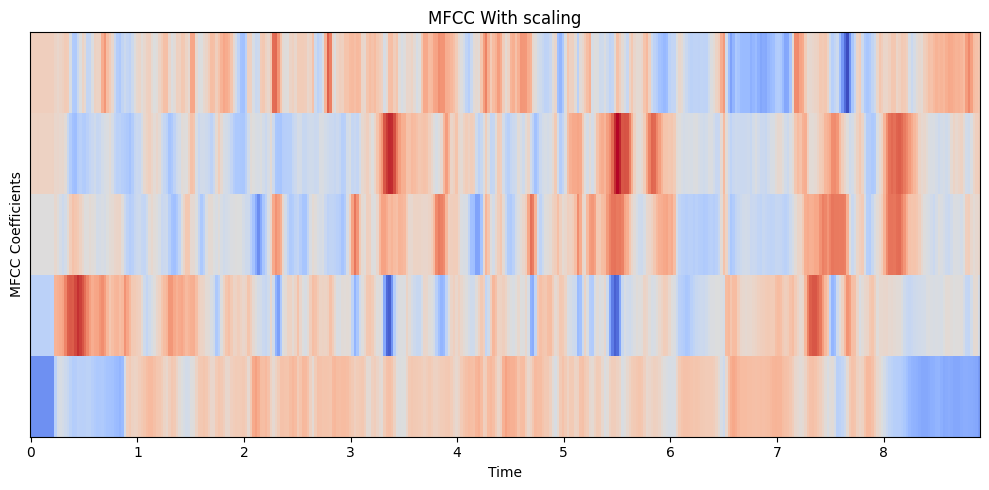



Total MFCC features are: 5 for total 384 frames.


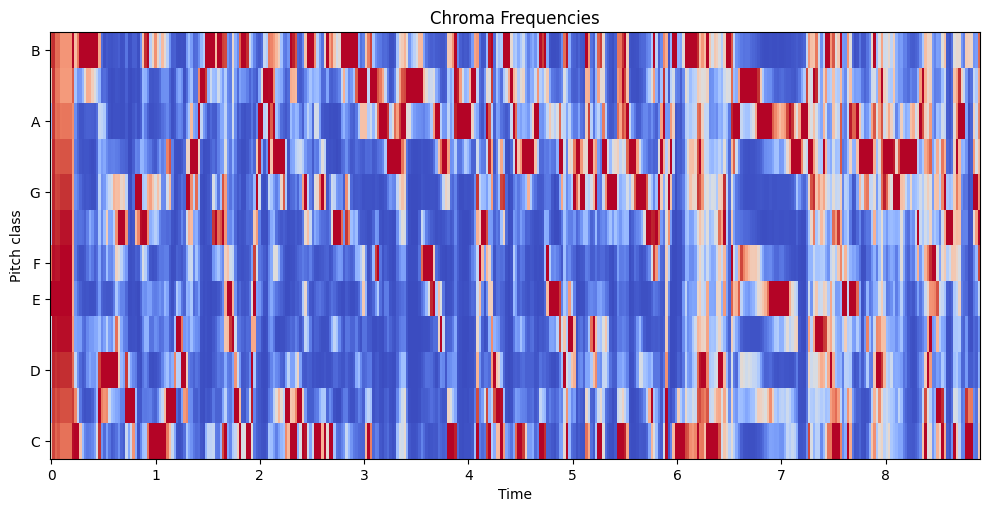

In [112]:
feature_viz(filex)

In [113]:
ipd.Audio(filex)



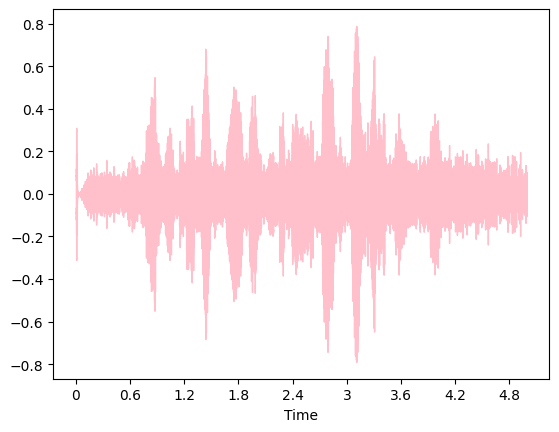

<Figure size 640x480 with 0 Axes>

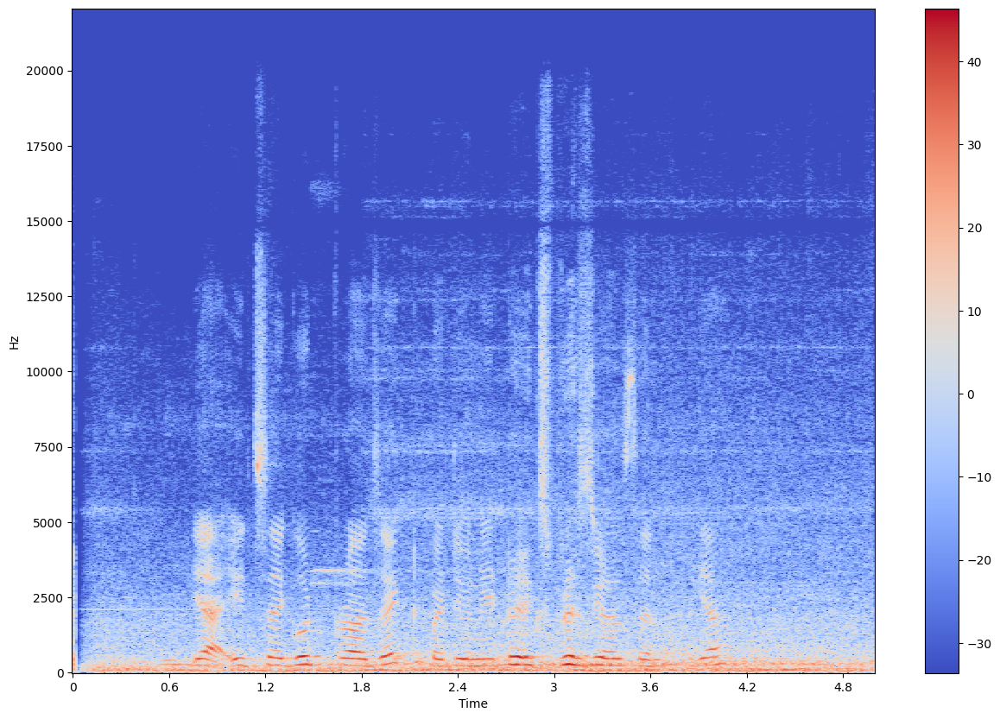

    
Pitch Range: 3419.926
    
Energy Distributions: [0.01674999 0.00269196 0.00581389 0.01026163 0.01262695 0.01896784
 0.02288904 0.02357437 0.02438334 0.02167145 0.01985066 0.02717228
 0.0278196  0.02712615 0.02743972 0.0205707  0.01918944 0.01969655
 0.01810686 0.02002041 0.0203105  0.02063469 0.02863165 0.03340806
 0.04389282 0.04841767 0.04582875 0.03820449 0.03363619 0.03915619
 0.0808888  0.12271607 0.18335205 0.24659988 0.28519058 0.26499754
 0.21651693 0.14962755 0.06684525 0.05841975 0.09773607 0.13598023
 0.16301939 0.15706174 0.10102531 0.0592392  0.0428845  0.04462373
 0.05499459 0.09623296 0.16710234 0.21462058 0.2850394  0.25559962
 0.18633284 0.136063   0.07540095 0.15302502 0.38141185 0.5288853
 0.5665284  0.47848004 0.24551418 0.1035224  0.04851161 0.05299882
 0.05663506 0.04928259 0.05849128 0.10184448 0.16394697 0.26553017
 0.3545633  0.4150946  0.40028504 0.3528529  0.2634525  0.1593622
 0.11299701 0.08631187 0.20081505 0.28615737 0.33750945 0.33265442
 0.2237105

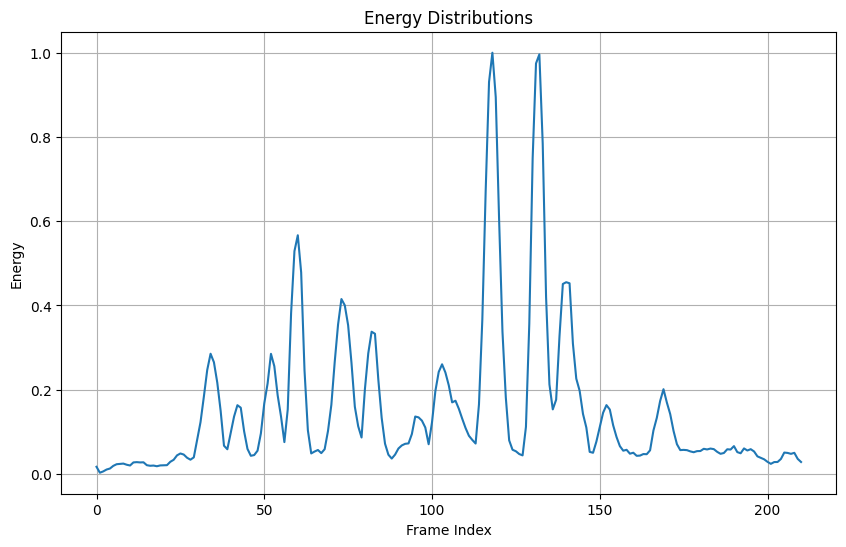

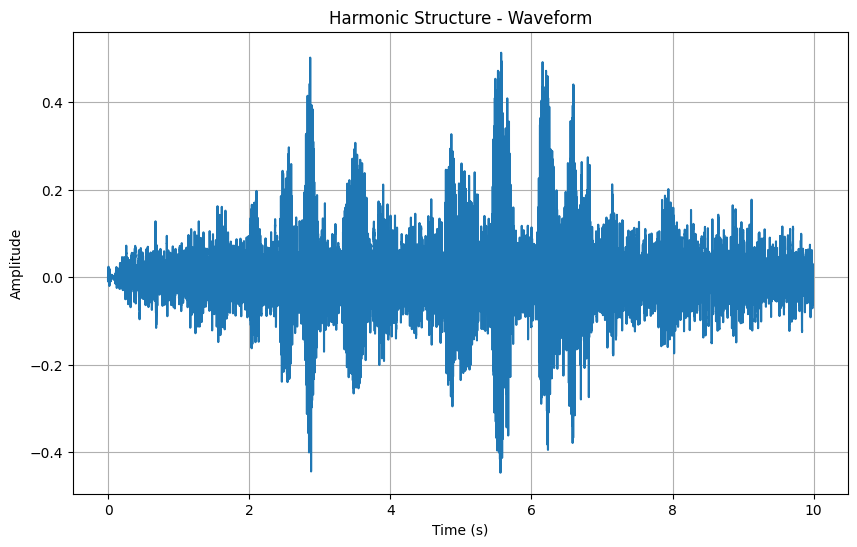

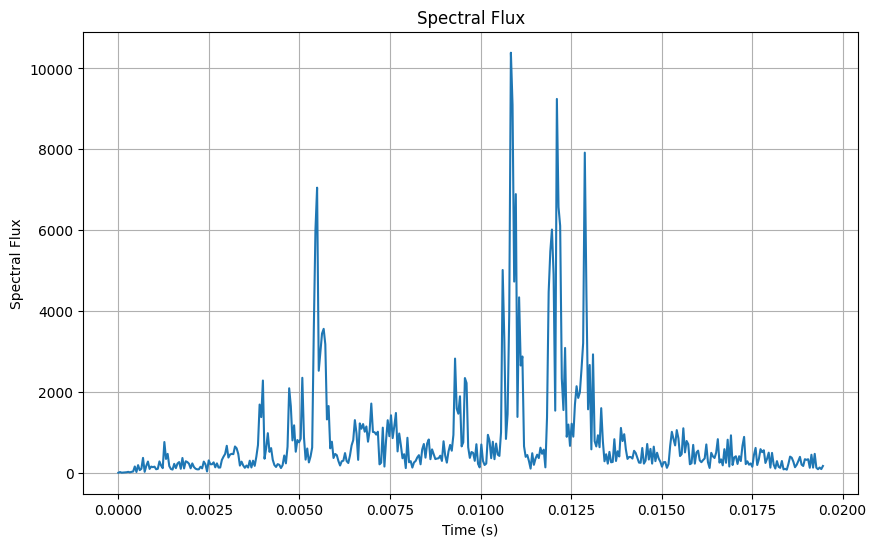

<Figure size 640x480 with 0 Axes>

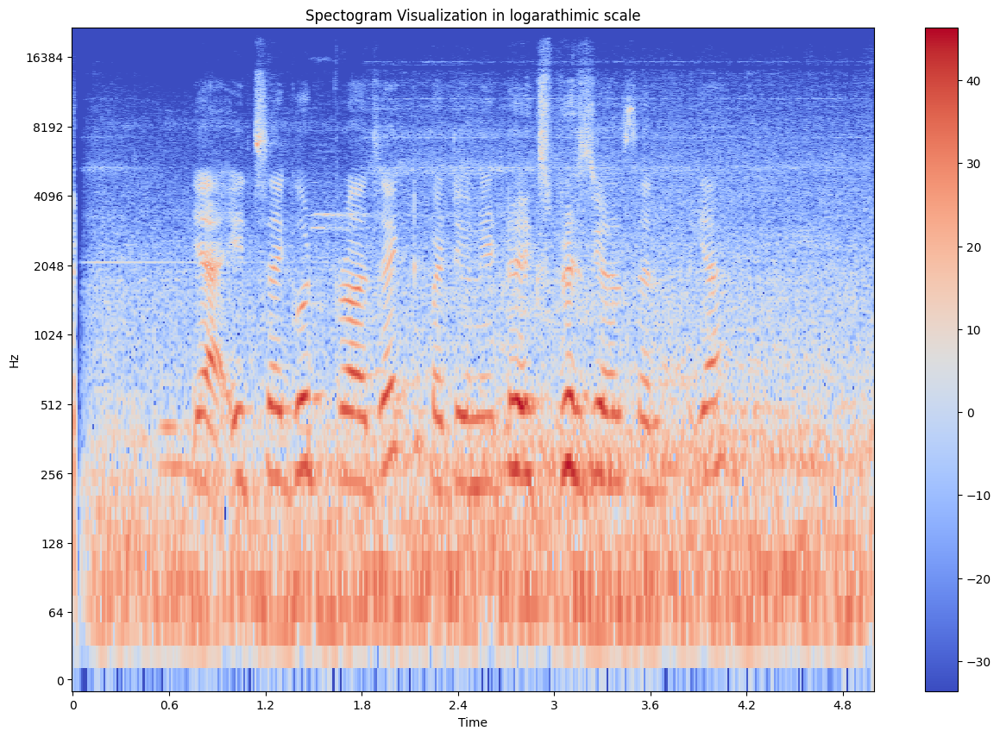

estimated temopo is  92.28515625
(5,)


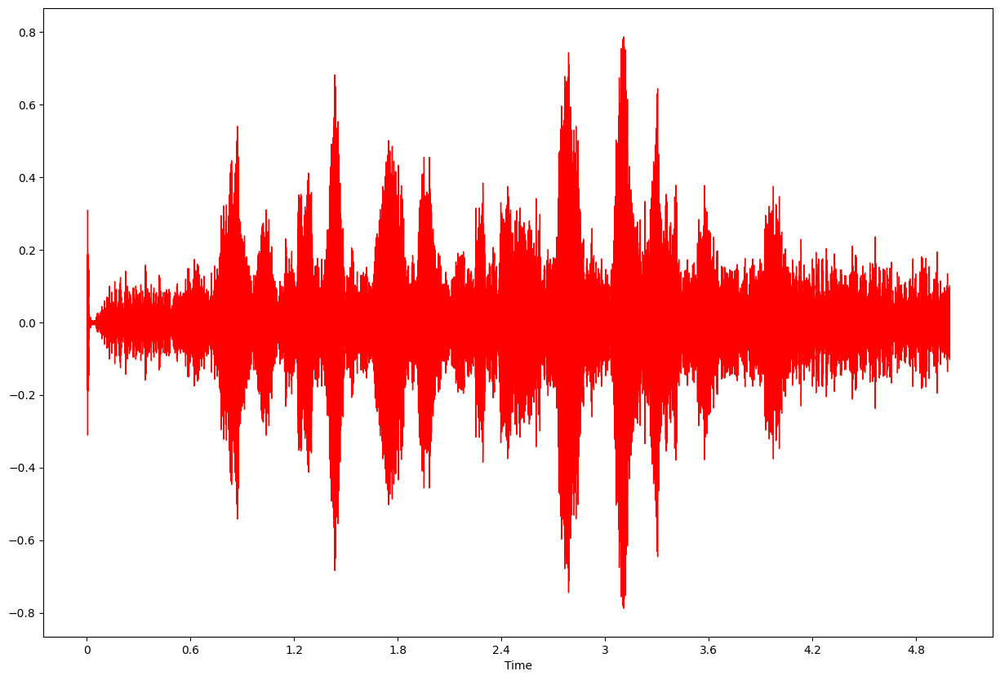

zero crossing ################
Zero Crossings in totla are :  5309
frames :   range(0, 216)
Shape of frames to time is  : (216,)
Plotting the Spectral Centroid along with the wave form


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


The audio wave form is in blue color
The spectral centroid in red color
Shape of Spectral Rolloff (216,)
Shape of frames to time is  : (216,)
Plotting the Spectral Centroid along with the wave form
The audio wave form is in blue color
The spectral Rolloff in red color


Enter the number of MFCC to be extracted:  5


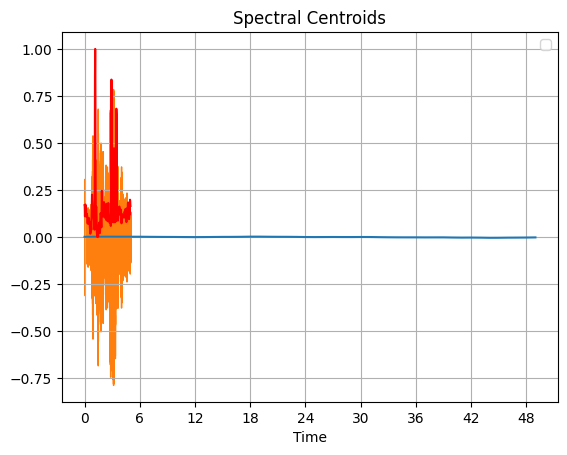

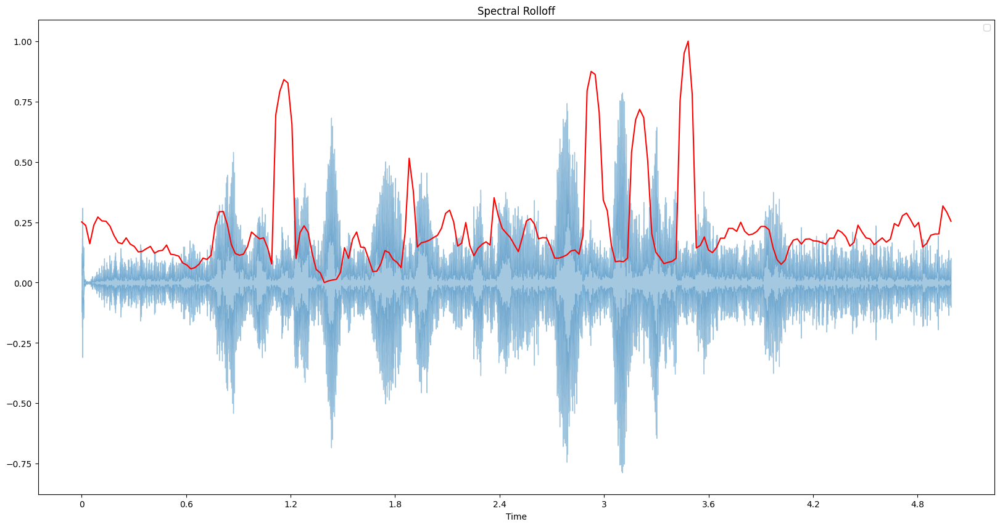

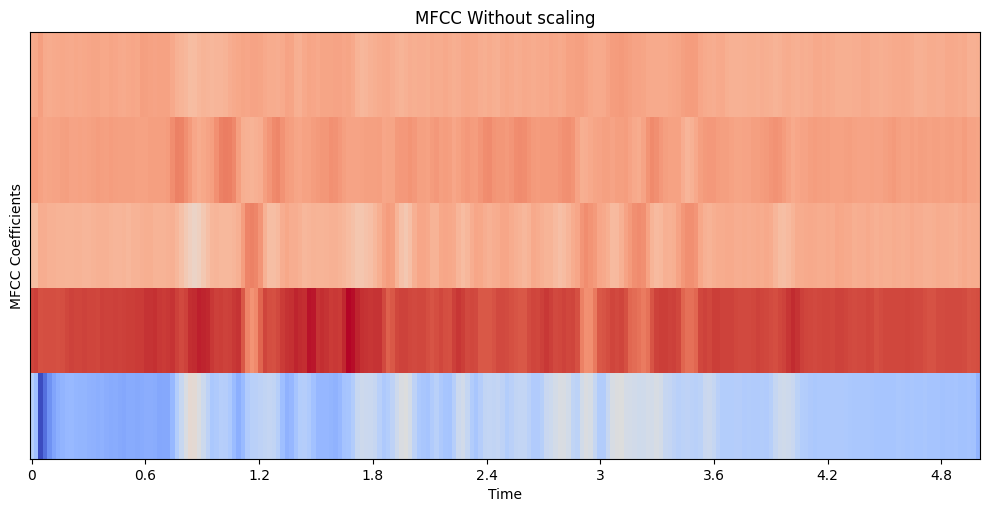

[ 0.0000000e+00  8.8303178e-09  0.0000000e+00 -4.4151589e-09
  1.7660636e-08]
[1.0000001 1.        1.        0.9999999 1.       ]


/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


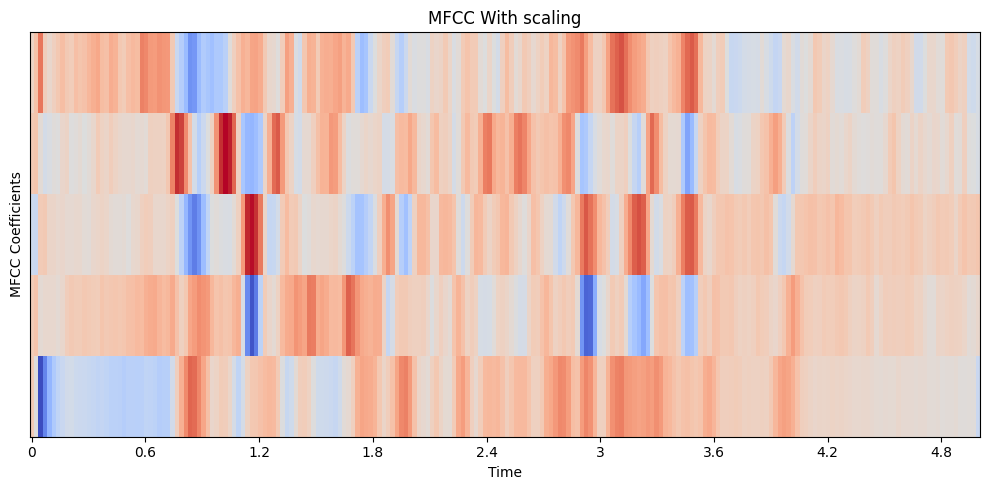



Total MFCC features are: 5 for total 216 frames.


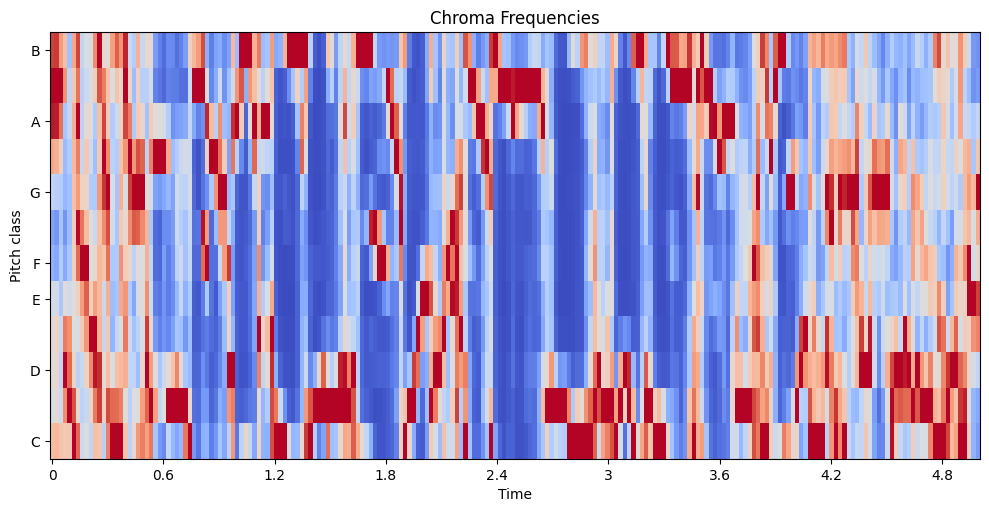

In [107]:
feature_viz('/Users/nanda/Documents/mini_project/recorded_audio_female6.wav')

Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

audios/2023_06_10_15_39_32.mp3


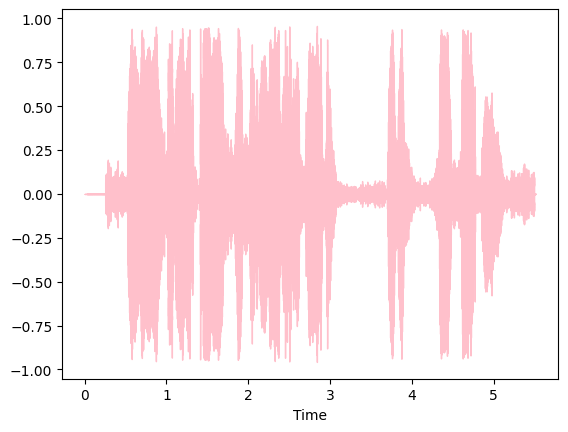

<Figure size 640x480 with 0 Axes>

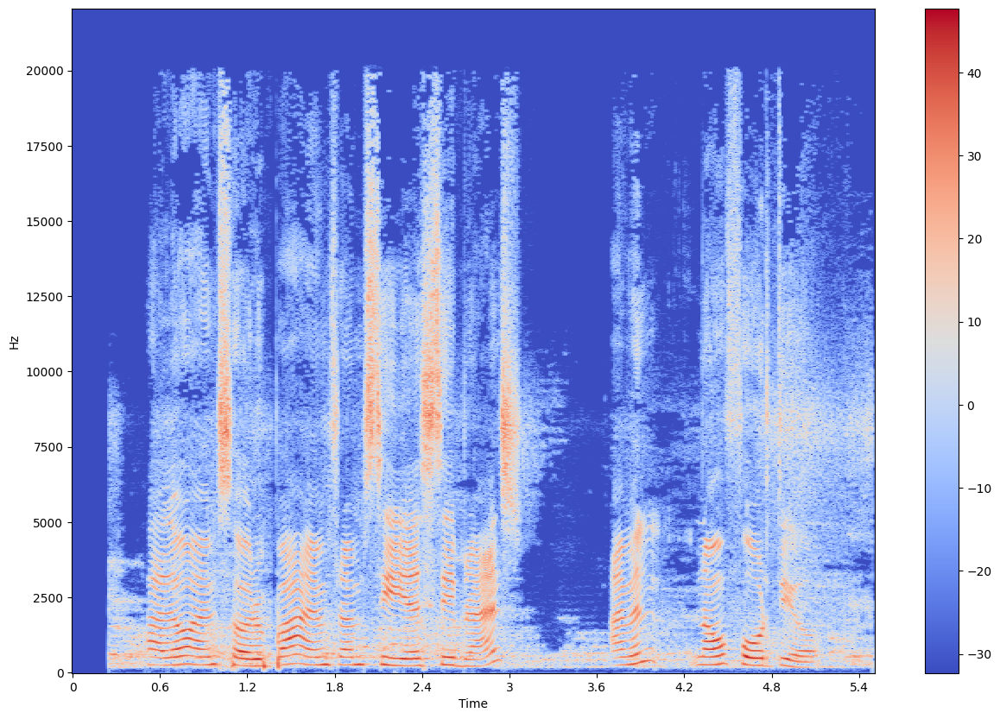

    
Pitch Range: 3988.9822
    


<Figure size 640x480 with 0 Axes>

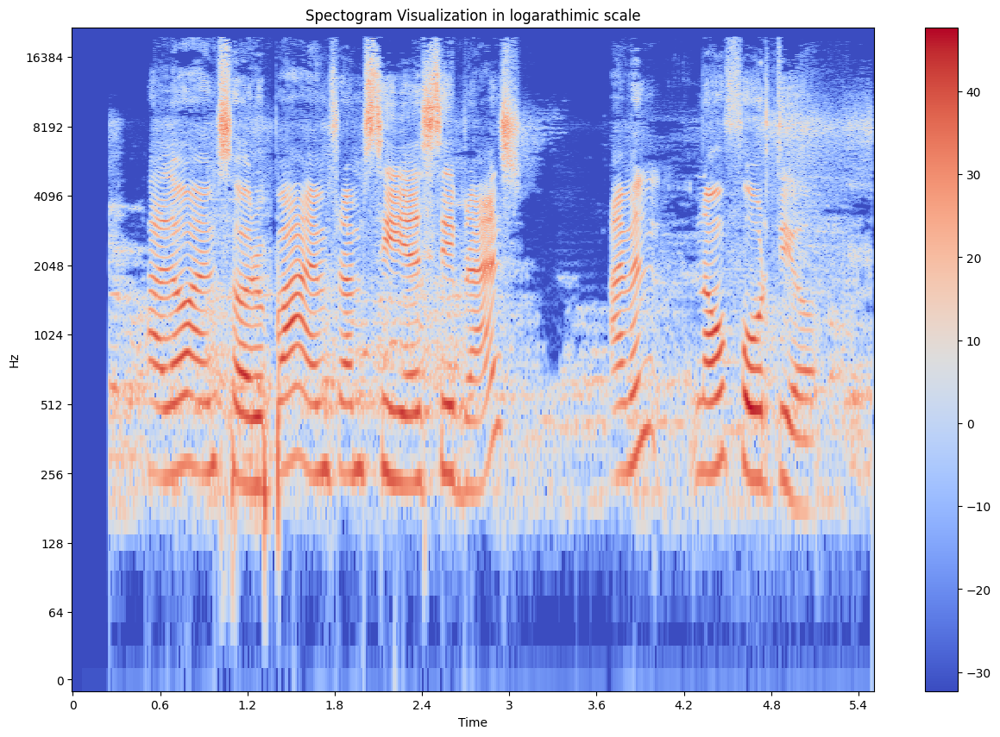

estimated temopo is  95.703125
(8,)


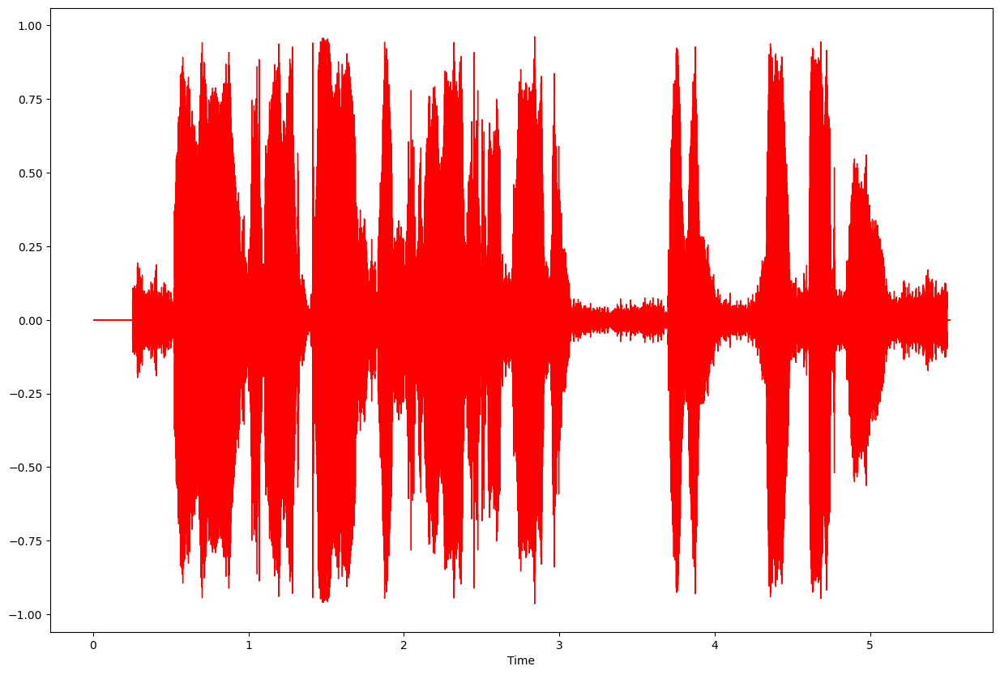

zero crossing ################
Zero Crossings in totla are :  21312
frames :   range(0, 238)
Shape of frames to time is  : (238,)
Plotting the Spectral Centroid along with the wave form


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


The audio wave form is in blue color
The spectral centroid in red color
Shape of Spectral Rolloff (238,)
Shape of frames to time is  : (238,)
Plotting the Spectral Centroid along with the wave form


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


The audio wave form is in blue color
The spectral Rolloff in red color


Enter the number of MFCC to be extracted:  


No input provided. Using default value for num_mfcc.


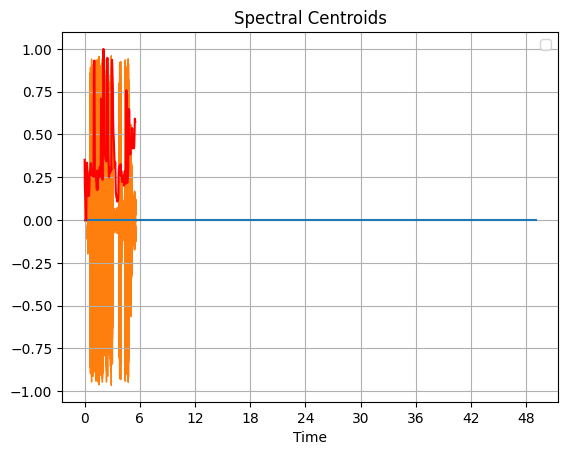

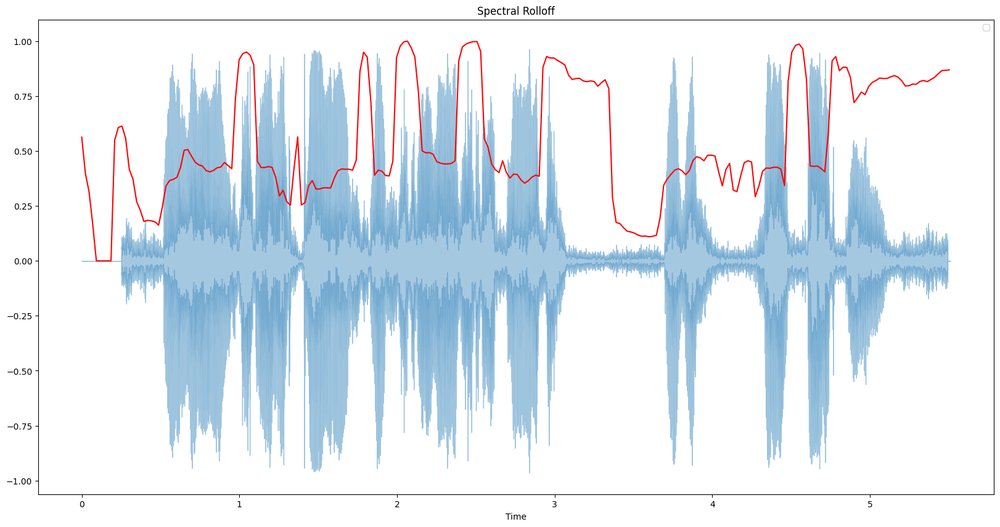

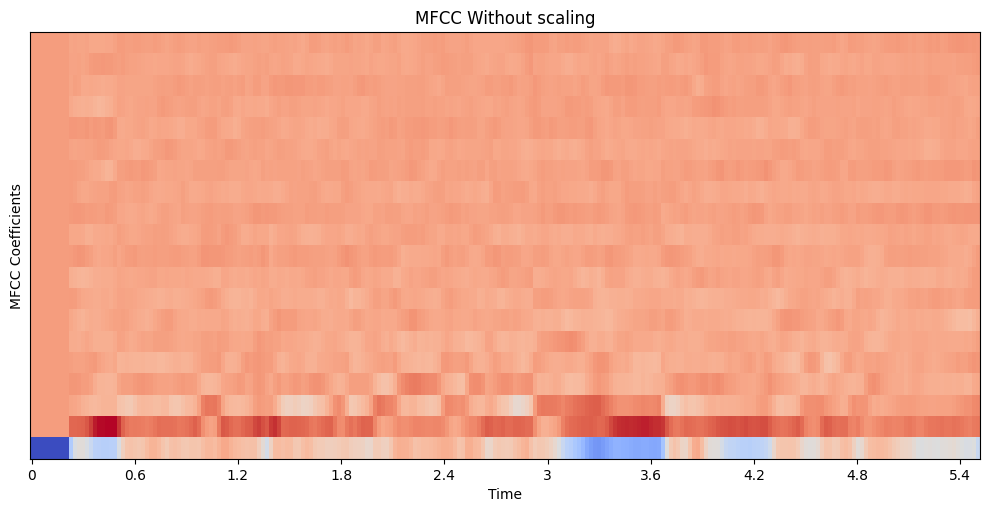

[ 0.0000000e+00  0.0000000e+00  0.0000000e+00  0.0000000e+00
 -2.0035176e-09  1.2021105e-08  0.0000000e+00  0.0000000e+00
  4.0070351e-09  3.2056281e-08  0.0000000e+00  8.0140703e-09
 -8.0140703e-09 -8.0140703e-09  0.0000000e+00 -8.0140703e-09
  8.0140703e-09  4.0070351e-09  4.0070351e-09  1.6028141e-08]
[1.         1.         1.         1.0000001  1.         1.
 1.0000002  0.99999994 0.9999999  0.99999994 1.0000001  1.0000001
 1.         0.9999999  1.0000001  1.0000001  0.9999999  0.9999999
 1.         0.99999994]


/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


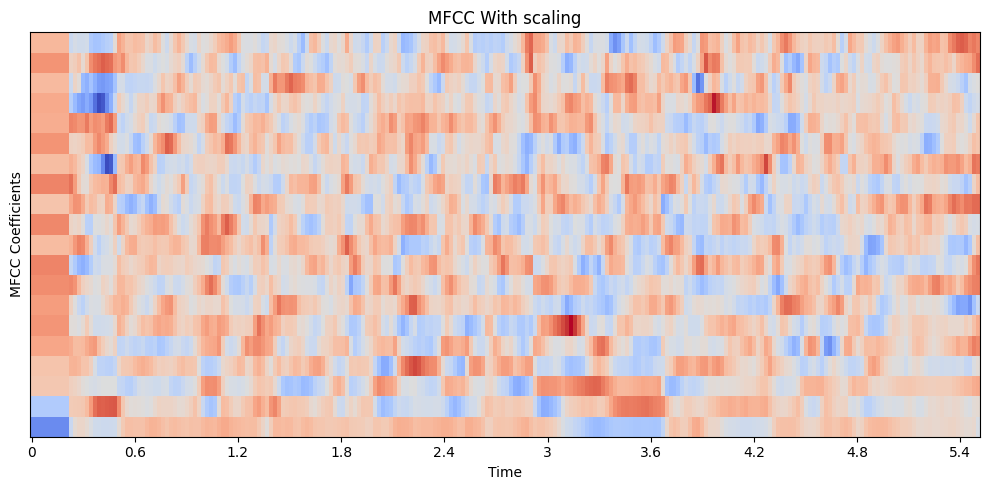



Total MFCC features are: 20 for total 238 frames.


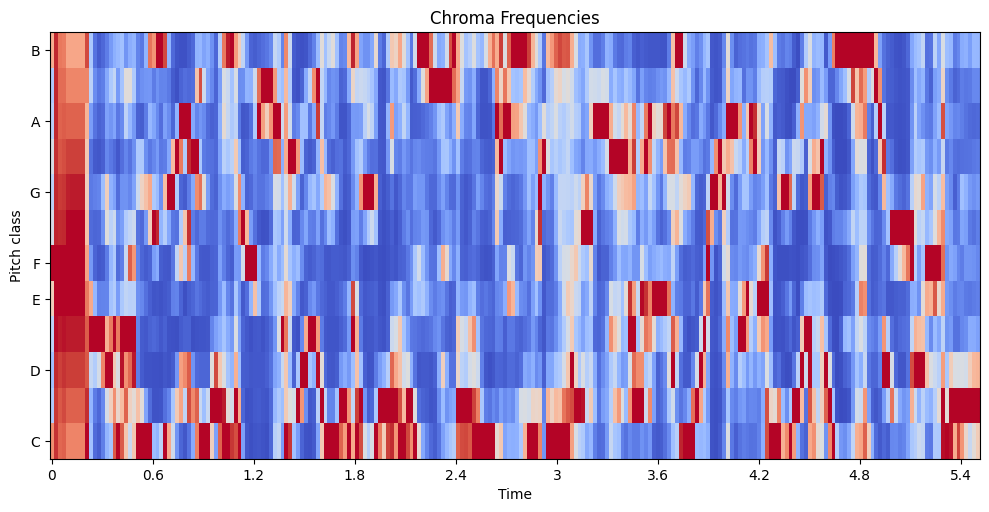

Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

audios/2023_06_10_11_55_27.mp3


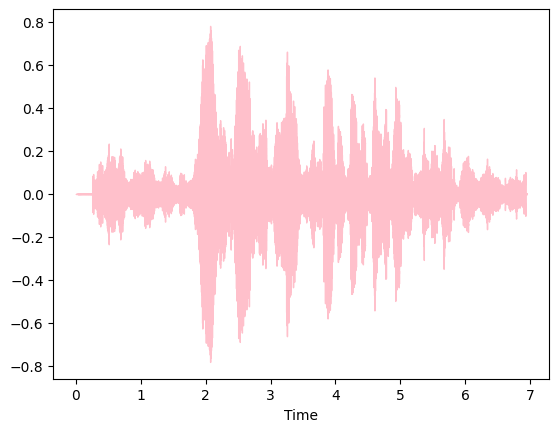

<Figure size 640x480 with 0 Axes>

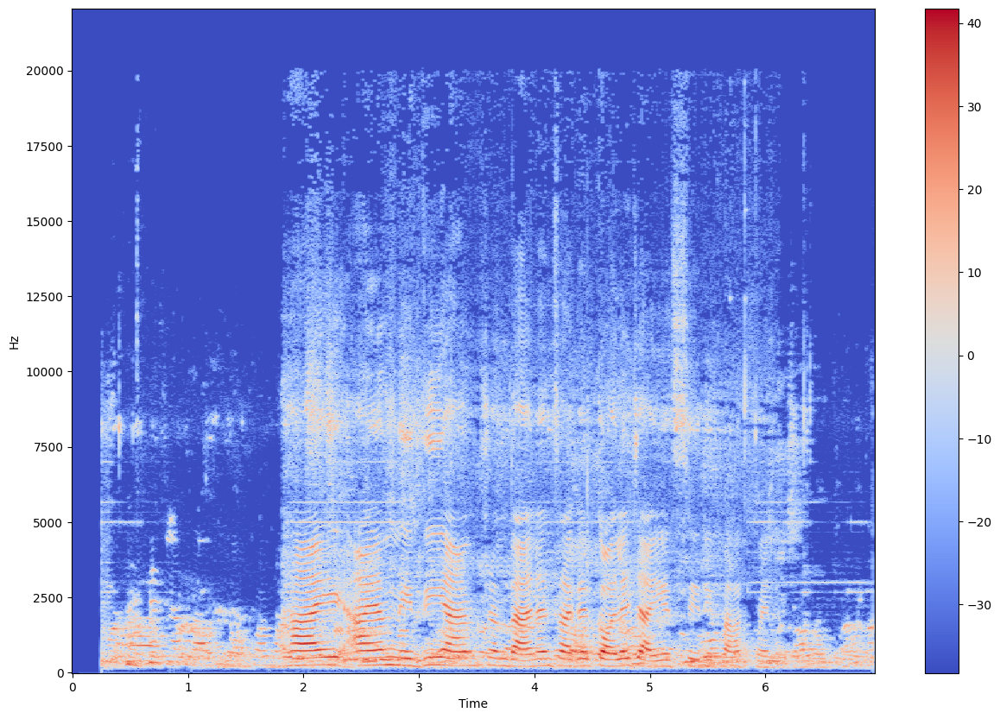

    
Pitch Range: 3991.654
    


<Figure size 640x480 with 0 Axes>

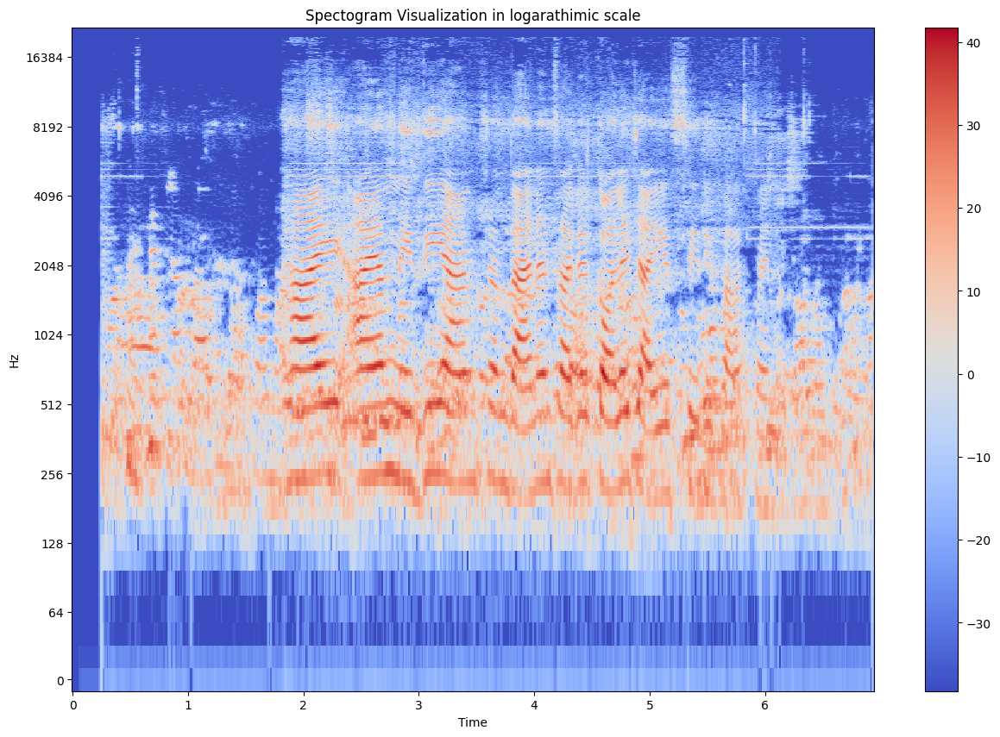

estimated temopo is  161.4990234375
(11,)


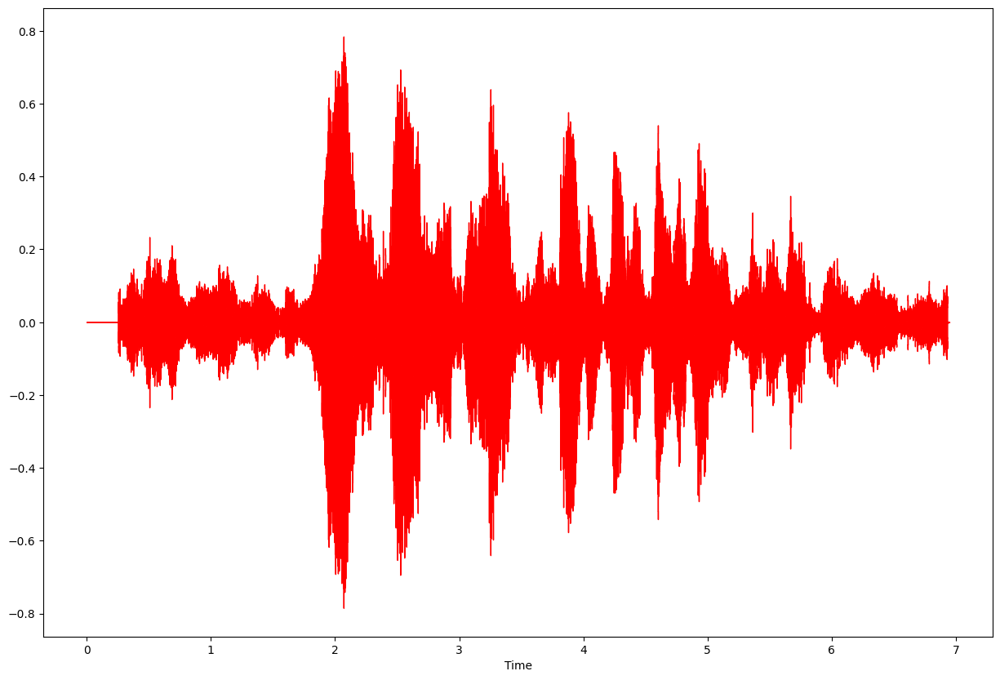

zero crossing ################
Zero Crossings in totla are :  15550


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


frames :   range(0, 300)
Shape of frames to time is  : (300,)
Plotting the Spectral Centroid along with the wave form
The audio wave form is in blue color
The spectral centroid in red color
Shape of Spectral Rolloff (300,)
Shape of frames to time is  : (300,)
Plotting the Spectral Centroid along with the wave form


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


The audio wave form is in blue color
The spectral Rolloff in red color


Enter the number of MFCC to be extracted:  


No input provided. Using default value for num_mfcc.


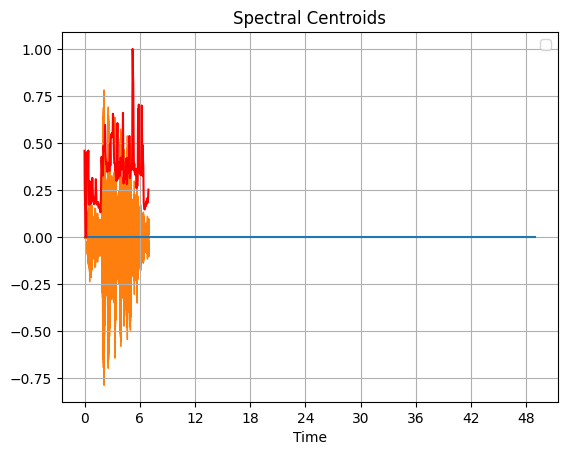

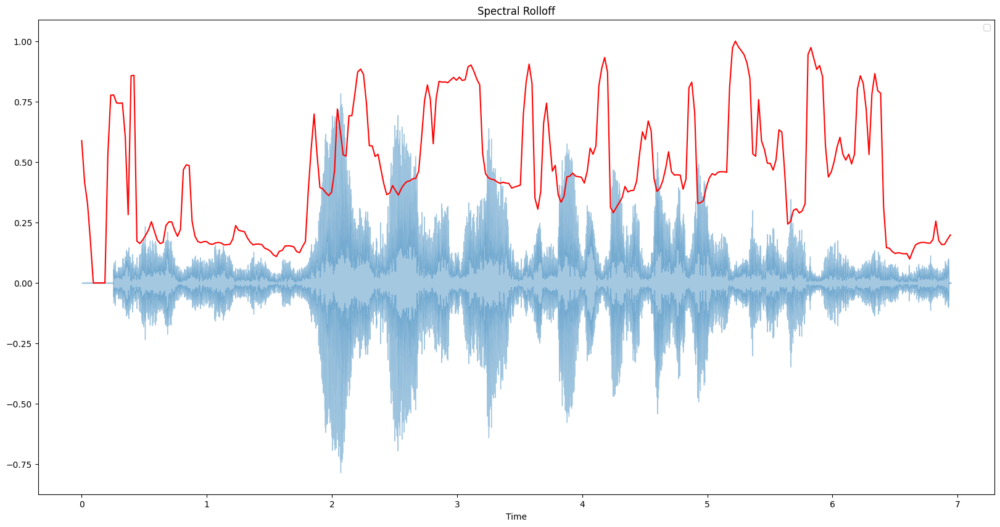

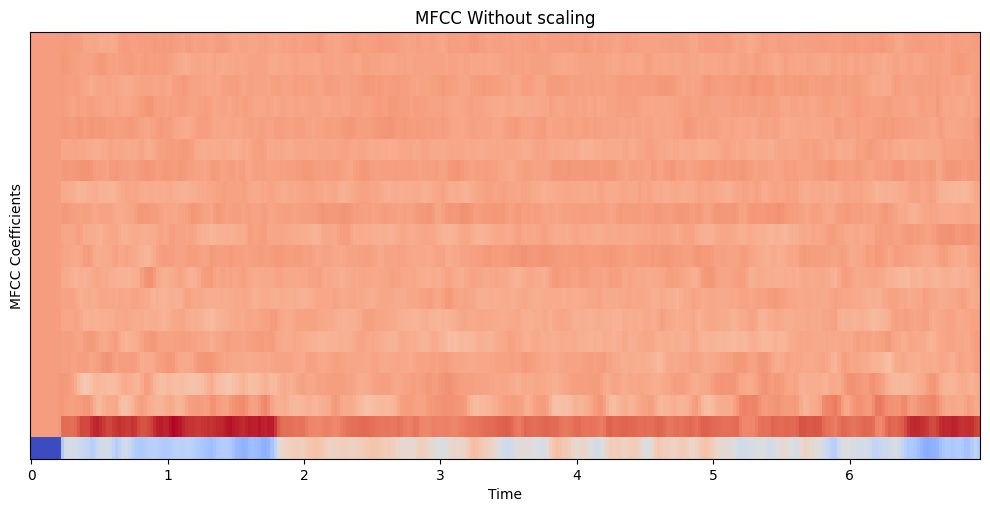

[ 6.3578289e-09 -9.5367430e-09  6.3578289e-09  1.2715658e-08
  2.5431316e-08  1.2715658e-08  6.3578289e-09 -7.9472862e-10
  6.3578289e-09 -1.2715658e-08  1.2715658e-08  0.0000000e+00
 -3.1789145e-09  4.7683715e-09  6.3578289e-09 -1.2715658e-08
  0.0000000e+00  0.0000000e+00 -1.2715658e-08  3.1789145e-09]
[1.0000001 1.        1.        1.        1.        1.        1.
 1.0000002 1.        1.        1.        0.9999998 1.        0.9999998
 1.        1.        1.        1.        0.9999999 1.       ]


/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


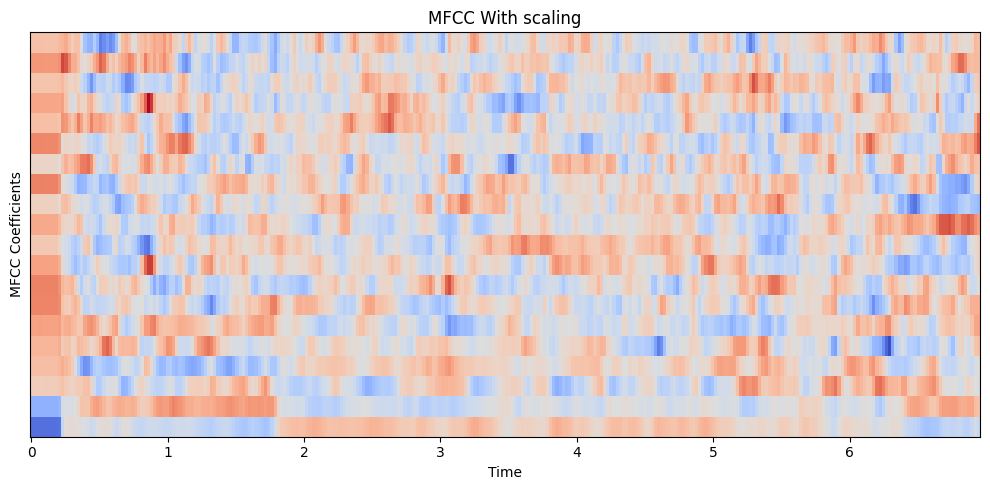



Total MFCC features are: 20 for total 300 frames.


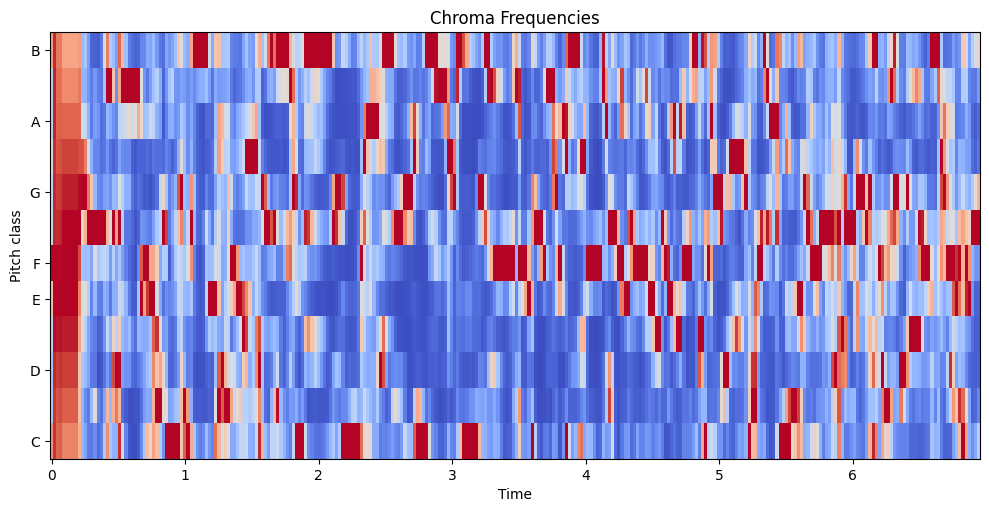

Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

Note: Illegal Audio-MPEG-Header 0x39515177 at offset 124550.
Note: Trying to resync...
Note: Skipped 24 bytes in input.


1/1 [==============================] - 0s 124ms/step
Result: male
Probabilities:     Male: 87.07%    Female: 12.93%

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB



audios/2023_06_10_16_14_23.mp3


Note: Illegal Audio-MPEG-Header 0x39515177 at offset 124550.
Note: Trying to resync...
Note: Skipped 24 bytes in input.
Note: Illegal Audio-MPEG-Header 0x39515177 at offset 124550.
Note: Trying to resync...
Note: Skipped 24 bytes in input.


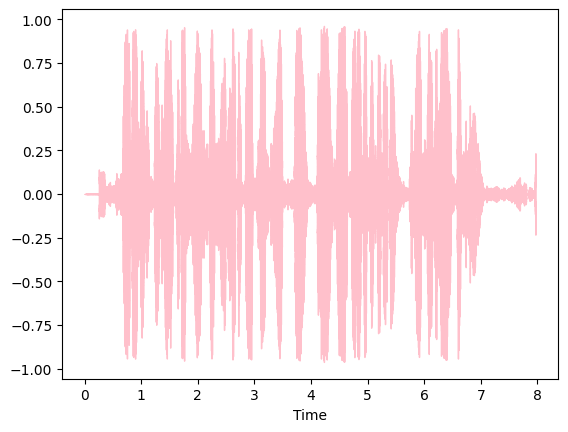

<Figure size 640x480 with 0 Axes>

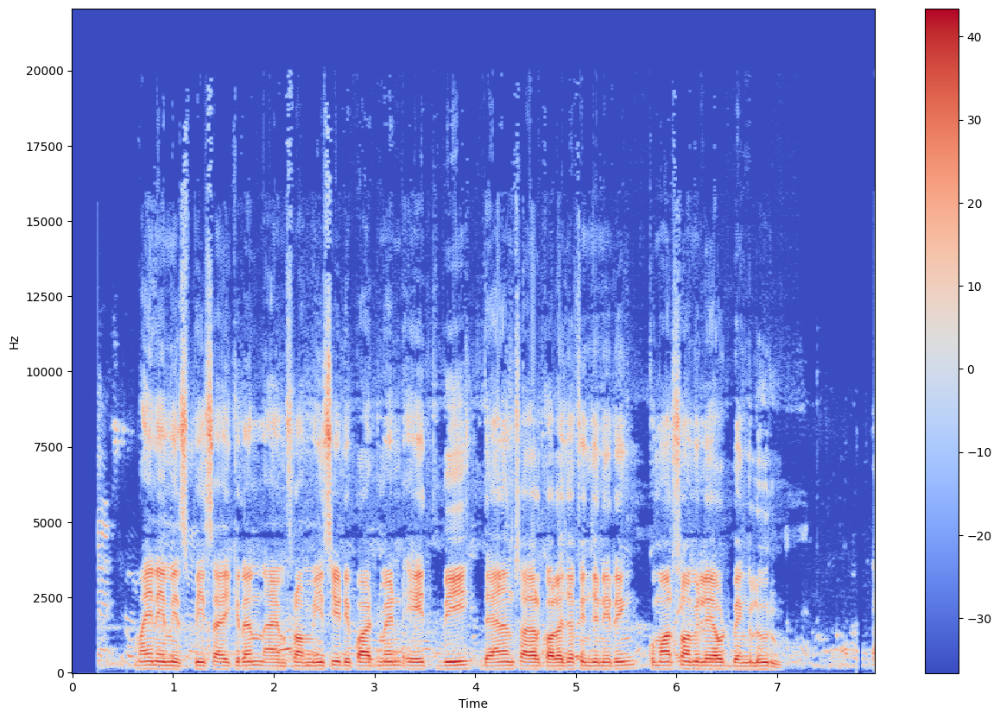

    
Pitch Range: 3989.2883
    


<Figure size 640x480 with 0 Axes>

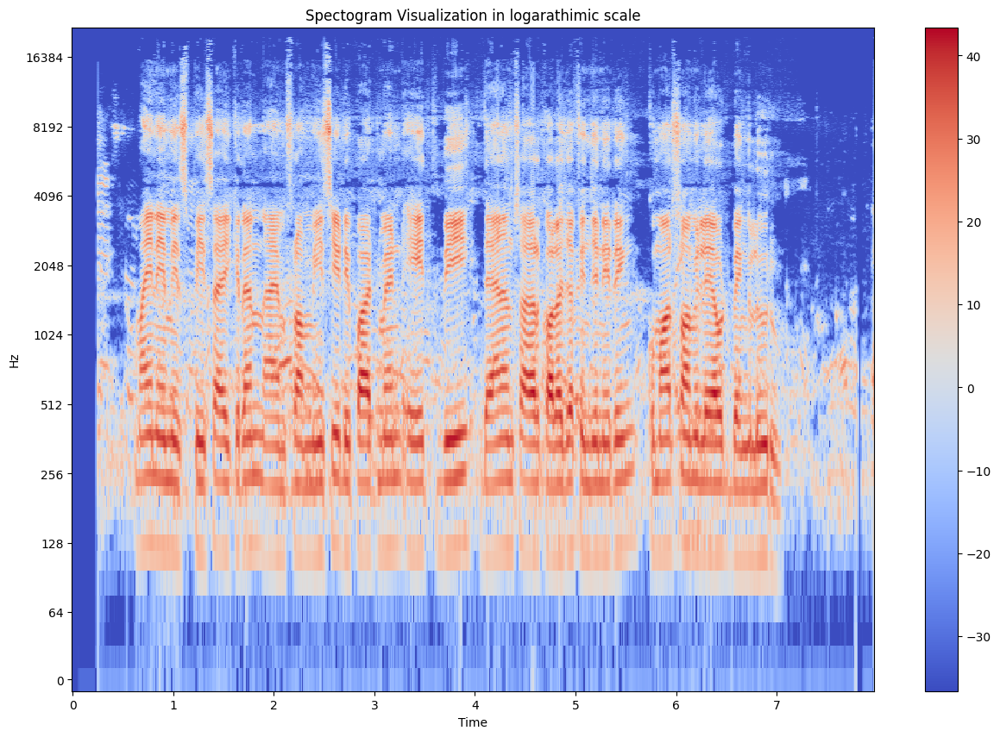

estimated temopo is  135.99917763157896
(16,)


Note: Illegal Audio-MPEG-Header 0x39515177 at offset 124550.
Note: Trying to resync...
Note: Skipped 24 bytes in input.


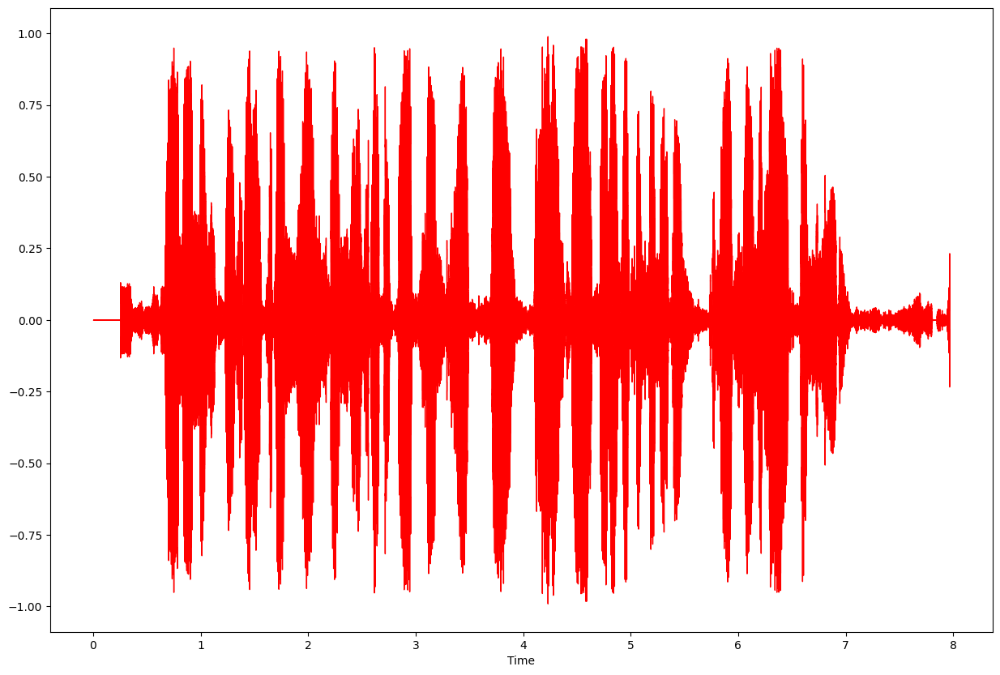

zero crossing ################


Note: Illegal Audio-MPEG-Header 0x39515177 at offset 124550.
Note: Trying to resync...
Note: Skipped 24 bytes in input.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Zero Crossings in totla are :  22110
frames :   range(0, 344)
Shape of frames to time is  : (344,)
Plotting the Spectral Centroid along with the wave form
The audio wave form is in blue color
The spectral centroid in red color
Shape of Spectral Rolloff (344,)
Shape of frames to time is  : (344,)
Plotting the Spectral Centroid along with the wave form


Note: Illegal Audio-MPEG-Header 0x39515177 at offset 124550.
Note: Trying to resync...
Note: Skipped 24 bytes in input.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
Note: Illegal Audio-MPEG-Header 0x39515177 at offset 124550.
Note: Trying to resync...
Note: Skipped 24 bytes in input.


The audio wave form is in blue color
The spectral Rolloff in red color


Enter the number of MFCC to be extracted:  


No input provided. Using default value for num_mfcc.


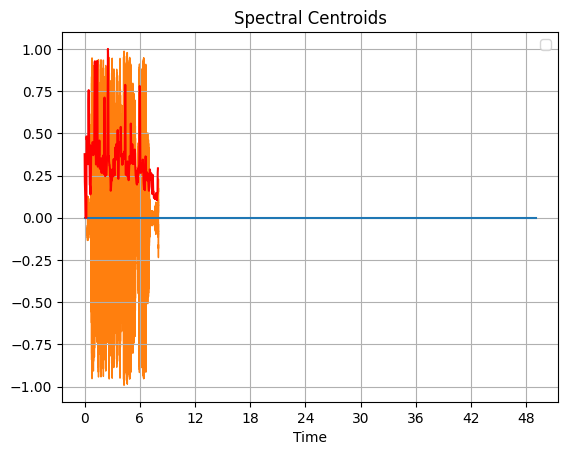

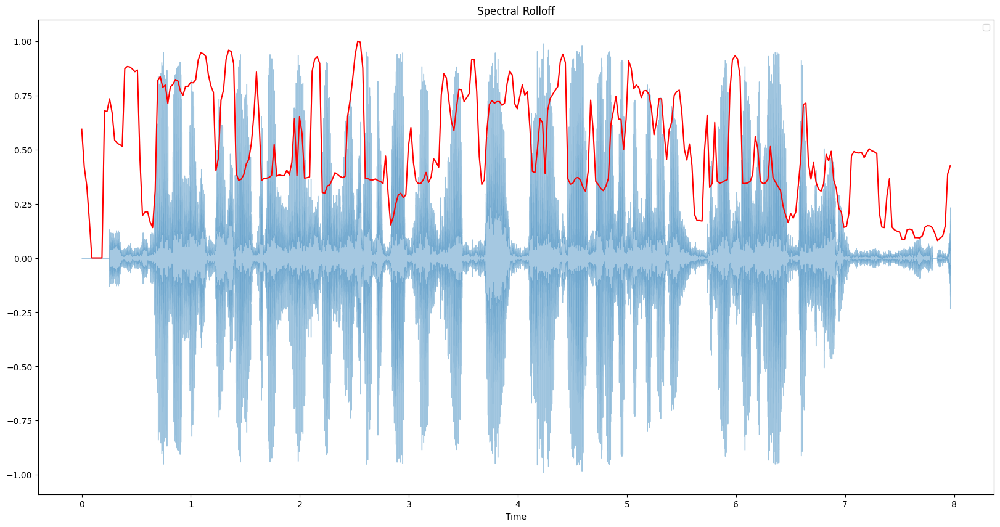

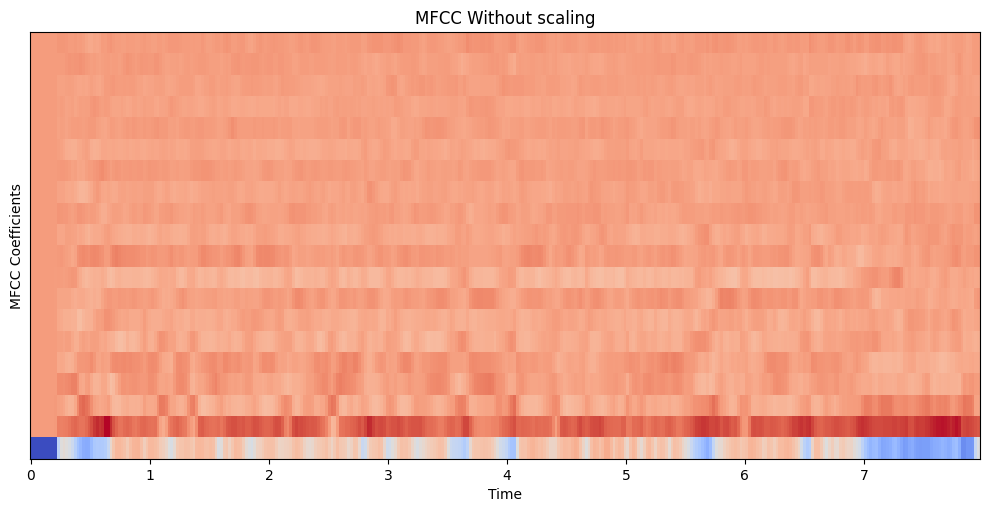

[-5.5446181e-09 -1.1089236e-08  0.0000000e+00 -1.1089236e-08
 -1.1089236e-08  0.0000000e+00  8.3169276e-09  0.0000000e+00
  1.1089236e-08  0.0000000e+00  1.1089236e-08  8.3169276e-09
  0.0000000e+00  1.1089236e-08  1.1089236e-08  1.1089236e-08
  6.9307728e-09  1.1089236e-08  1.1089236e-08  5.5446181e-09]
[1.0000001  1.         1.         1.         1.0000001  1.
 0.9999998  1.         1.         0.99999994 1.         1.
 1.         0.99999994 1.         1.         0.9999998  1.
 0.99999994 1.        ]


/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


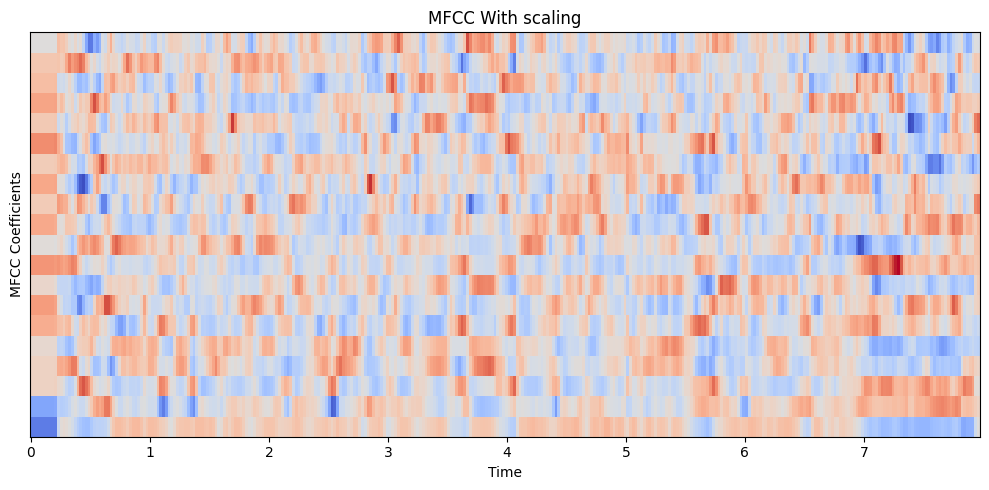

Note: Illegal Audio-MPEG-Header 0x39515177 at offset 124550.
Note: Trying to resync...
Note: Skipped 24 bytes in input.




Total MFCC features are: 20 for total 344 frames.


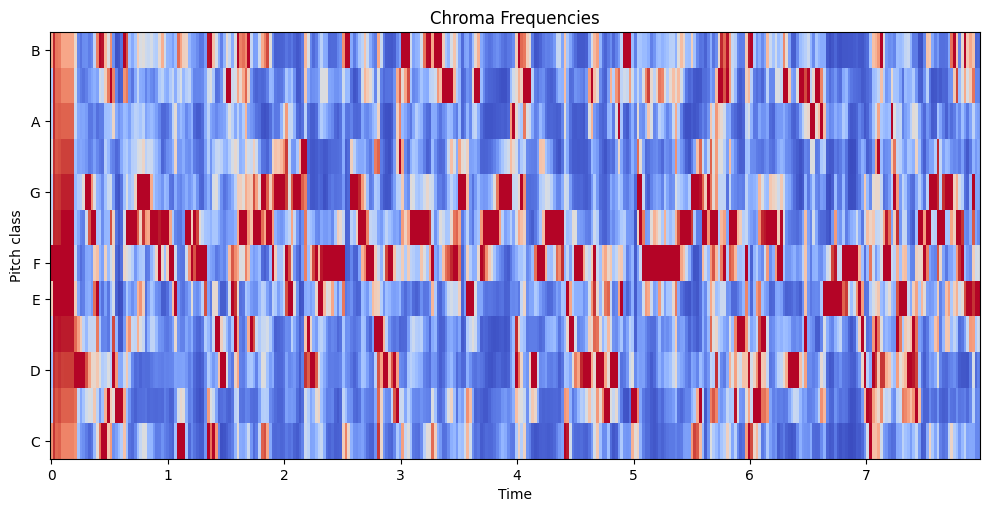

Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

audios/2023_06_10_15_29_22.mp3


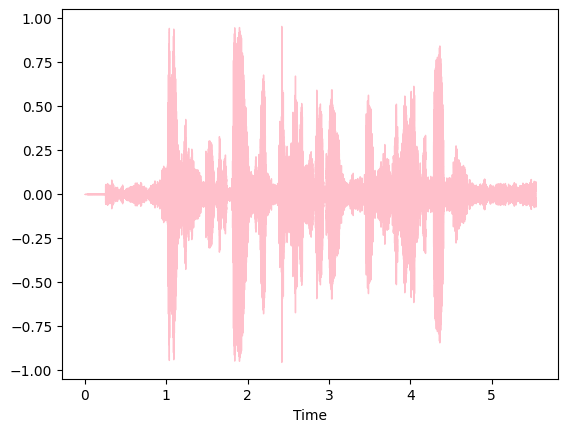

<Figure size 640x480 with 0 Axes>

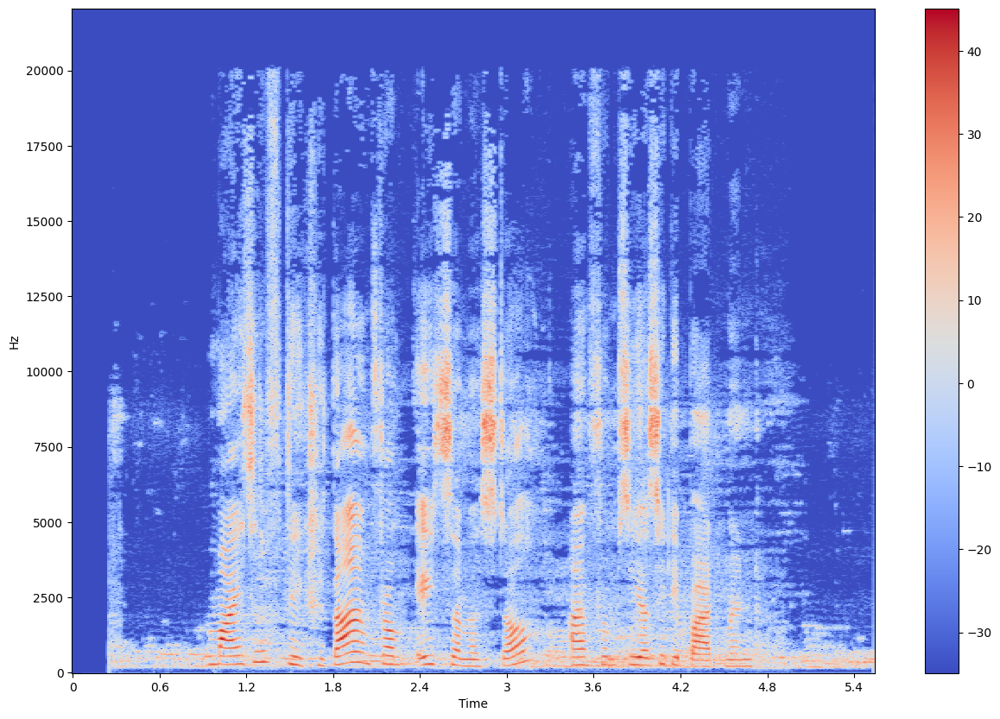

    
Pitch Range: 3992.2136
    


<Figure size 640x480 with 0 Axes>

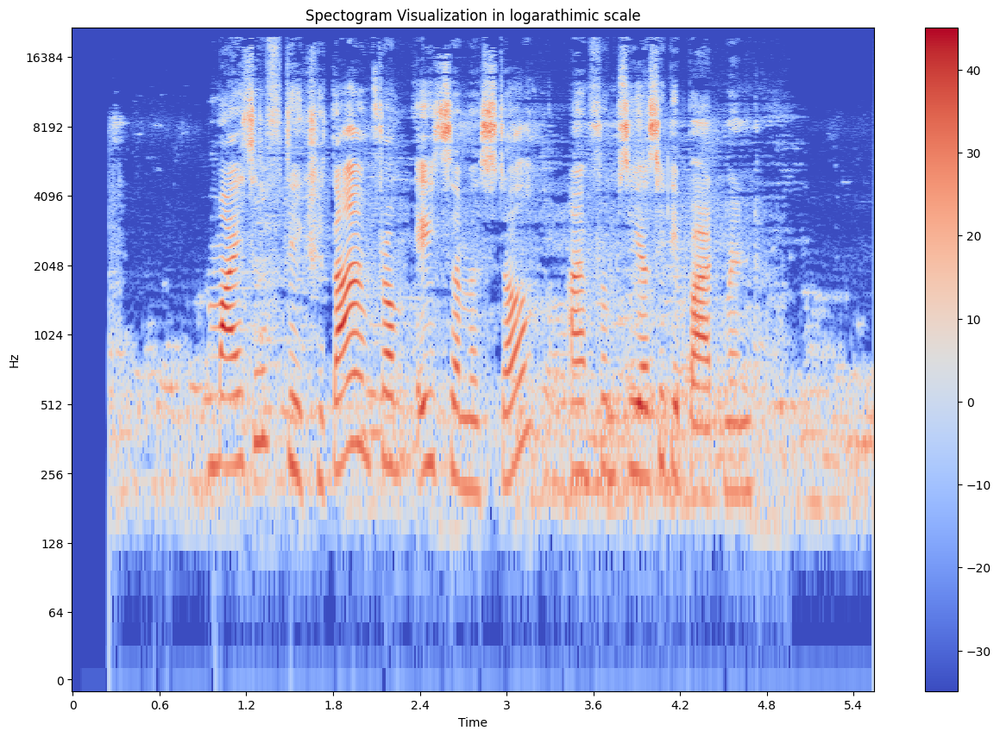

estimated temopo is  103.359375
(7,)


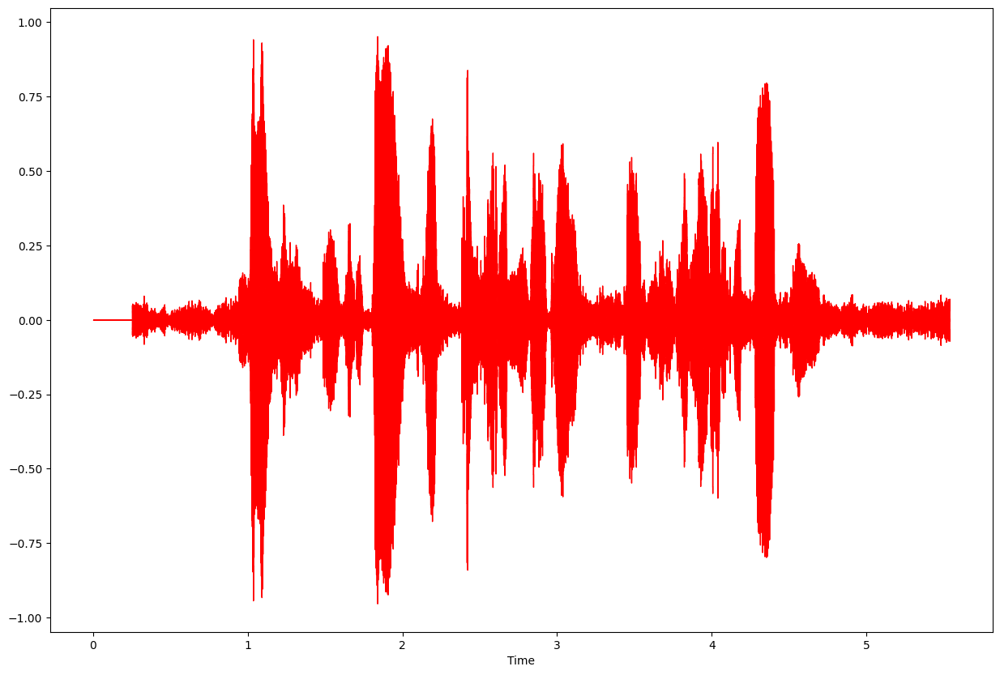

zero crossing ################
Zero Crossings in totla are :  19728
frames :   range(0, 239)
Shape of frames to time is  : (239,)
Plotting the Spectral Centroid along with the wave form


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


The audio wave form is in blue color
The spectral centroid in red color
Shape of Spectral Rolloff (239,)
Shape of frames to time is  : (239,)
Plotting the Spectral Centroid along with the wave form
The audio wave form is in blue color
The spectral Rolloff in red color


Enter the number of MFCC to be extracted:  


No input provided. Using default value for num_mfcc.


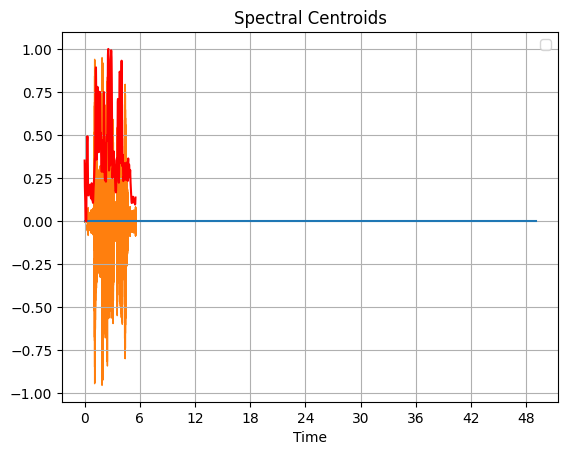

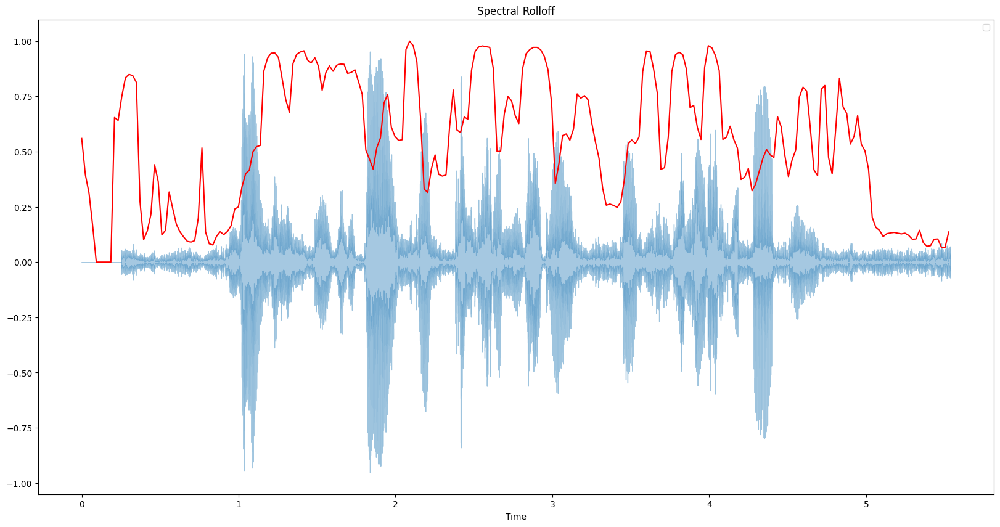

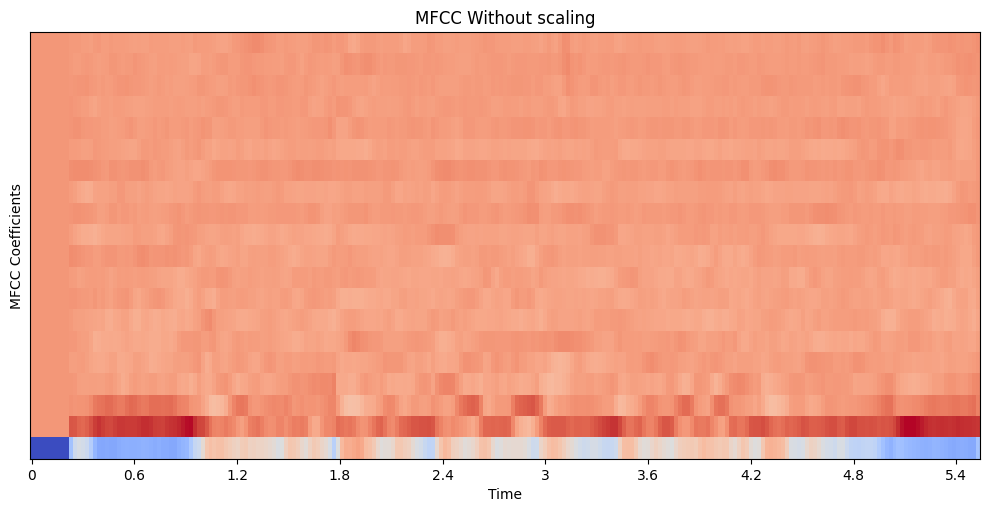

[-7.98053801e-09  0.00000000e+00 -7.48175466e-10  0.00000000e+00
  1.19708075e-08 -7.98053801e-09  0.00000000e+00 -7.98053801e-09
  1.59610760e-08  0.00000000e+00  4.98783637e-09  3.99026900e-09
 -2.39416149e-08  0.00000000e+00  7.98053801e-09  0.00000000e+00
  0.00000000e+00  1.19708075e-08 -7.98053801e-09  4.98783637e-09]
[0.99999994 0.9999998  0.9999998  1.0000001  1.0000001  1.
 1.         1.         0.99999994 1.0000001  1.0000001  1.
 1.0000001  1.         1.0000001  1.         1.0000001  1.0000001
 1.         1.0000001 ]


/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


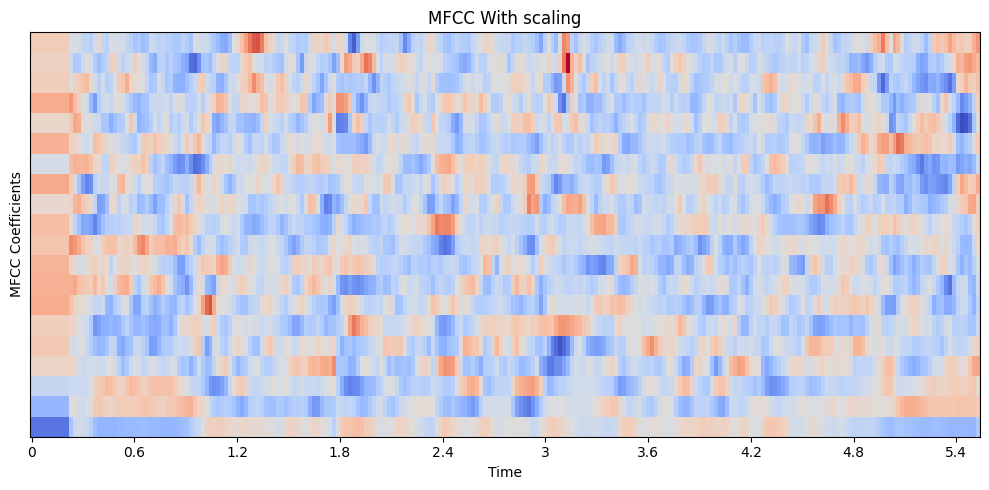



Total MFCC features are: 20 for total 239 frames.


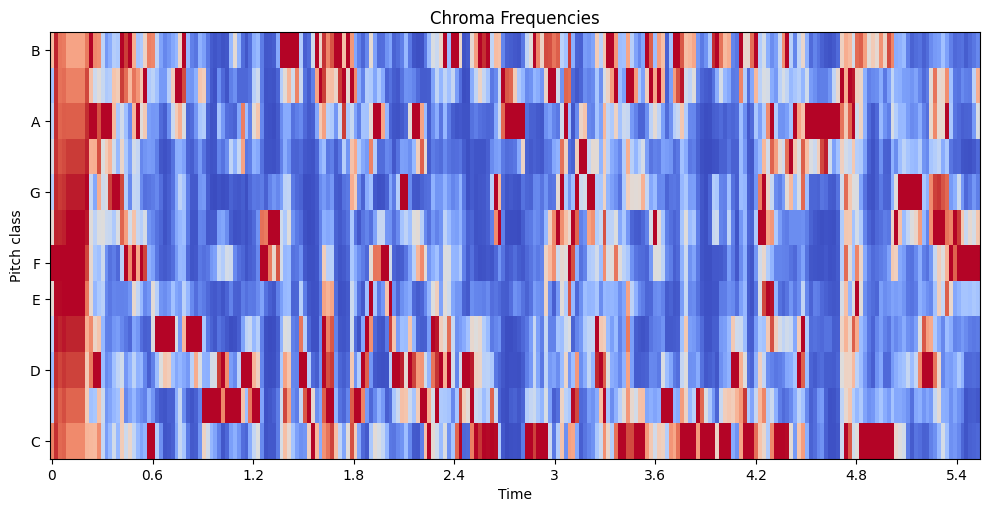

Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

audios/2023_06_10_11_59_30.mp3


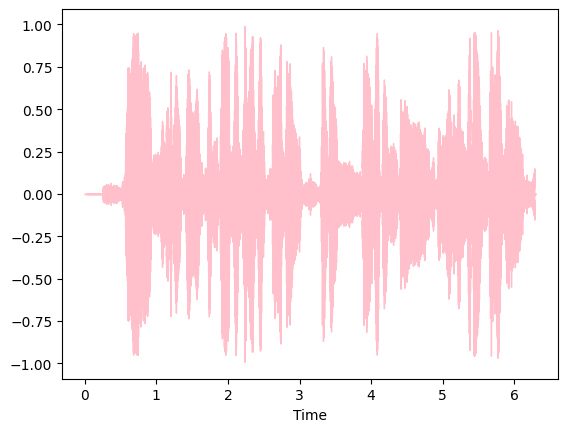

<Figure size 640x480 with 0 Axes>

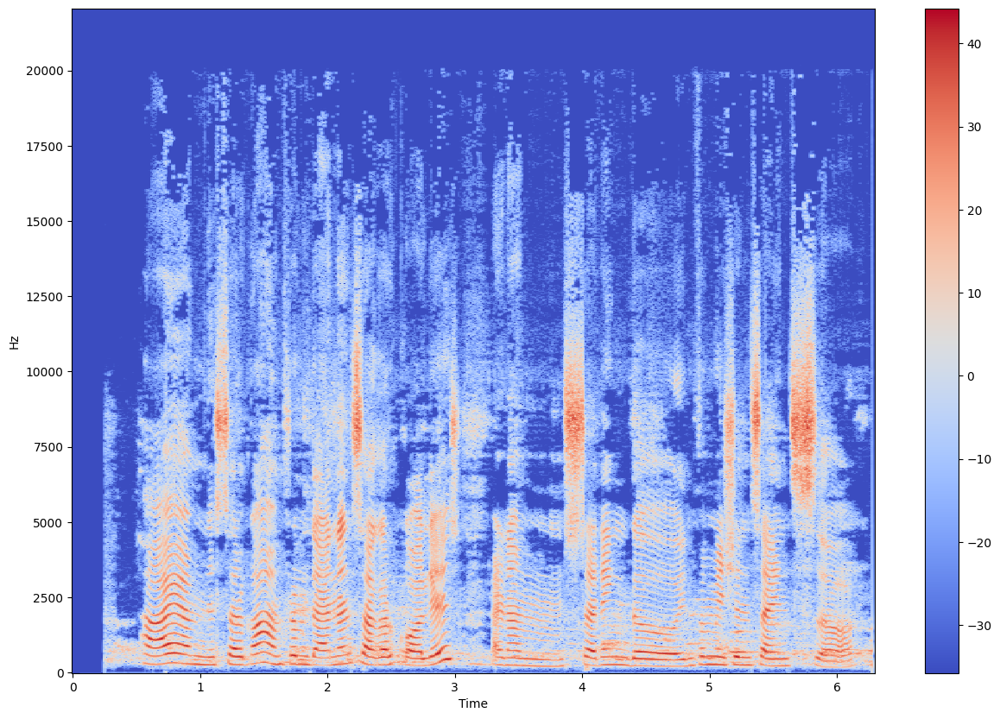

    
Pitch Range: 3991.9229
    


<Figure size 640x480 with 0 Axes>

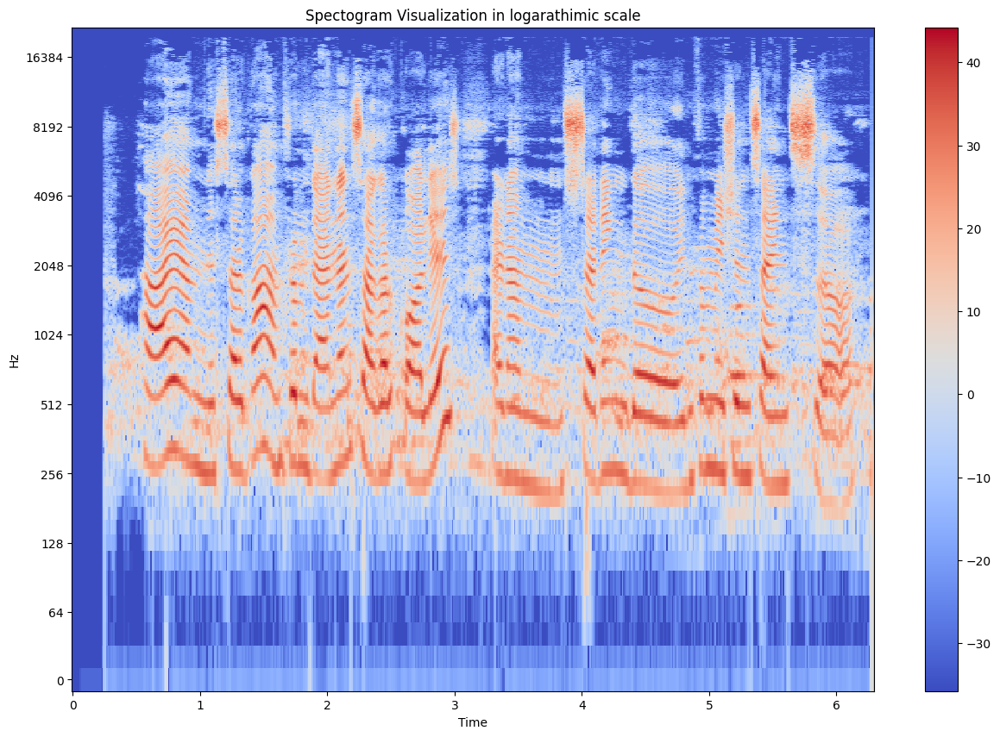

estimated temopo is  123.046875
(12,)


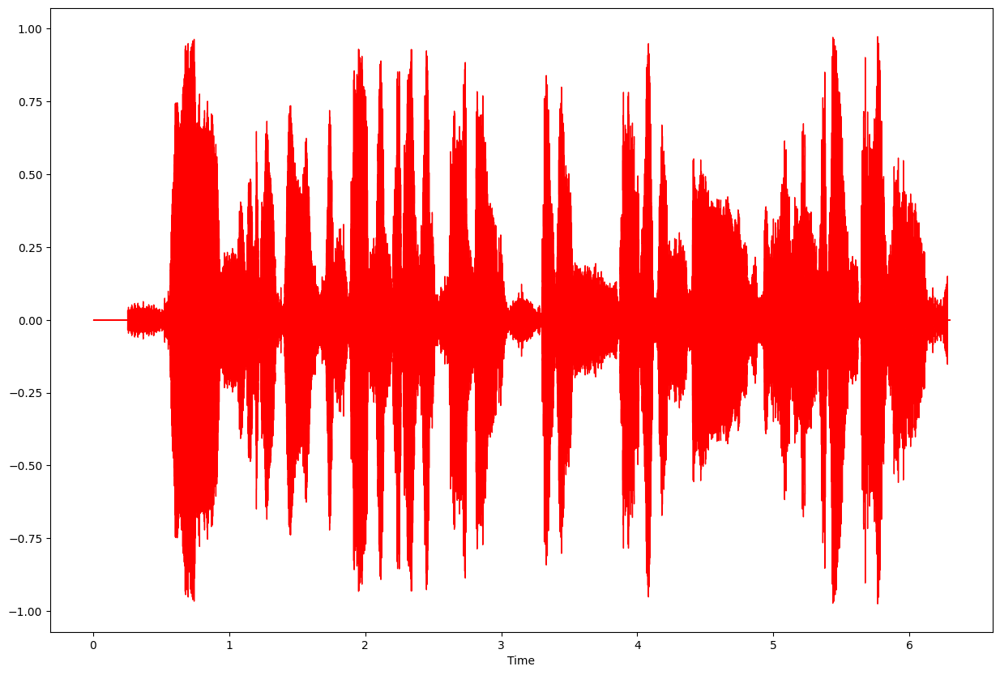

zero crossing ################
Zero Crossings in totla are :  23765


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


frames :   range(0, 272)
Shape of frames to time is  : (272,)
Plotting the Spectral Centroid along with the wave form
The audio wave form is in blue color
The spectral centroid in red color
Shape of Spectral Rolloff (272,)
Shape of frames to time is  : (272,)
Plotting the Spectral Centroid along with the wave form


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


The audio wave form is in blue color
The spectral Rolloff in red color


Enter the number of MFCC to be extracted:  


No input provided. Using default value for num_mfcc.


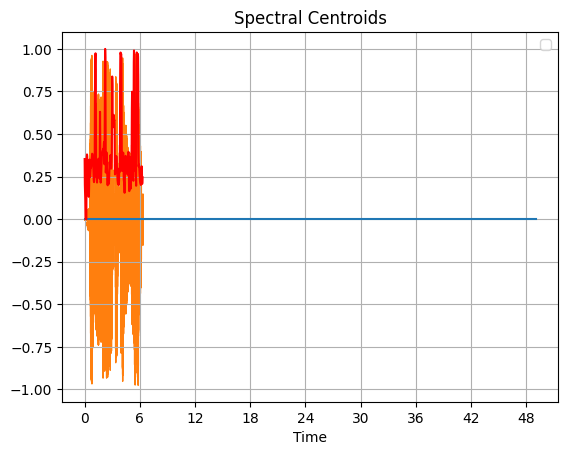

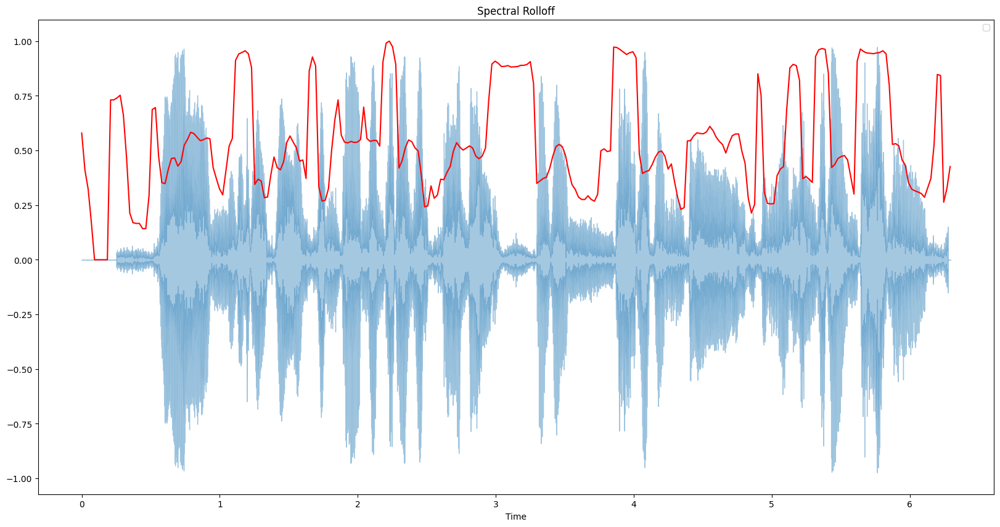

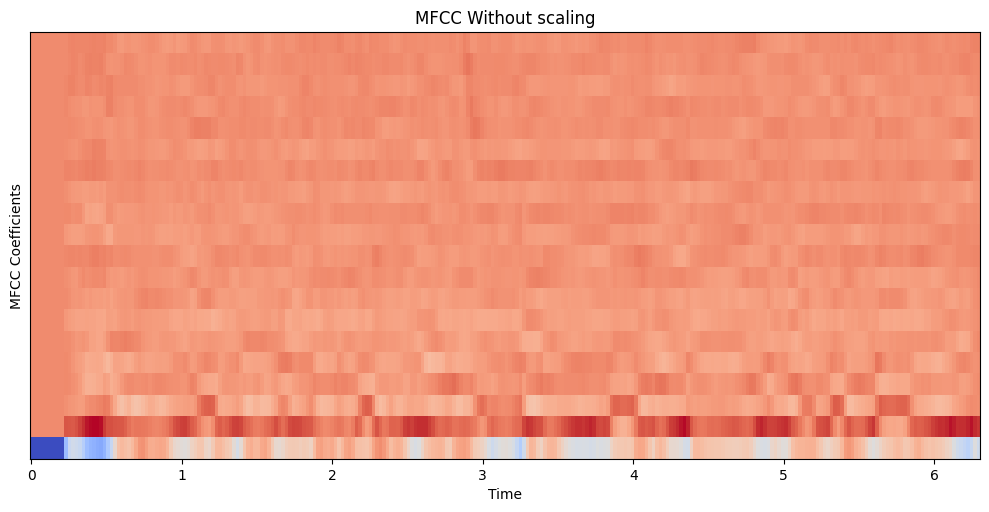

[ 7.0123112e-09 -1.4024622e-08 -3.5061556e-09 -7.0123112e-09
 -7.0123112e-09  0.0000000e+00  0.0000000e+00  0.0000000e+00
  1.4024622e-08 -1.4024622e-08  0.0000000e+00  0.0000000e+00
  0.0000000e+00  1.0518467e-08 -1.4024622e-08  7.0123112e-09
  7.0123112e-09  1.4024622e-08 -1.4024622e-08  1.4024622e-08]
[1.        1.        1.        1.0000001 1.        1.        1.
 1.        1.        1.0000001 1.        1.0000001 1.        1.
 1.0000001 0.9999999 0.9999999 1.        1.        1.       ]


/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


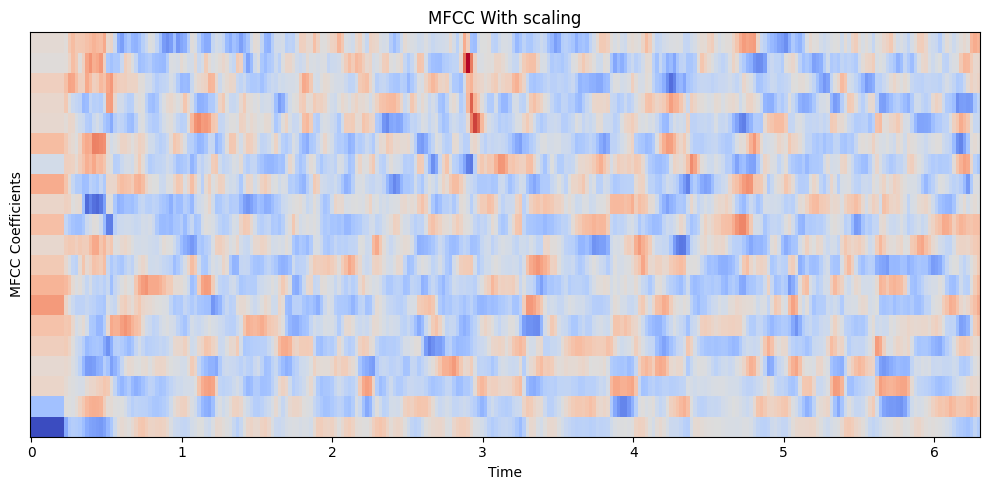



Total MFCC features are: 20 for total 272 frames.


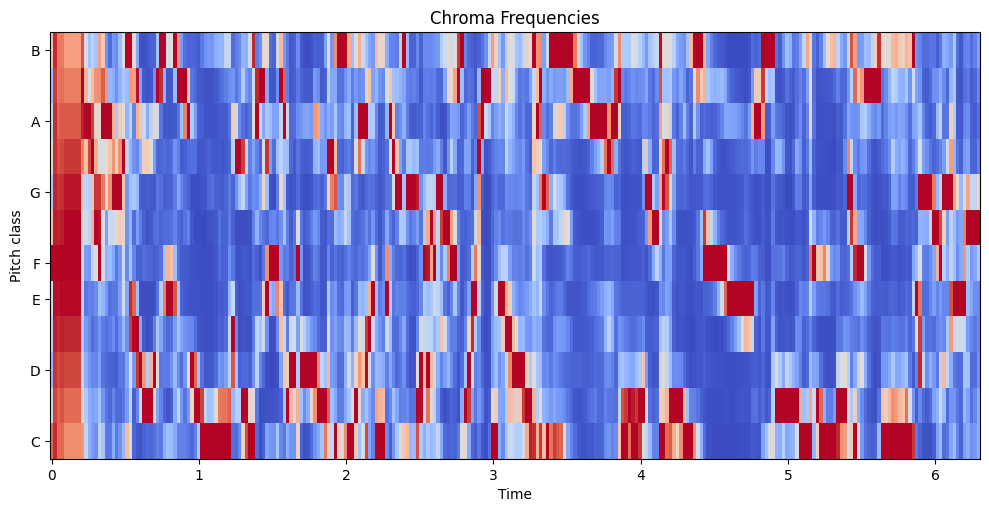

Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

audios/2023_06_10_15_48_19.mp3


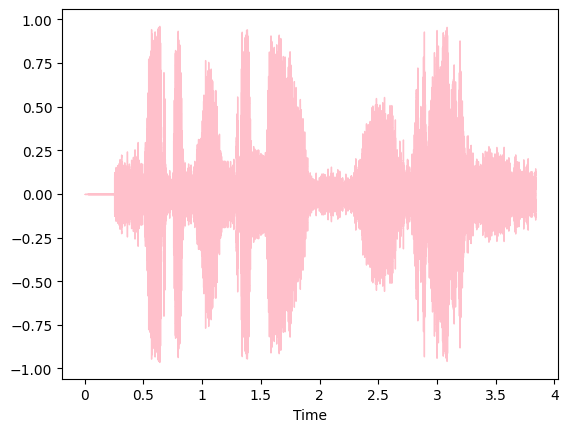

<Figure size 640x480 with 0 Axes>

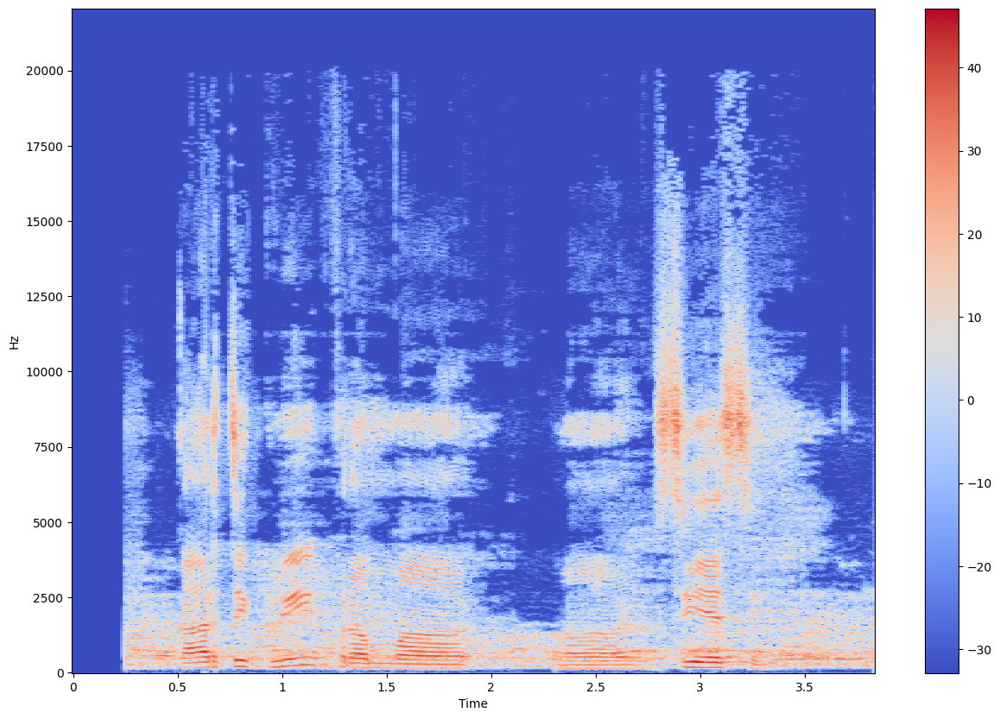

    
Pitch Range: 3984.646
    


<Figure size 640x480 with 0 Axes>

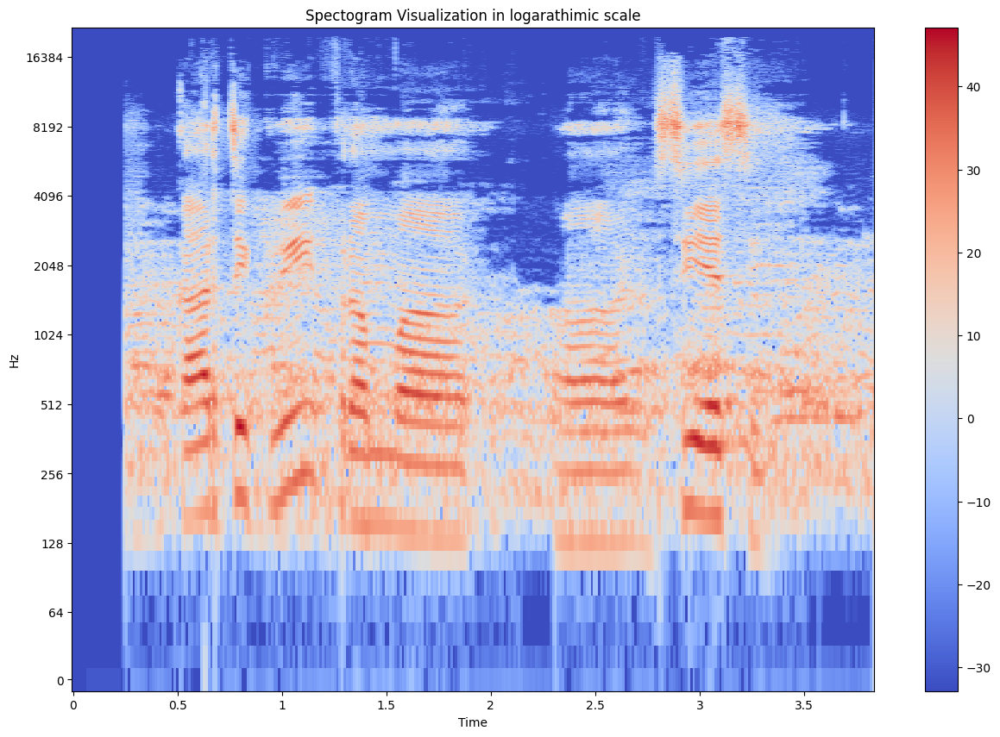

estimated temopo is  117.45383522727273
(5,)


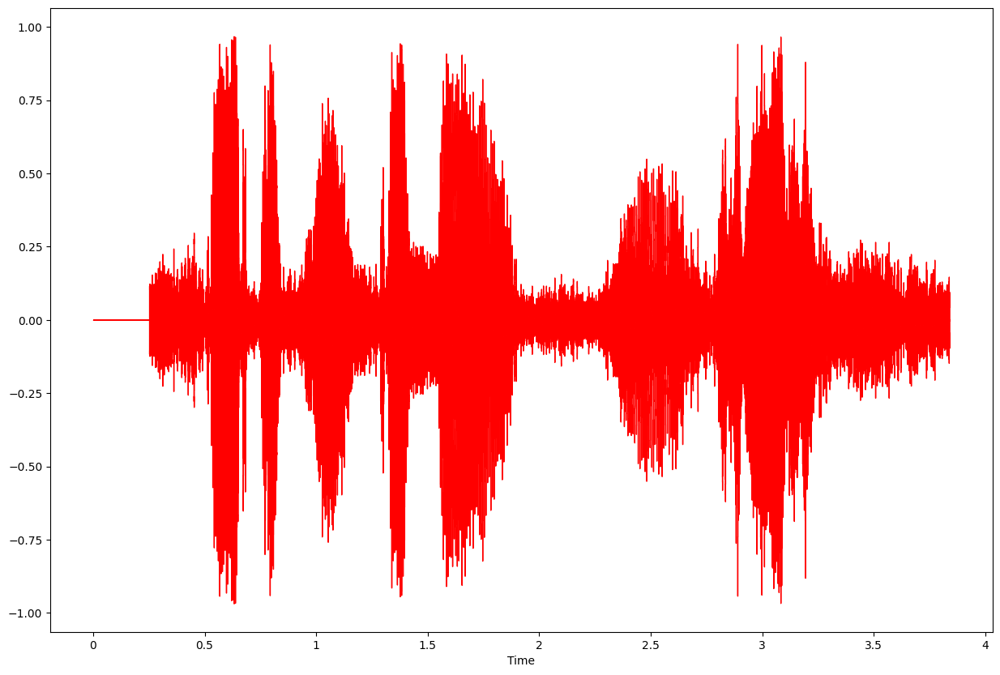

zero crossing ################
Zero Crossings in totla are :  11866
frames :   range(0, 166)
Shape of frames to time is  : (166,)
Plotting the Spectral Centroid along with the wave form


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


The audio wave form is in blue color
The spectral centroid in red color
Shape of Spectral Rolloff (166,)
Shape of frames to time is  : (166,)
Plotting the Spectral Centroid along with the wave form


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


The audio wave form is in blue color
The spectral Rolloff in red color


Enter the number of MFCC to be extracted:  


No input provided. Using default value for num_mfcc.


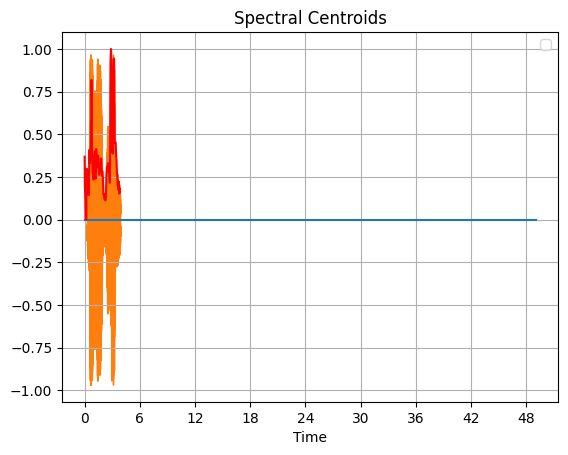

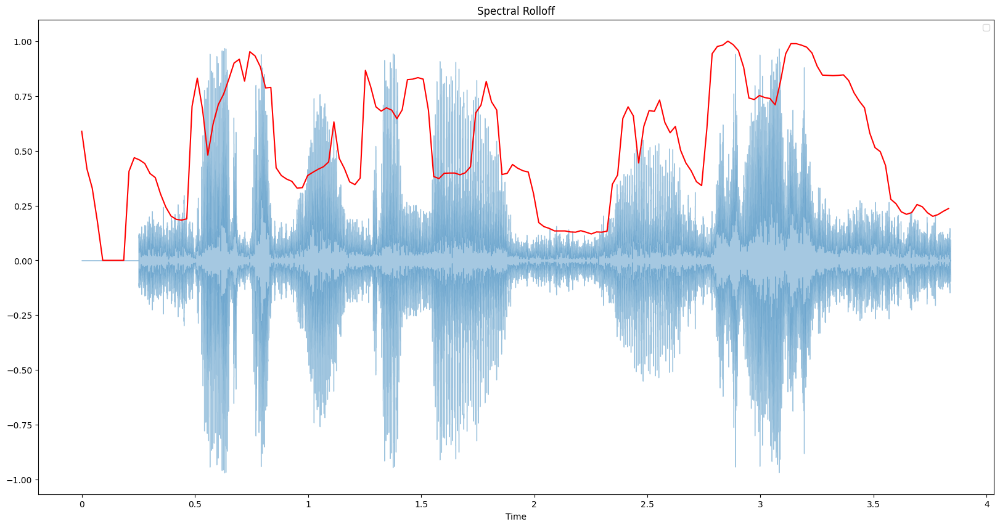

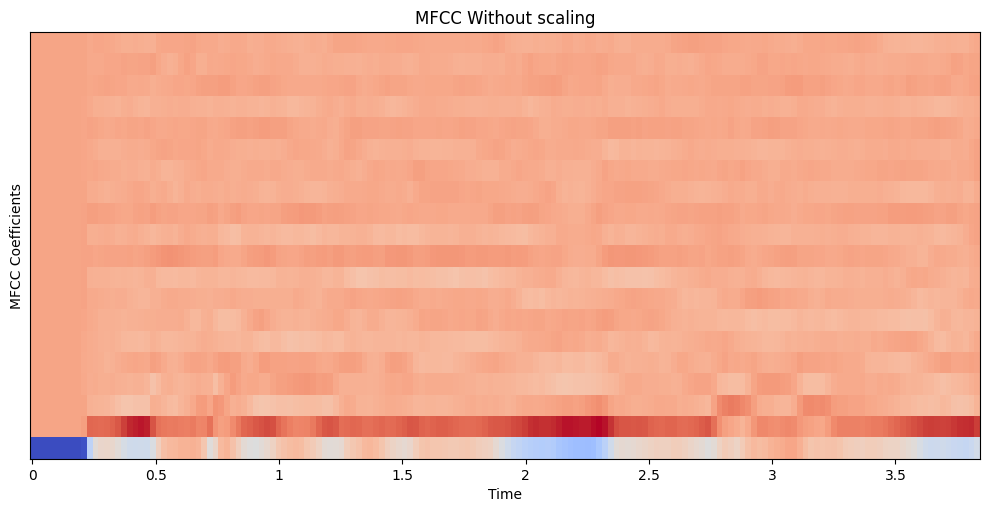

[-1.4362564e-09  5.7450258e-09  1.1490052e-08  0.0000000e+00
 -1.1490052e-08  0.0000000e+00 -1.1490052e-08  0.0000000e+00
  5.7450258e-09  0.0000000e+00  1.1490052e-08 -5.7450258e-09
  1.1490052e-08  1.7235077e-08  0.0000000e+00  1.1490052e-08
  3.2315772e-09  1.4362564e-09  0.0000000e+00  1.1490052e-08]
[1.0000001 0.9999999 1.        1.        1.        1.0000001 1.0000002
 1.        1.0000002 1.0000001 1.0000001 1.0000002 1.        0.9999999
 1.        0.9999999 1.        1.        1.        1.0000001]


/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


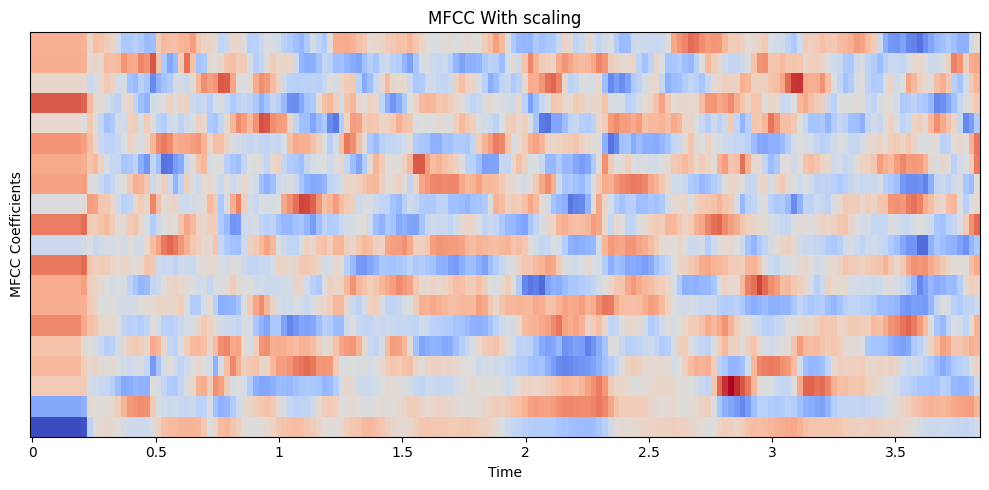



Total MFCC features are: 20 for total 166 frames.


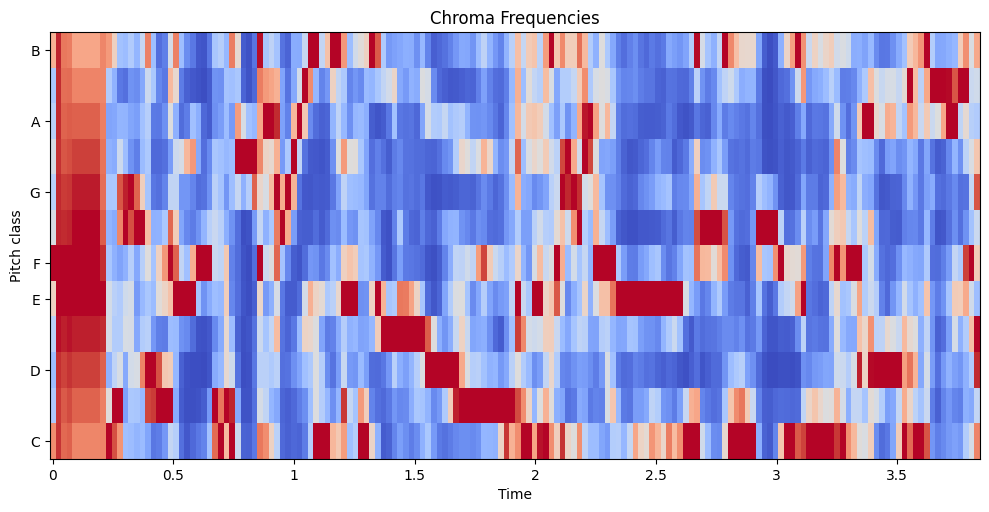

Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

audios/2023_06_10_15_46_20.mp3


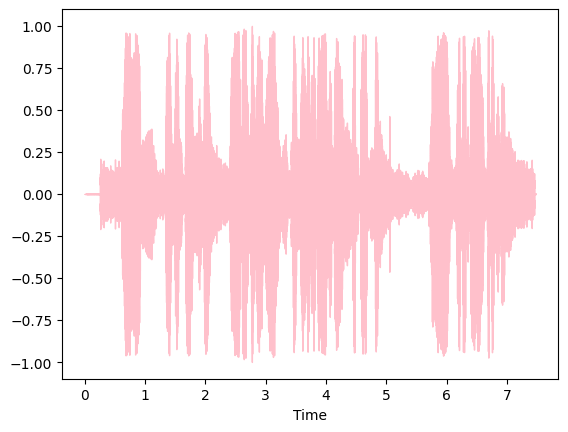

<Figure size 640x480 with 0 Axes>

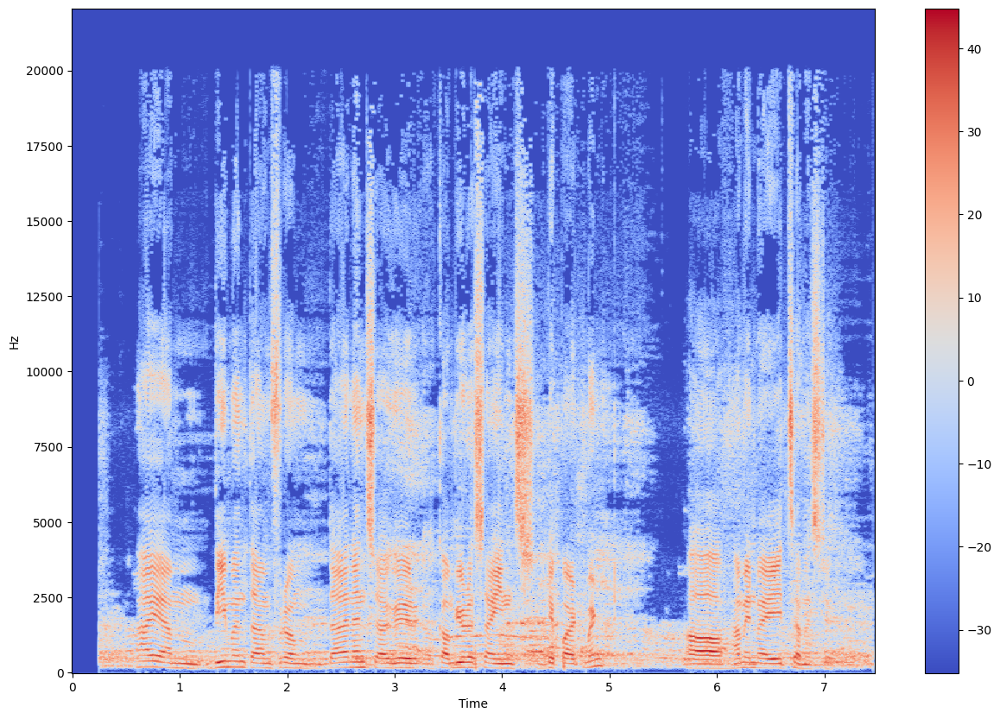

    
Pitch Range: 3994.2686
    


<Figure size 640x480 with 0 Axes>

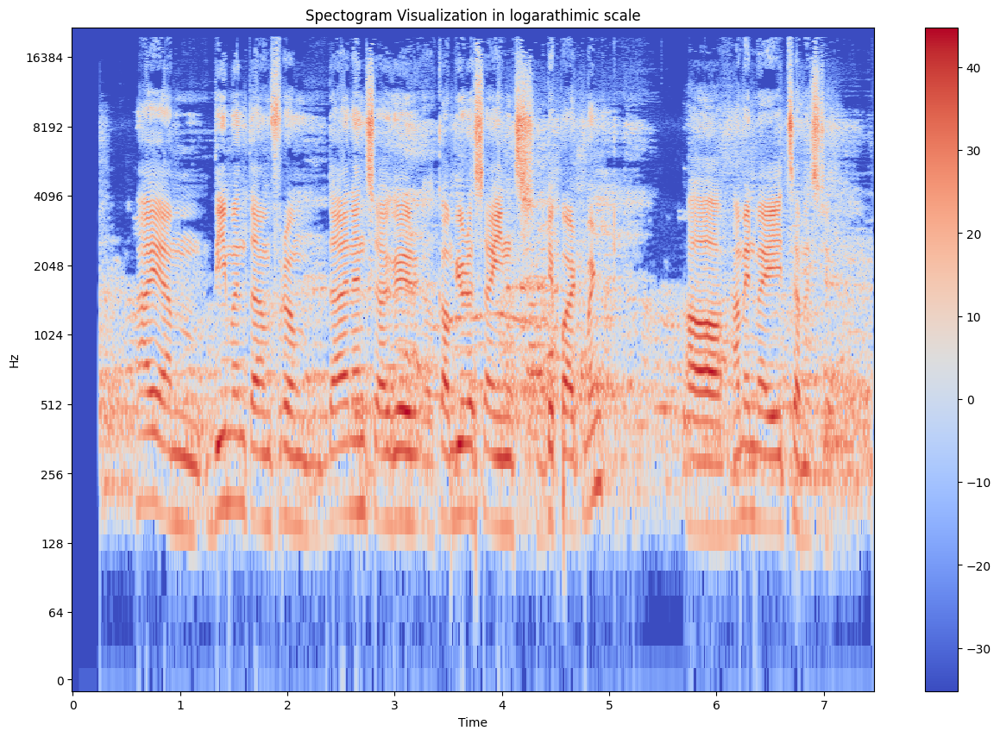

estimated temopo is  92.28515625
(10,)


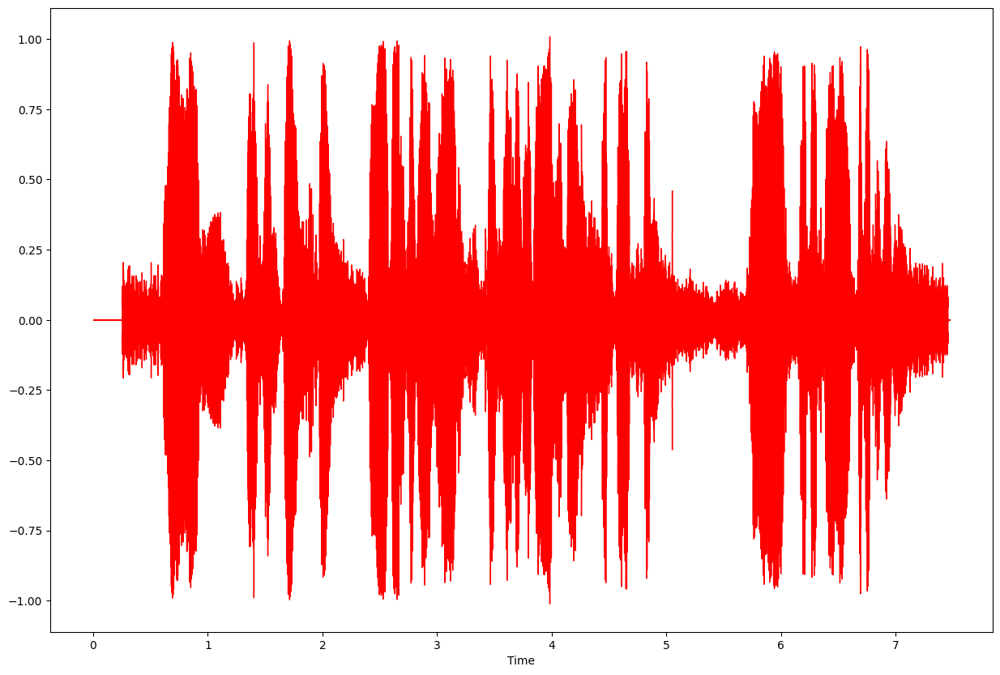

zero crossing ################


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Zero Crossings in totla are :  24301
frames :   range(0, 322)
Shape of frames to time is  : (322,)
Plotting the Spectral Centroid along with the wave form
The audio wave form is in blue color
The spectral centroid in red color
Shape of Spectral Rolloff (322,)
Shape of frames to time is  : (322,)
Plotting the Spectral Centroid along with the wave form


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


The audio wave form is in blue color
The spectral Rolloff in red color


Enter the number of MFCC to be extracted:  


No input provided. Using default value for num_mfcc.


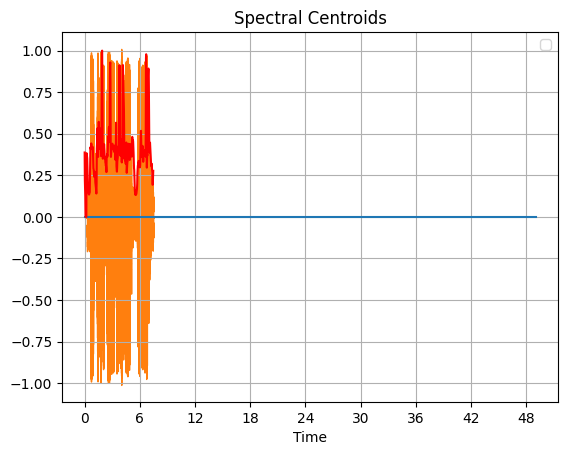

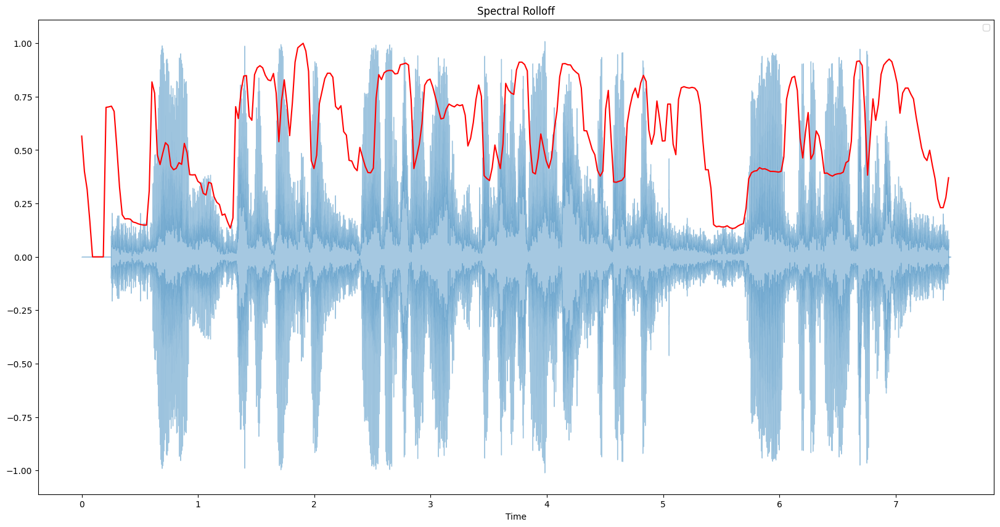

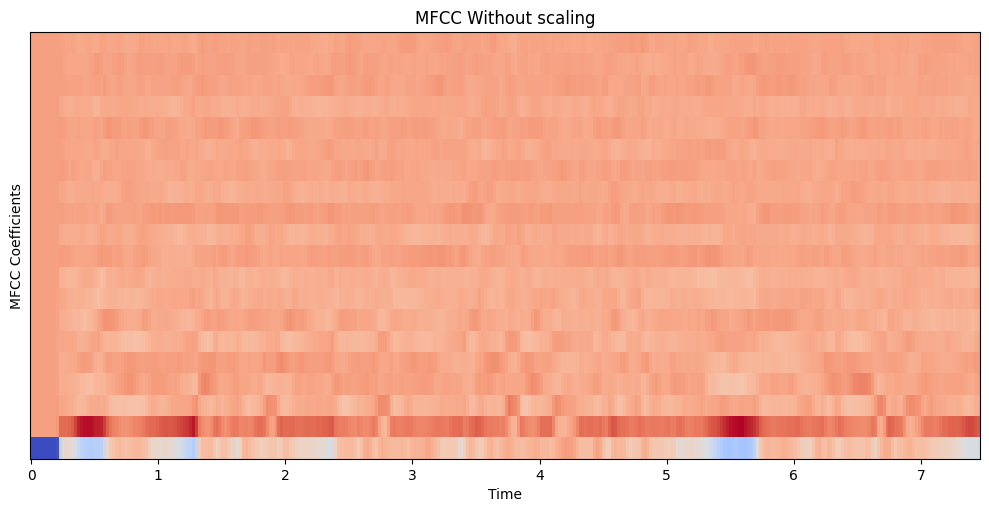

[ 0.0000000e+00  2.9617215e-09 -2.9617215e-09  2.9617215e-09
 -2.3693772e-08  0.0000000e+00  8.8851646e-09  1.1846886e-08
 -1.1846886e-08  5.9234431e-09  0.0000000e+00  0.0000000e+00
  0.0000000e+00 -5.9234431e-09  5.9234431e-09  0.0000000e+00
 -7.4043038e-09 -1.4808608e-08  0.0000000e+00 -5.9234431e-09]
[1.0000002 0.9999999 1.        1.0000001 1.        0.9999999 1.
 1.        1.0000002 1.        1.        1.0000001 1.0000001 1.
 1.        1.        1.        1.        1.        1.       ]


/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


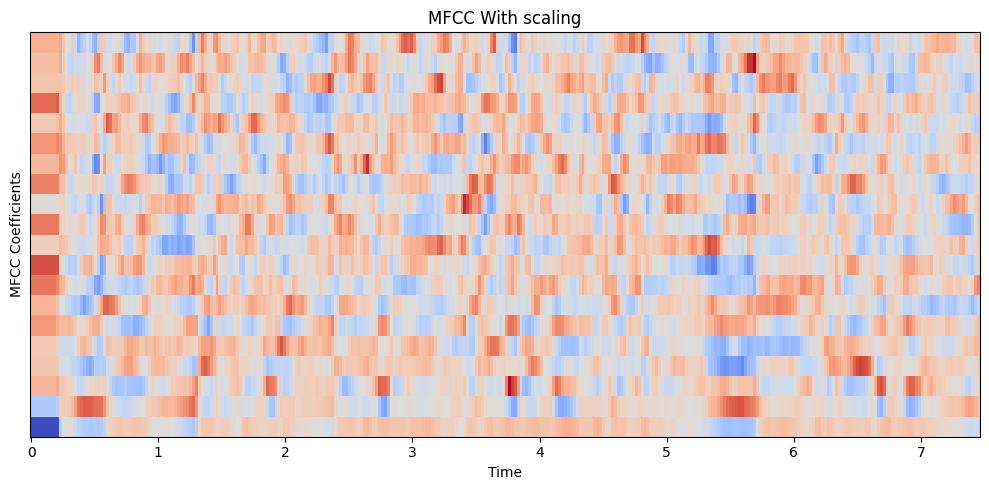



Total MFCC features are: 20 for total 322 frames.


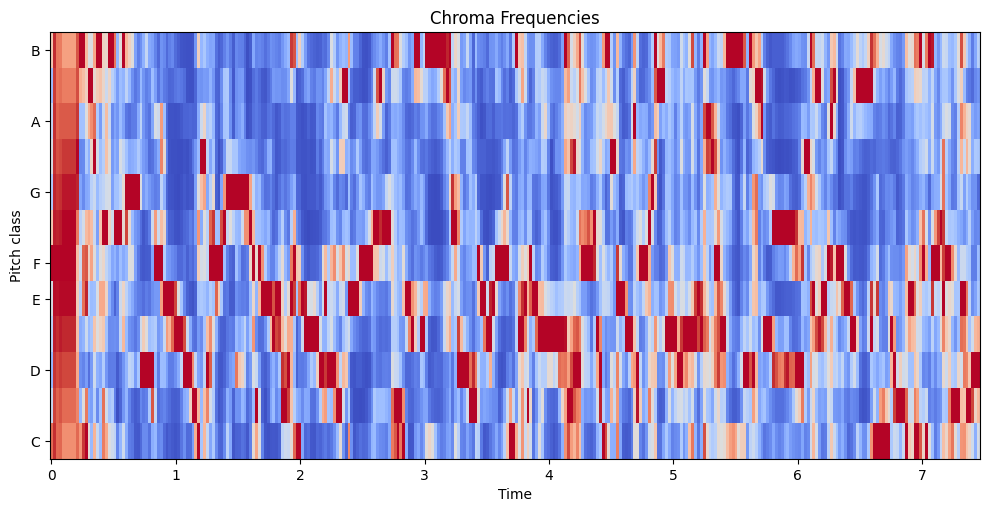

Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

audios/2023_06_10_16_04_19.mp3


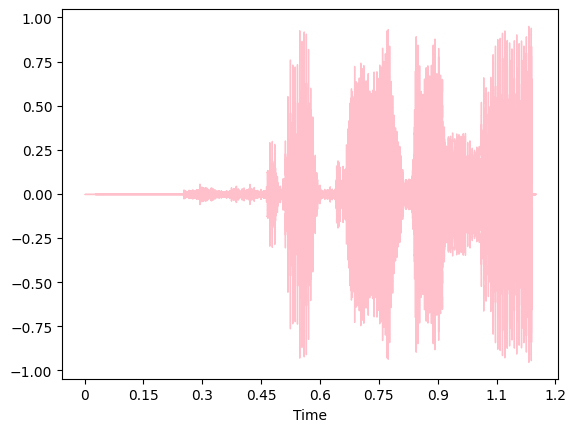

<Figure size 640x480 with 0 Axes>

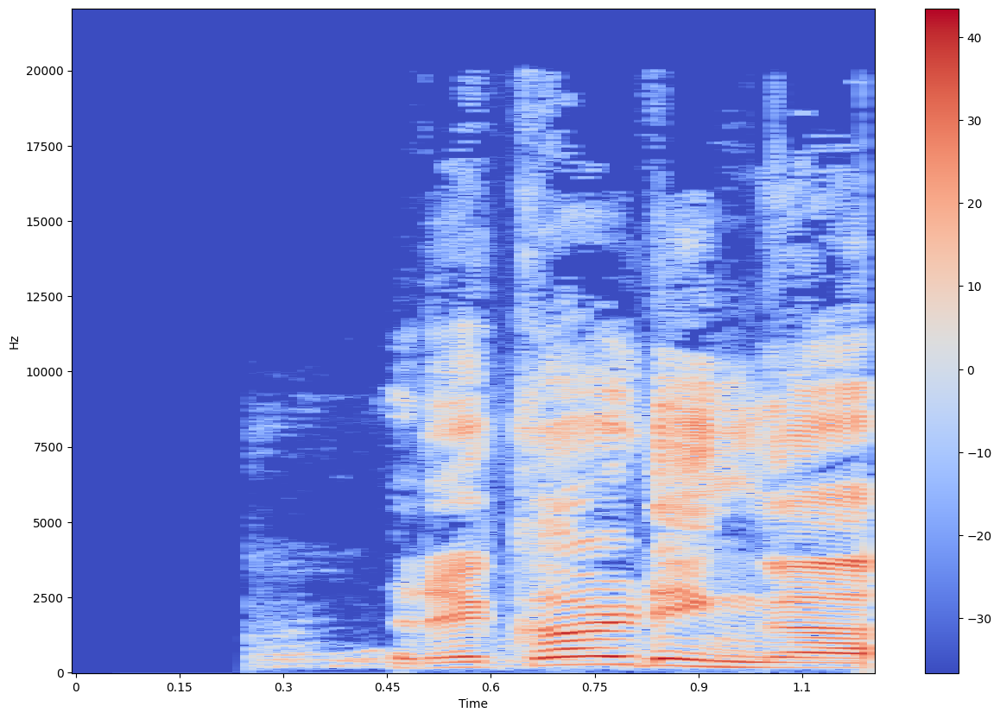

    
Pitch Range: 3988.1333
    


<Figure size 640x480 with 0 Axes>

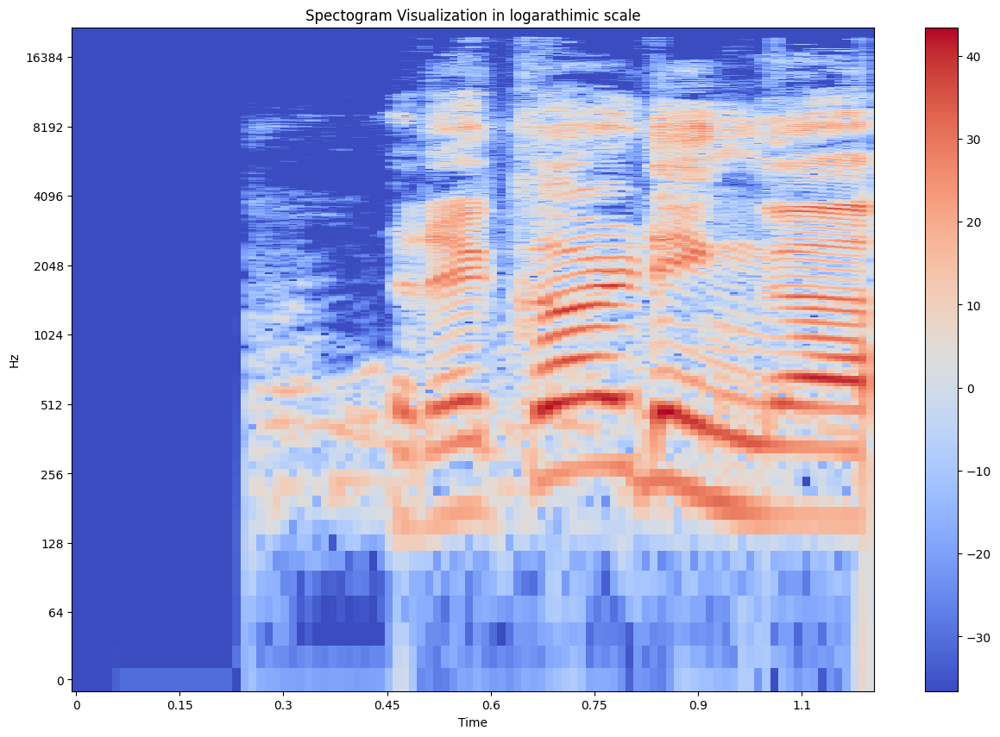

estimated temopo is  156.60511363636363
(2,)


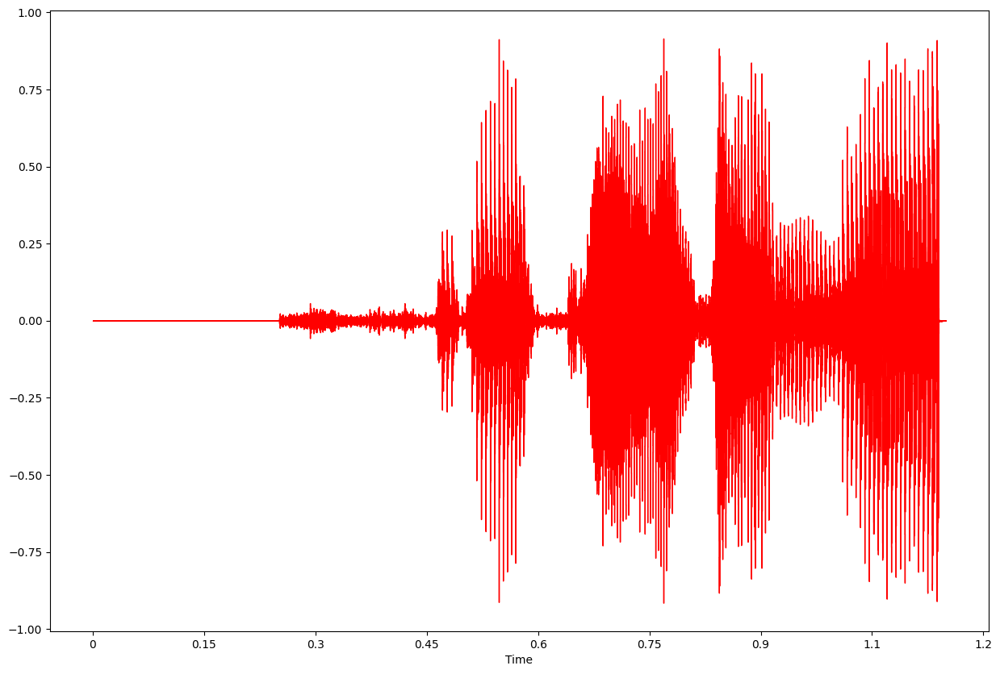

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


zero crossing ################
Zero Crossings in totla are :  2966
frames :   range(0, 50)
Shape of frames to time is  : (50,)
Plotting the Spectral Centroid along with the wave form
The audio wave form is in blue color
The spectral centroid in red color
Shape of Spectral Rolloff (50,)
Shape of frames to time is  : (50,)
Plotting the Spectral Centroid along with the wave form


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


The audio wave form is in blue color
The spectral Rolloff in red color


Enter the number of MFCC to be extracted:  


No input provided. Using default value for num_mfcc.


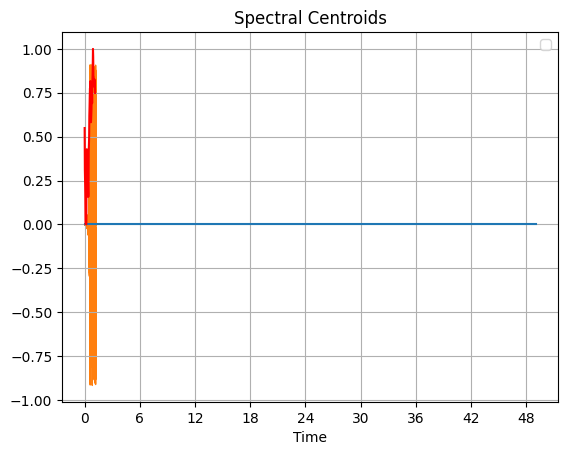

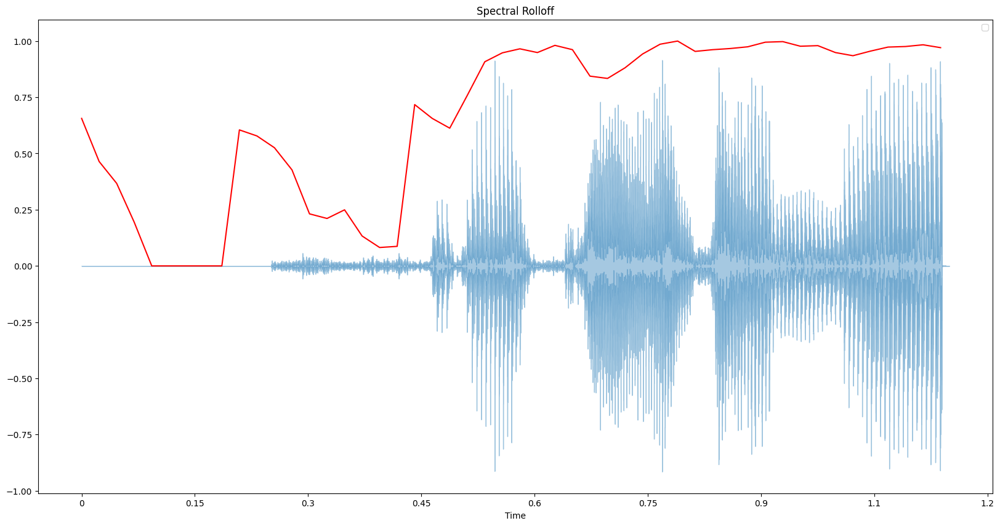

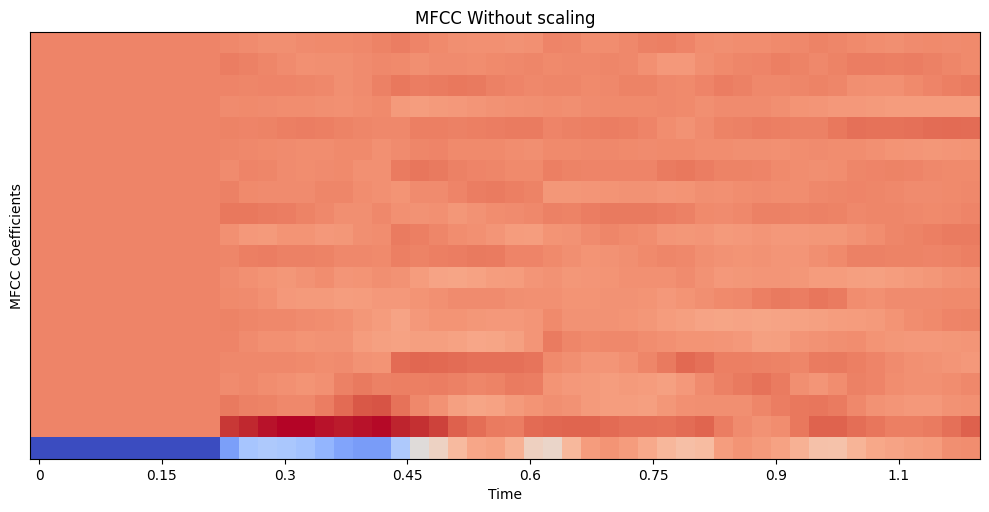

[-1.66893006e-08  2.38418574e-09  0.00000000e+00 -5.58793545e-09
  0.00000000e+00 -5.96046434e-10  2.38418574e-09  1.07288365e-08
  1.37090685e-08  0.00000000e+00 -9.53674295e-09 -7.15255721e-09
  2.98023217e-10  1.19209287e-09  2.38418574e-09  1.43051144e-08
  2.86102289e-08 -7.15255721e-09  9.53674295e-09 -8.94069707e-09]
[1.0000001  0.99999994 0.9999998  1.         0.99999994 1.
 1.         1.         1.         1.0000001  0.99999976 1.0000001
 1.0000001  1.         1.         1.         1.0000001  0.99999994
 1.0000001  1.        ]


/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


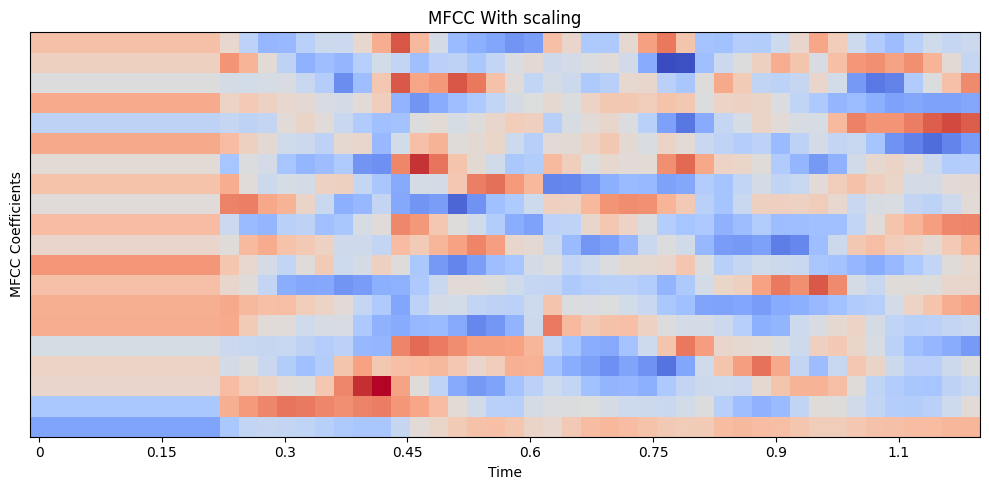



Total MFCC features are: 20 for total 50 frames.


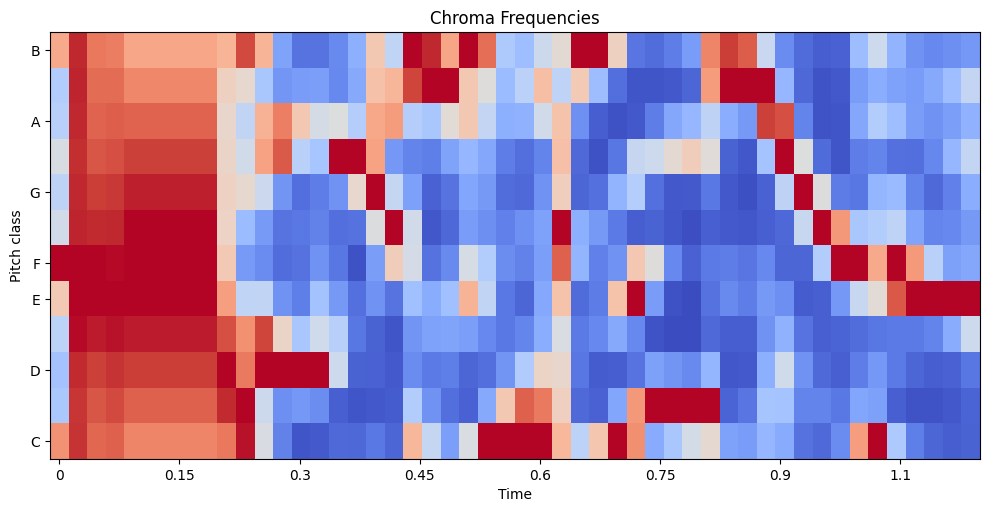

Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

audios/2023_06_10_16_20_25.mp3


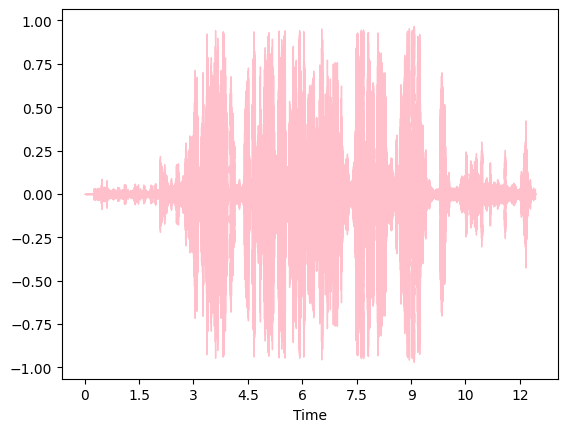

<Figure size 640x480 with 0 Axes>

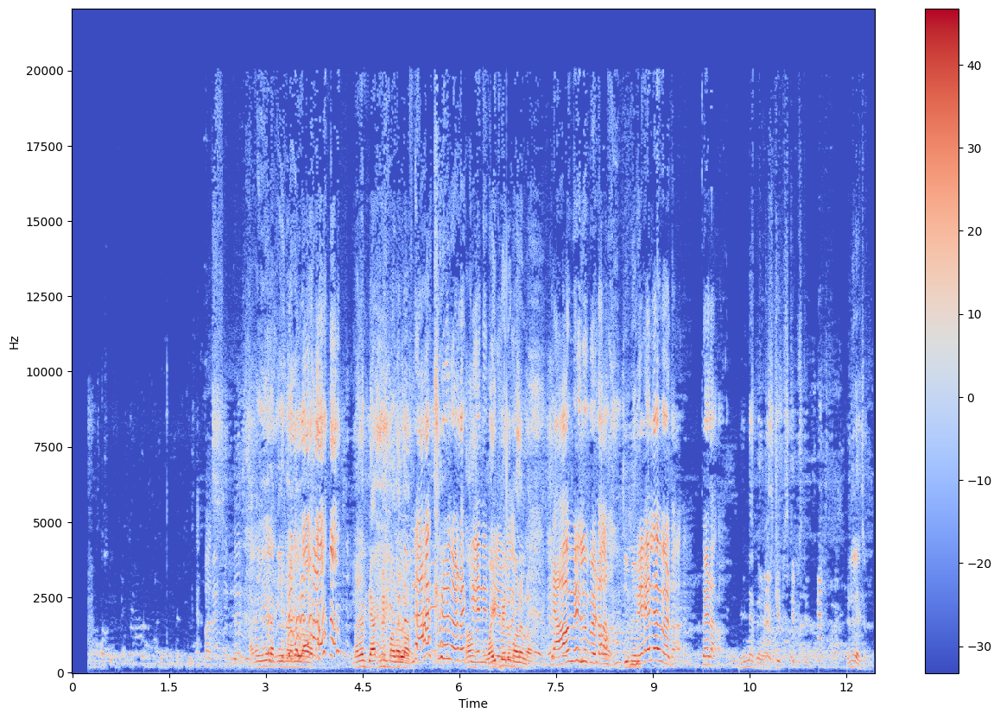

    
Pitch Range: 3993.7153
    


<Figure size 640x480 with 0 Axes>

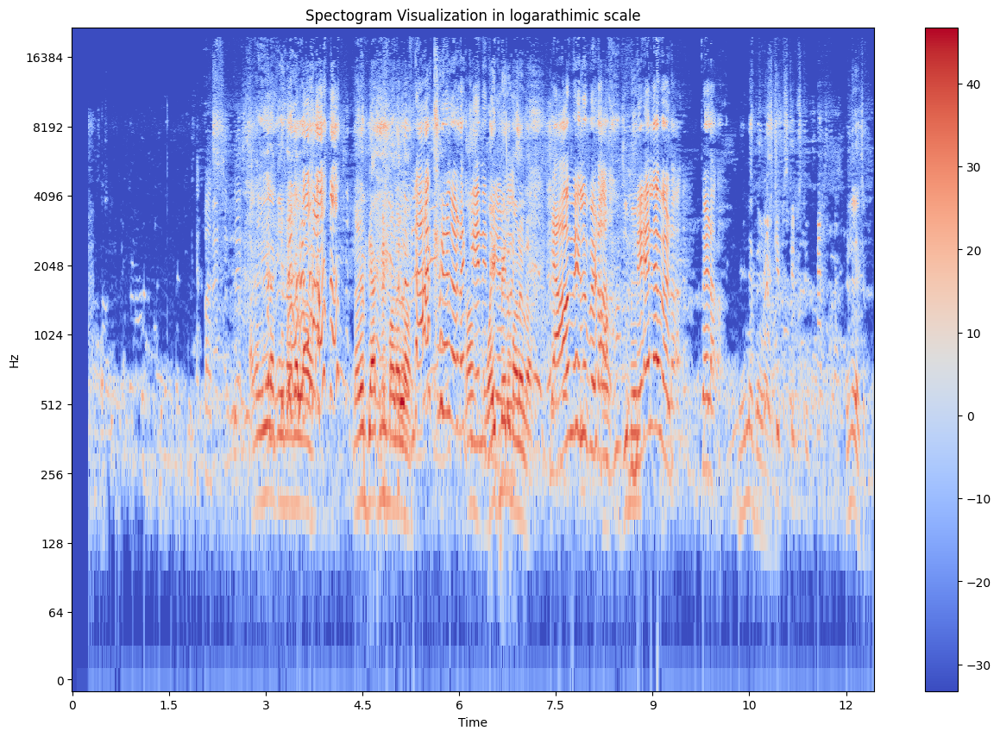

estimated temopo is  99.38401442307692
(18,)


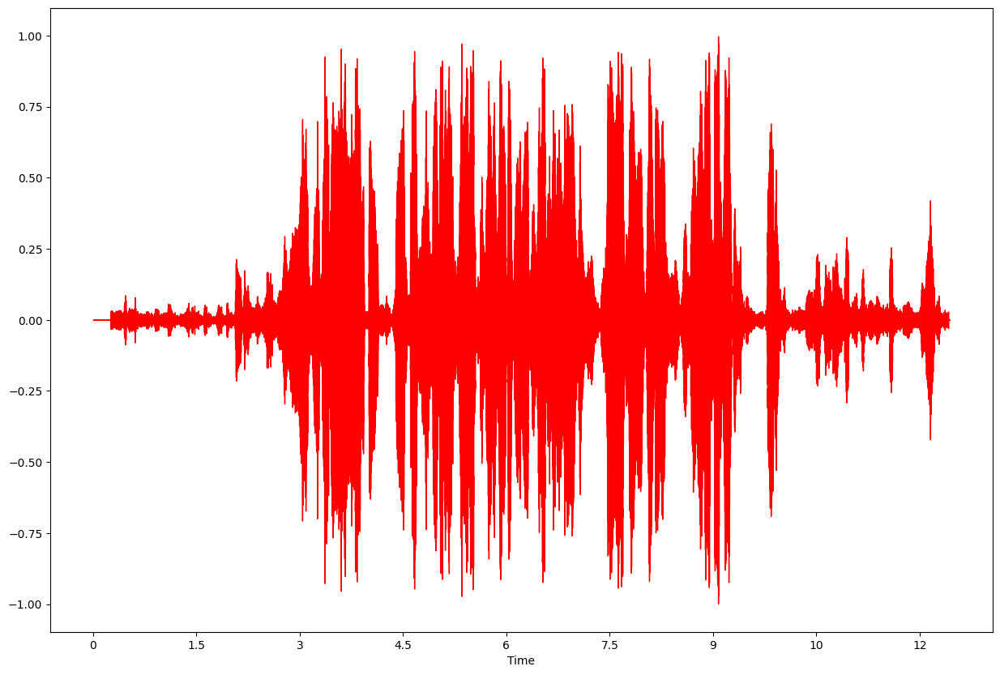

zero crossing ################


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Zero Crossings in totla are :  40024
frames :   range(0, 536)
Shape of frames to time is  : (536,)
Plotting the Spectral Centroid along with the wave form
The audio wave form is in blue color
The spectral centroid in red color
Shape of Spectral Rolloff (536,)
Shape of frames to time is  : (536,)
Plotting the Spectral Centroid along with the wave form


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


The audio wave form is in blue color
The spectral Rolloff in red color


Enter the number of MFCC to be extracted:  


No input provided. Using default value for num_mfcc.


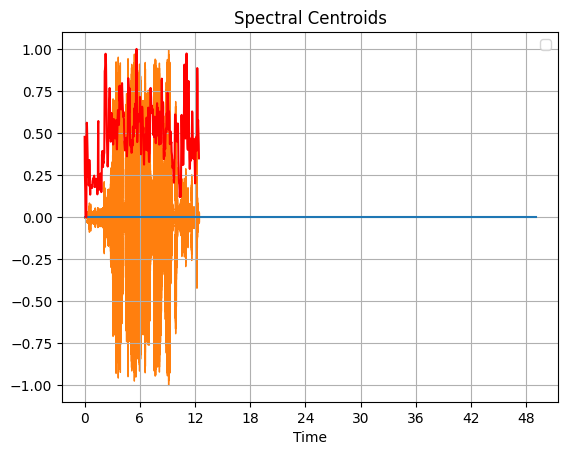

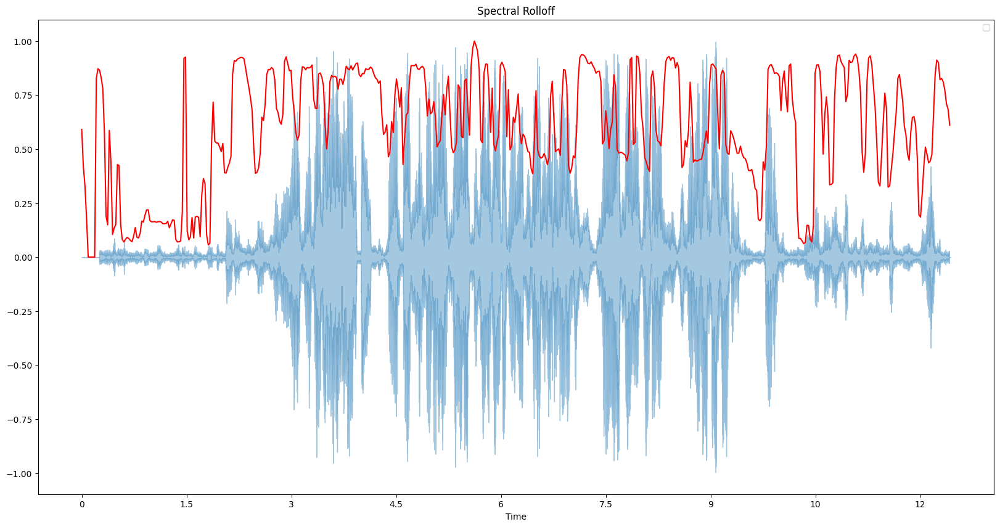

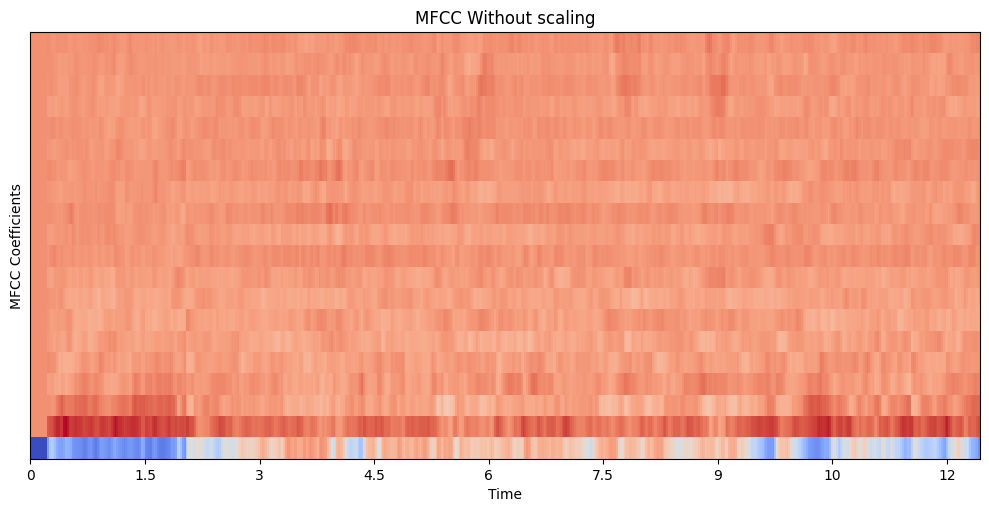

[-2.8467889e-08 -1.4233945e-08  1.4233945e-08  0.0000000e+00
 -5.3377294e-09  0.0000000e+00  1.0675459e-08 -1.4233945e-08
  0.0000000e+00  0.0000000e+00  0.0000000e+00 -7.1169723e-09
 -1.4233945e-08  0.0000000e+00  2.1350917e-08  1.0675459e-08
  7.1169723e-09  7.1169723e-09 -1.0675459e-08  7.1169723e-09]
[0.9999999 1.        1.        1.        1.        1.        1.
 1.        1.        1.        1.        1.        1.        1.
 1.        1.        1.        1.        1.        1.0000001]


/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


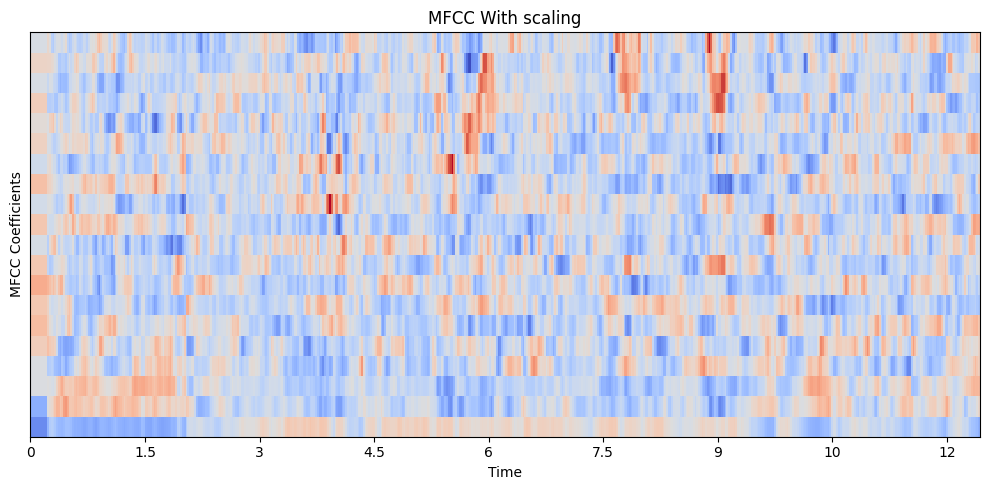



Total MFCC features are: 20 for total 536 frames.


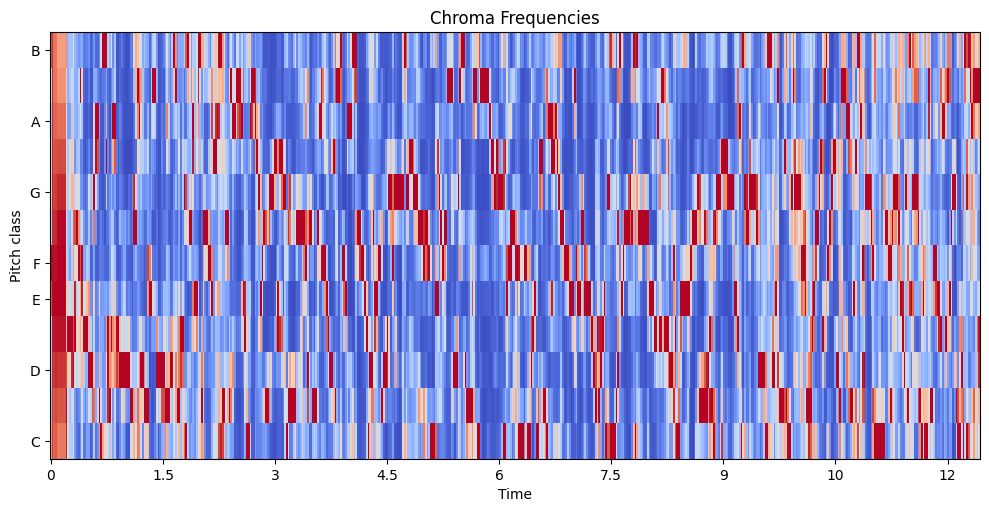

Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

audios/2023_06_10_16_02_51.mp3


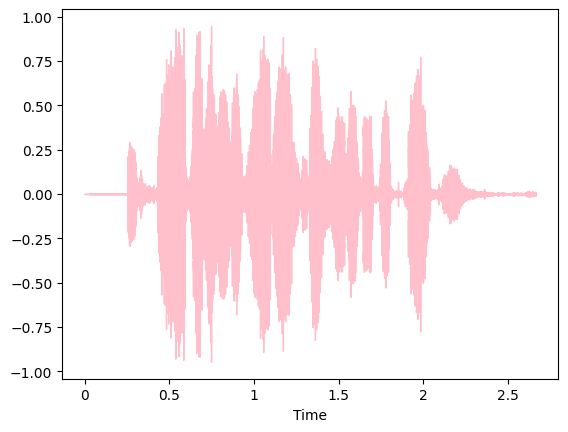

<Figure size 640x480 with 0 Axes>

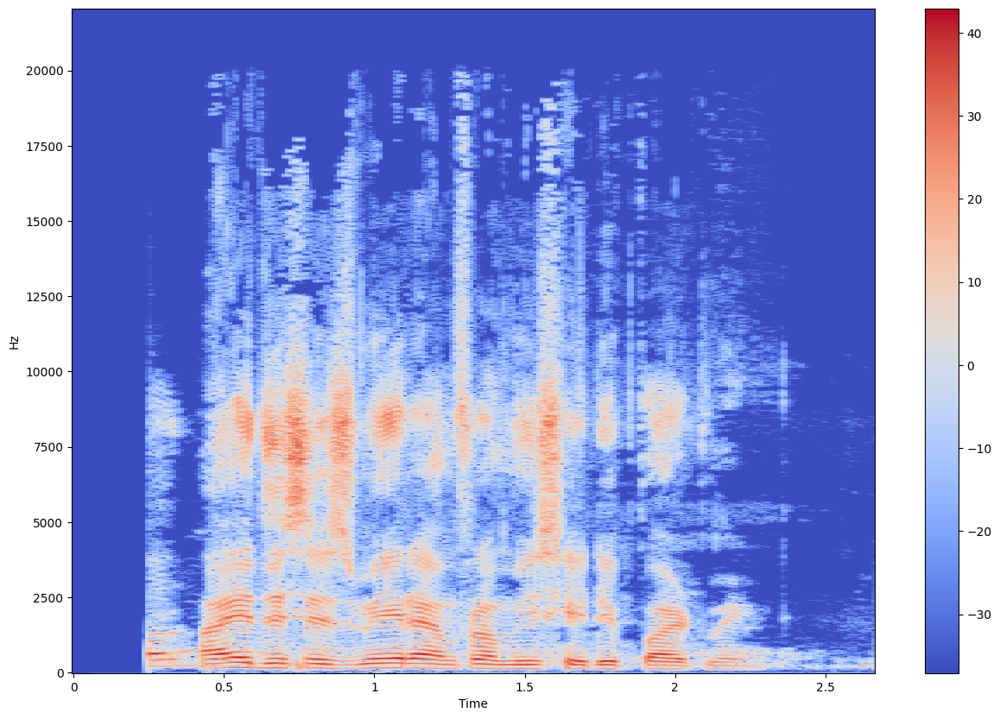

    
Pitch Range: 3987.336
    


<Figure size 640x480 with 0 Axes>

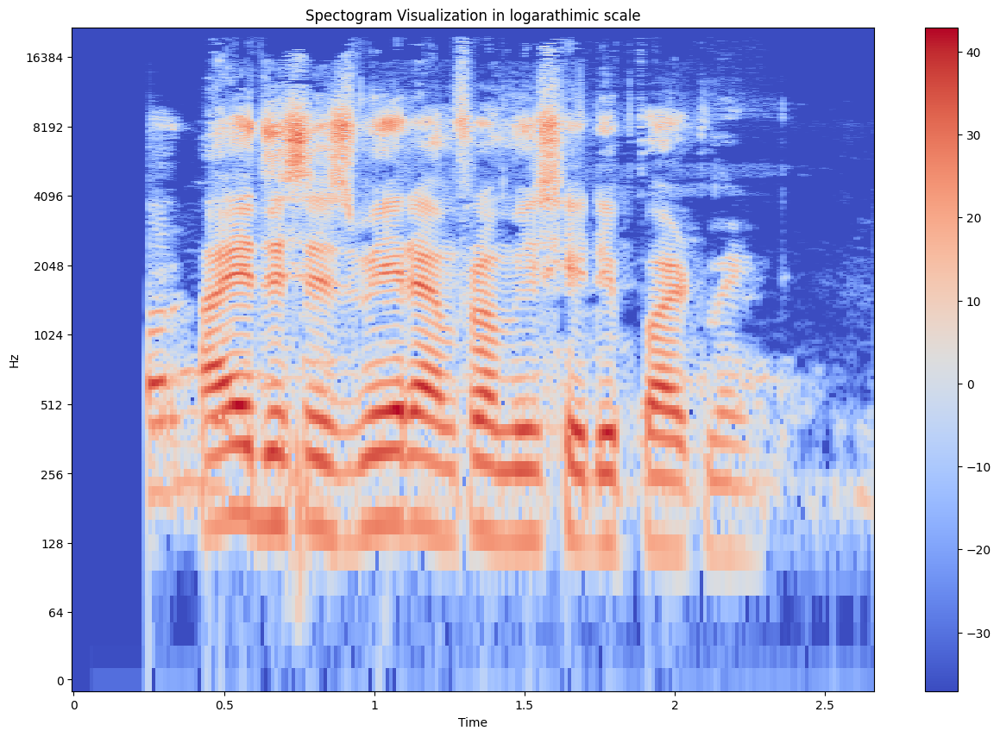

estimated temopo is  156.60511363636363
(4,)


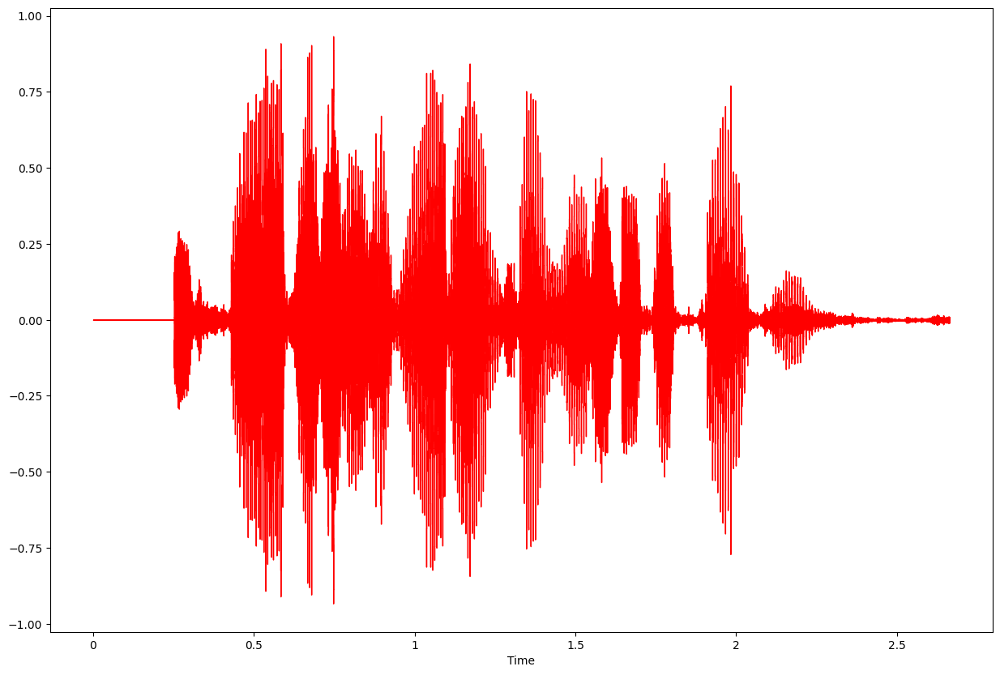

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


zero crossing ################
Zero Crossings in totla are :  9065
frames :   range(0, 115)
Shape of frames to time is  : (115,)
Plotting the Spectral Centroid along with the wave form
The audio wave form is in blue color
The spectral centroid in red color
Shape of Spectral Rolloff (115,)
Shape of frames to time is  : (115,)
Plotting the Spectral Centroid along with the wave form


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


The audio wave form is in blue color
The spectral Rolloff in red color


Enter the number of MFCC to be extracted:  


No input provided. Using default value for num_mfcc.


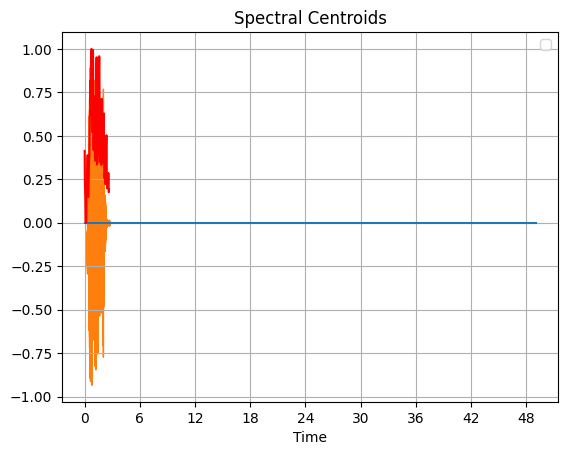

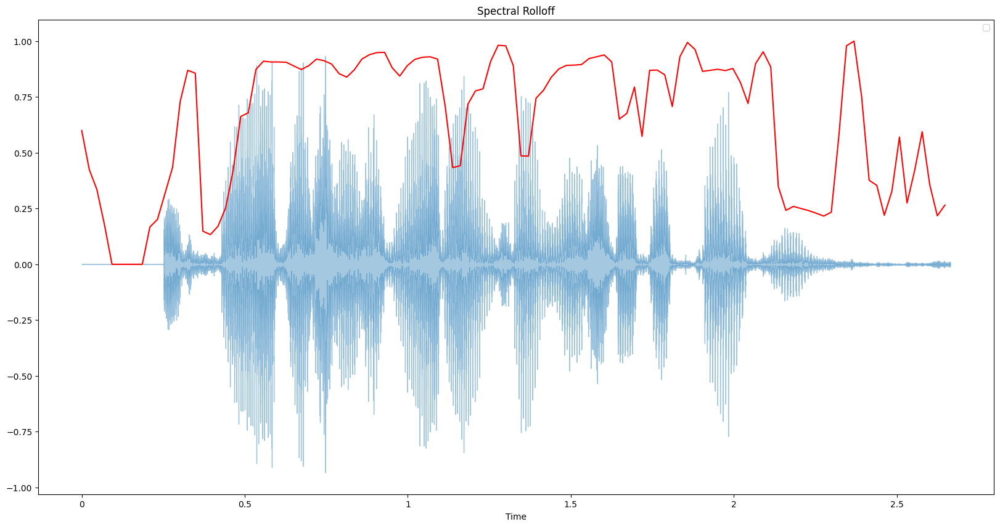

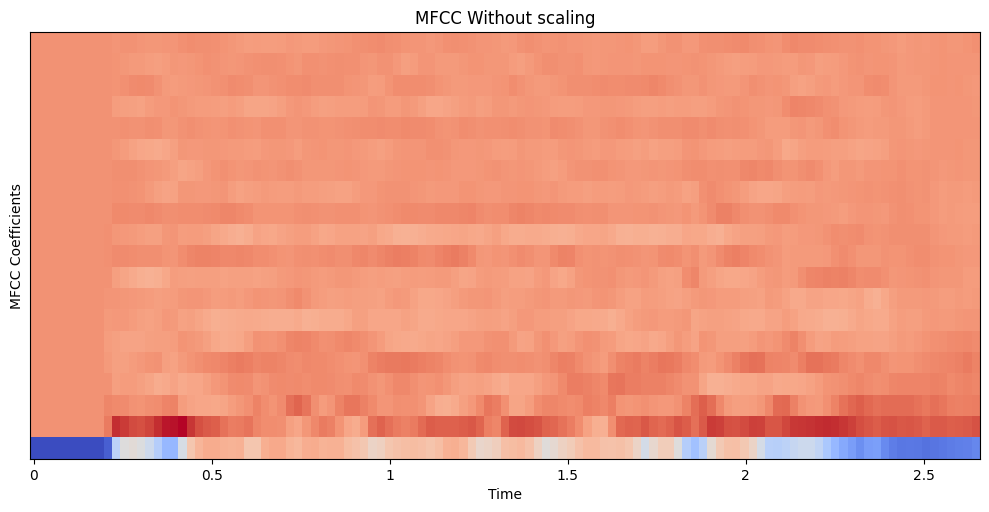

[-3.1098075e-09  1.1920929e-08  0.0000000e+00  5.1830124e-10
  5.1830124e-10  3.1098075e-09  6.2196150e-09  4.2759853e-09
 -1.2957531e-08 -1.0366025e-09 -1.6585640e-08 -1.4512435e-08
  4.4055608e-09  5.7013136e-09 -1.0366025e-08 -3.6281087e-09
 -5.9604646e-09 -7.2562174e-09  3.3689582e-09 -7.7745188e-09]
[1.0000001  1.         1.         1.         1.0000001  1.0000001
 1.         0.9999999  0.99999994 1.         0.99999994 0.99999994
 1.         1.0000001  1.0000001  1.         1.0000002  1.
 1.0000001  1.0000001 ]


/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


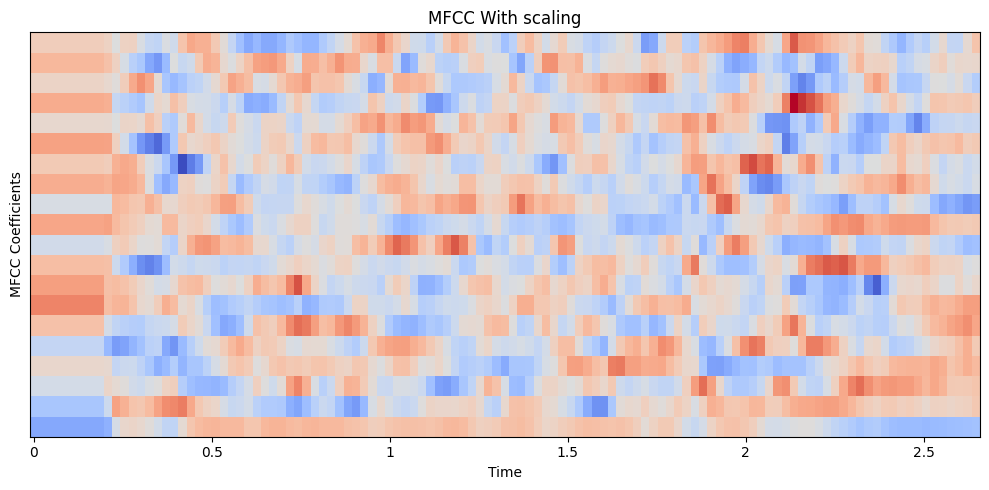



Total MFCC features are: 20 for total 115 frames.


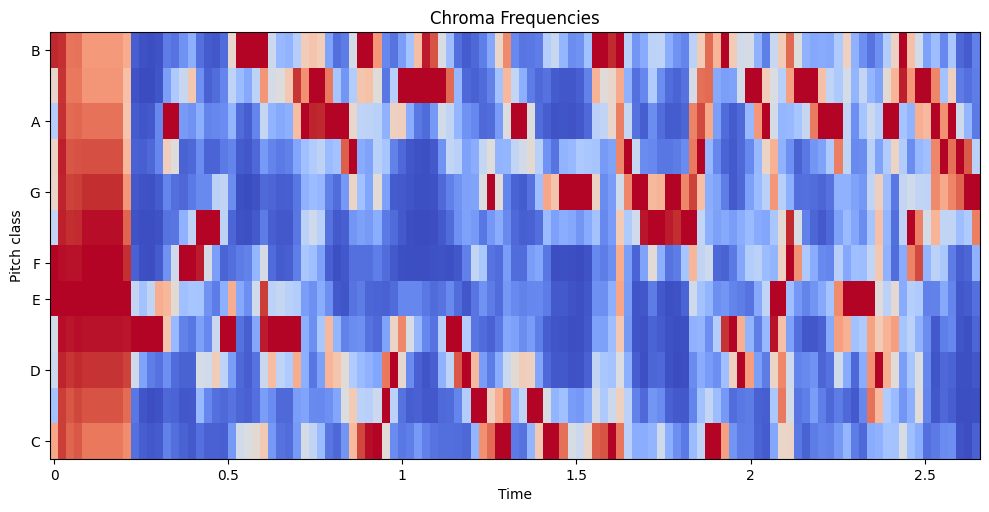

Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

Note: Illegal Audio-MPEG-Header 0xc5fffb92 at offset 22986.
Note: Trying to resync...
Note: Skipped 1 bytes in input.


1/1 [==============================] - 0s 109ms/step
Result: female
Probabilities:     Male: 13.04%    Female: 86.96%

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB



audios/2023_06_10_15_54_19.mp3


Note: Illegal Audio-MPEG-Header 0xc5fffb92 at offset 22986.
Note: Trying to resync...
Note: Skipped 1 bytes in input.
Note: Illegal Audio-MPEG-Header 0xc5fffb92 at offset 22986.
Note: Trying to resync...
Note: Skipped 1 bytes in input.


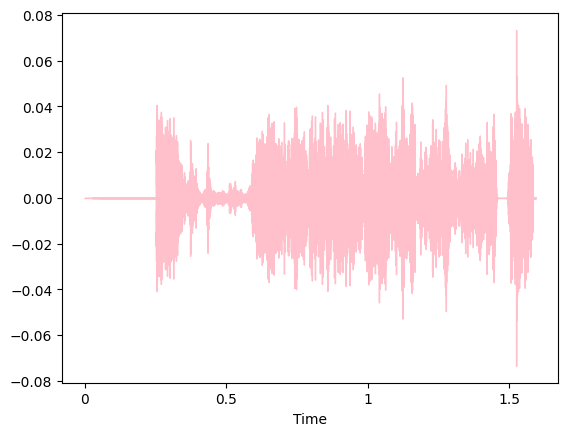

<Figure size 640x480 with 0 Axes>

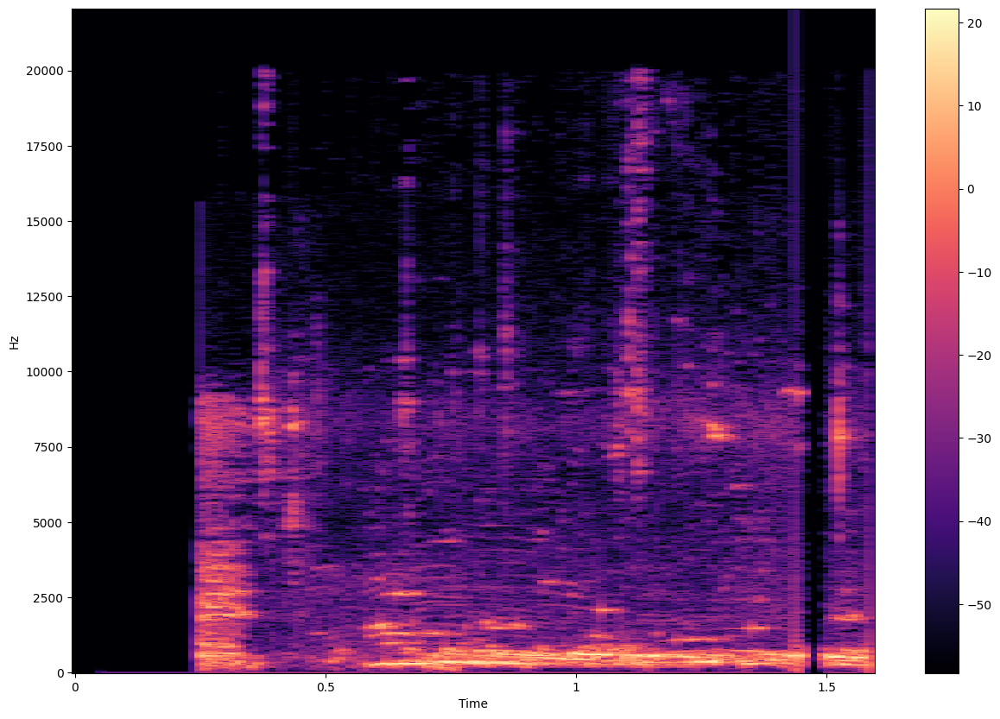

    
Pitch Range: 3980.5706
    


<Figure size 640x480 with 0 Axes>

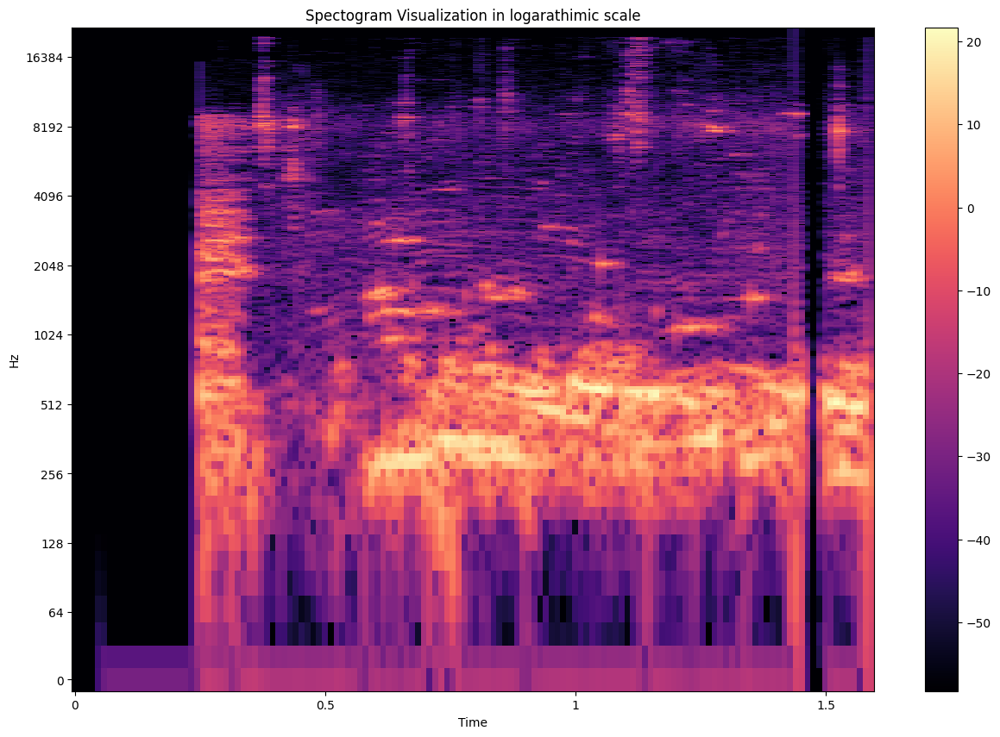

estimated temopo is  47.8515625
(1,)


Note: Illegal Audio-MPEG-Header 0xc5fffb92 at offset 22986.
Note: Trying to resync...
Note: Skipped 1 bytes in input.


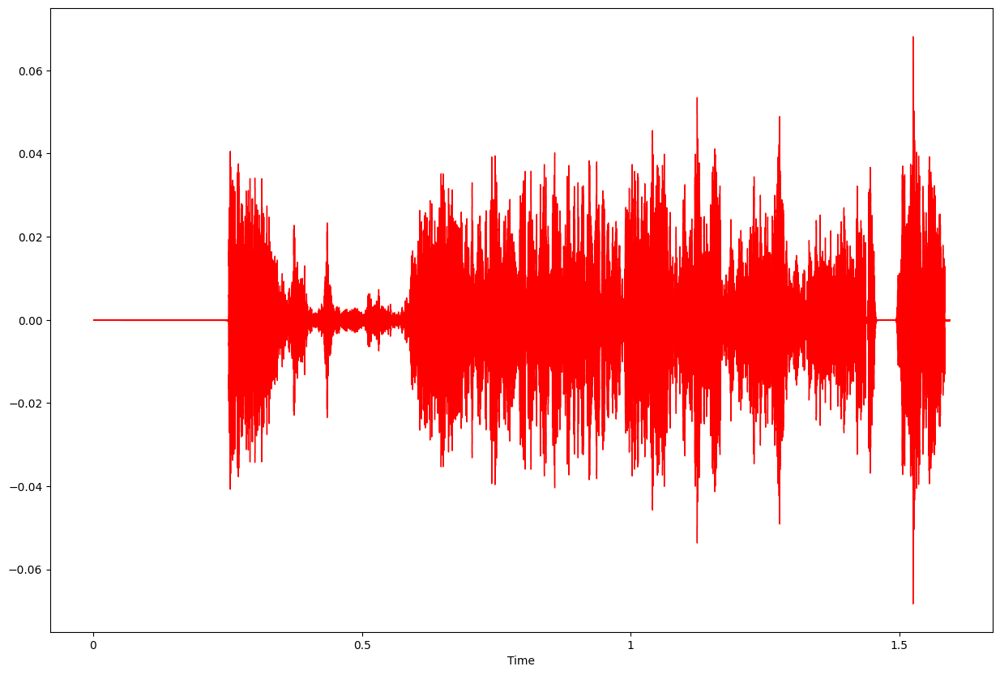

Note: Illegal Audio-MPEG-Header 0xc5fffb92 at offset 22986.
Note: Trying to resync...
Note: Skipped 1 bytes in input.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


zero crossing ################
Zero Crossings in totla are :  3980
frames :   range(0, 69)
Shape of frames to time is  : (69,)
Plotting the Spectral Centroid along with the wave form
The audio wave form is in blue color
The spectral centroid in red color
Shape of Spectral Rolloff (69,)
Shape of frames to time is  : (69,)
Plotting the Spectral Centroid along with the wave form


Note: Illegal Audio-MPEG-Header 0xc5fffb92 at offset 22986.
Note: Trying to resync...
Note: Skipped 1 bytes in input.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
Note: Illegal Audio-MPEG-Header 0xc5fffb92 at offset 22986.
Note: Trying to resync...
Note: Skipped 1 bytes in input.


The audio wave form is in blue color
The spectral Rolloff in red color


Enter the number of MFCC to be extracted:  


No input provided. Using default value for num_mfcc.


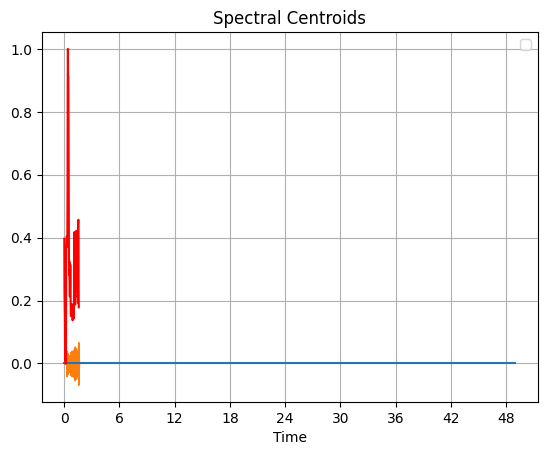

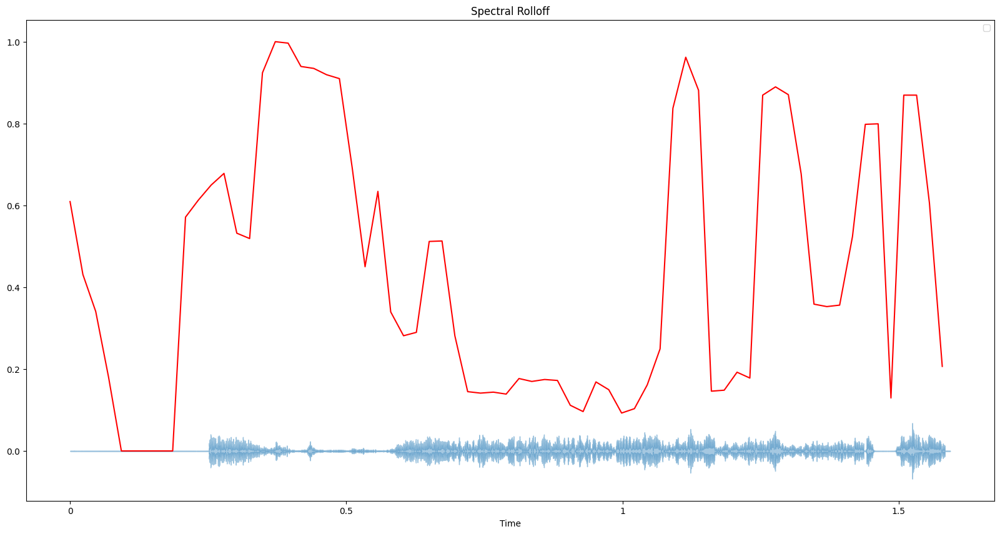

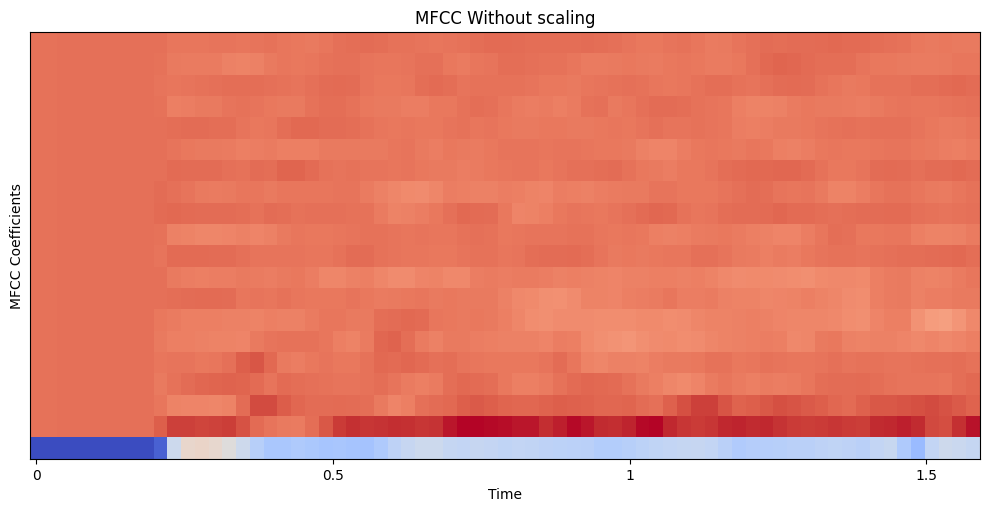

[-1.2093696e-08  3.4553418e-09 -6.4787655e-09  3.4553418e-09
  3.8872594e-09 -9.3942107e-09  0.0000000e+00 -4.9670539e-09
 -5.1830127e-09  0.0000000e+00  9.9341078e-09 -9.9341078e-09
  1.3821367e-08 -6.0468479e-09 -1.7276709e-09  4.3191770e-09
 -8.6383545e-10  1.0366025e-08  1.0420015e-08  5.1830127e-09]
[1.         1.         1.0000002  0.99999976 1.0000001  1.0000001
 0.9999999  1.0000001  1.         1.0000001  1.0000001  1.0000001
 0.9999999  0.99999976 1.0000001  1.         1.0000001  1.
 0.9999999  0.9999999 ]


/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


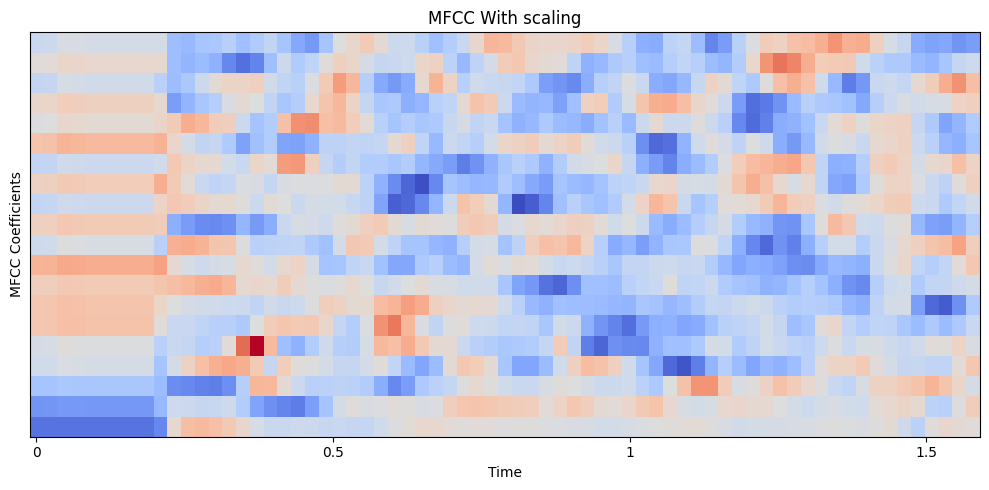

Note: Illegal Audio-MPEG-Header 0xc5fffb92 at offset 22986.
Note: Trying to resync...
Note: Skipped 1 bytes in input.




Total MFCC features are: 20 for total 69 frames.


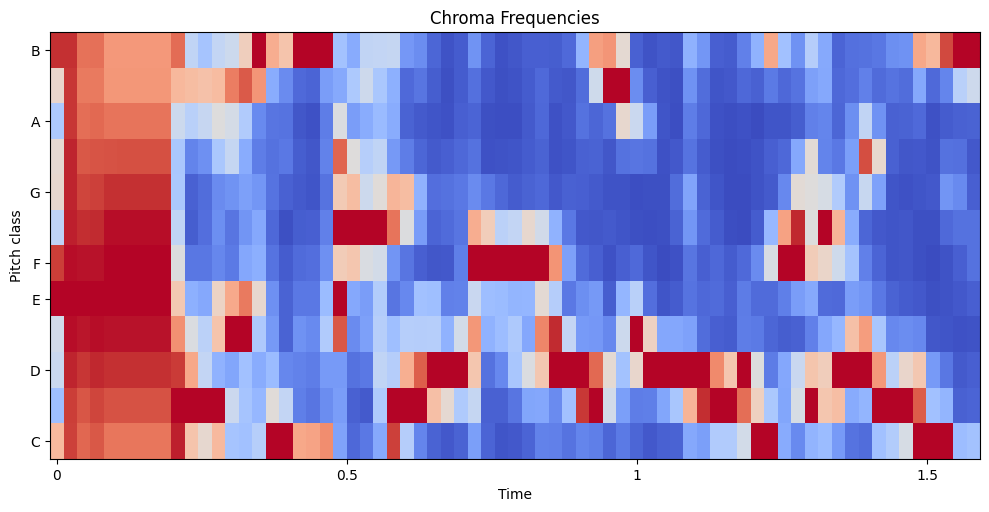

Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

Note: Illegal Audio-MPEG-Header 0x408c1436 at offset 54333.
Note: Trying to resync...
Note: Skipped 30 bytes in input.


1/1 [==============================] - 0s 109ms/step
Result: female
Probabilities:     Male: 13.37%    Female: 86.63%

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB



audios/2023_06_10_16_20_09.mp3


Note: Illegal Audio-MPEG-Header 0x408c1436 at offset 54333.
Note: Trying to resync...
Note: Skipped 30 bytes in input.
Note: Illegal Audio-MPEG-Header 0x408c1436 at offset 54333.
Note: Trying to resync...
Note: Skipped 30 bytes in input.


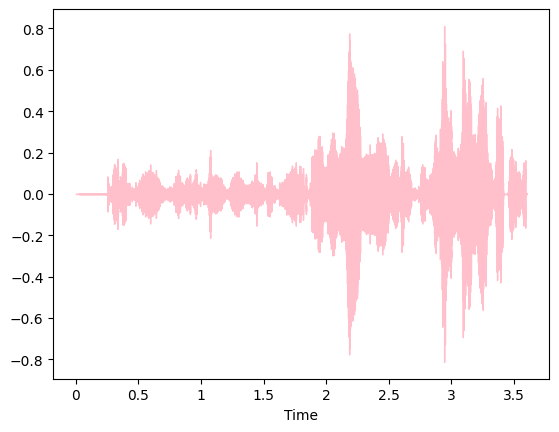

<Figure size 640x480 with 0 Axes>

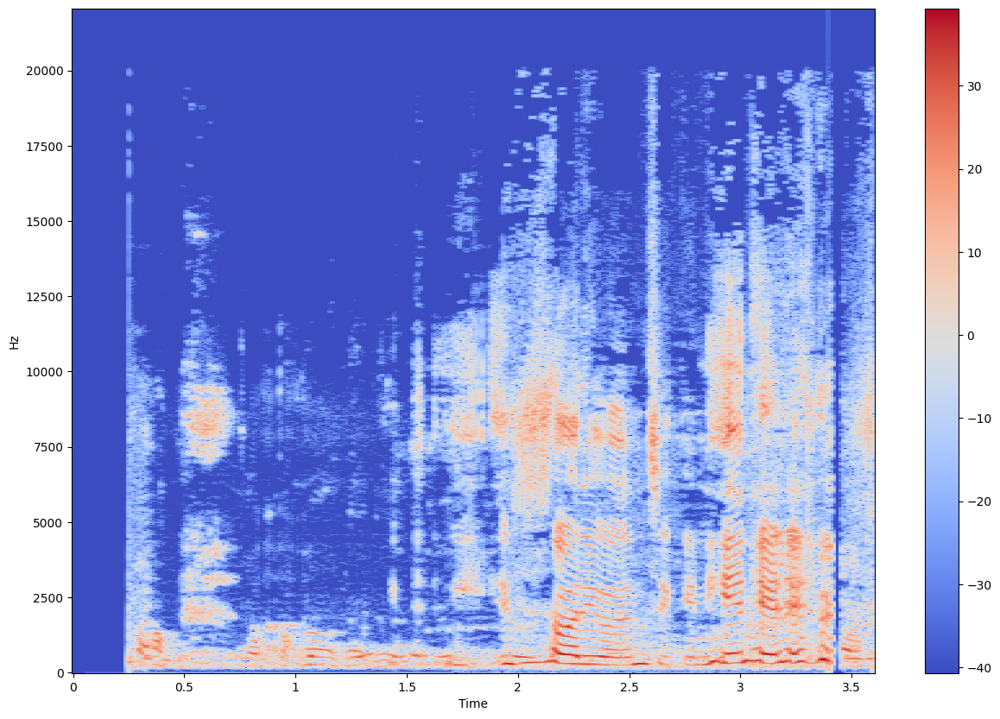

    
Pitch Range: 3991.4944
    


<Figure size 640x480 with 0 Axes>

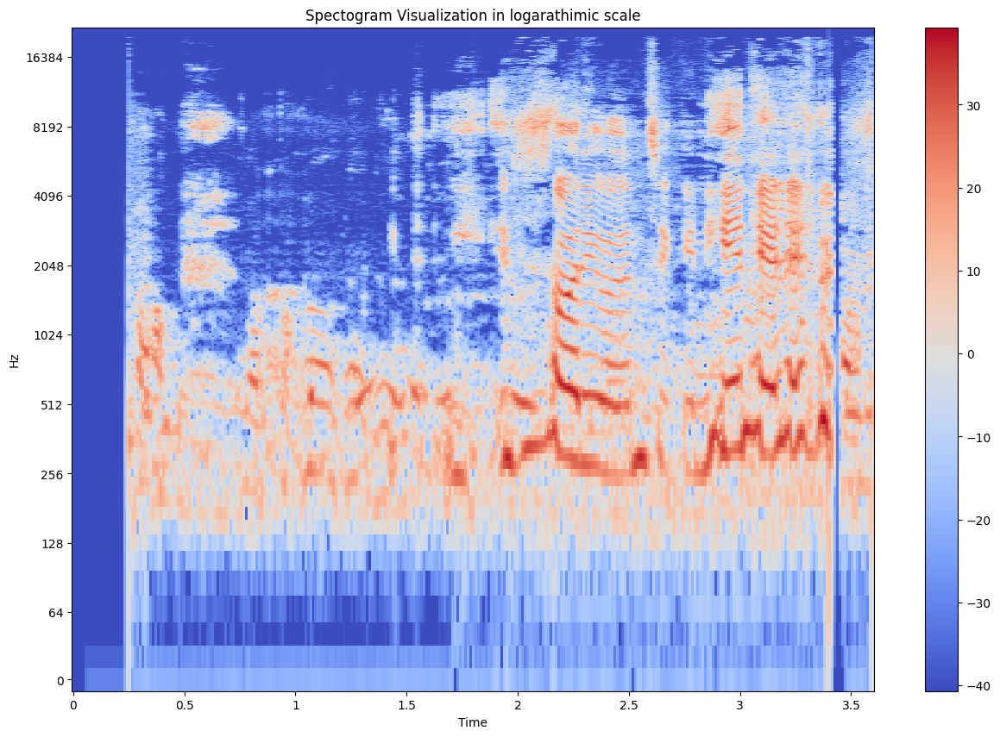

estimated temopo is  123.046875
(7,)


Note: Illegal Audio-MPEG-Header 0x408c1436 at offset 54333.
Note: Trying to resync...
Note: Skipped 30 bytes in input.


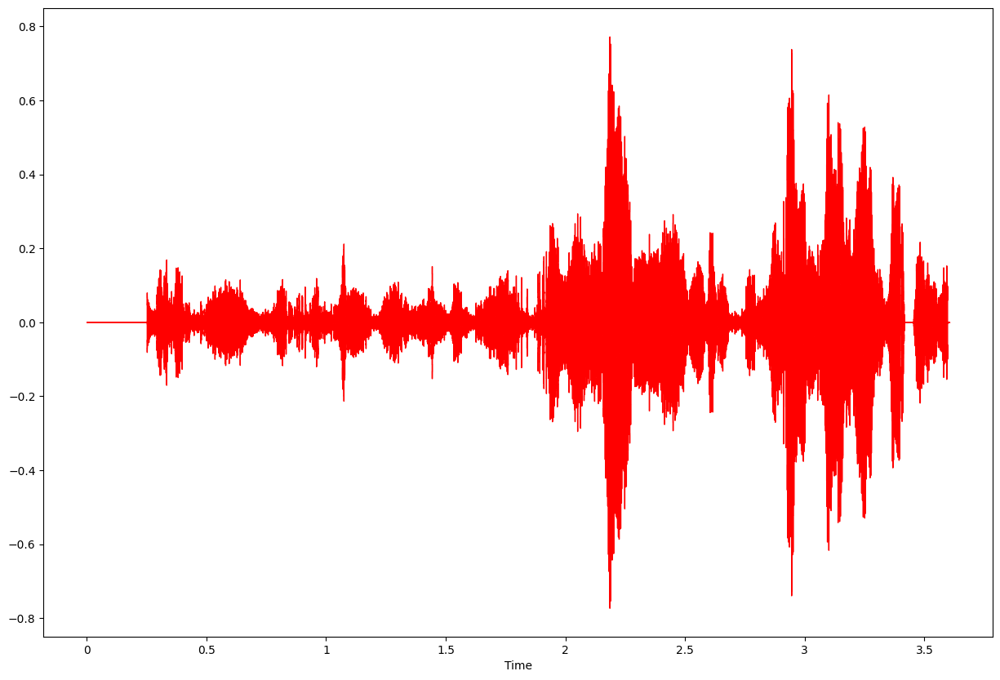

zero crossing ################
Zero Crossings in totla are :  13171
frames :   range(0, 156)
Shape of frames to time is  : (156,)
Plotting the Spectral Centroid along with the wave form


Note: Illegal Audio-MPEG-Header 0x408c1436 at offset 54333.
Note: Trying to resync...
Note: Skipped 30 bytes in input.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
Note: Illegal Audio-MPEG-Header 0x408c1436 at offset 54333.
Note: Trying to resync...
Note: Skipped 30 bytes in input.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
Note: Illegal Audio-MPEG-Header 0x408c1436 at offset 54333.
Note: Trying to resync...
Note: Skipped 30 bytes in input.


The audio wave form is in blue color
The spectral centroid in red color
Shape of Spectral Rolloff (156,)
Shape of frames to time is  : (156,)
Plotting the Spectral Centroid along with the wave form
The audio wave form is in blue color
The spectral Rolloff in red color


Enter the number of MFCC to be extracted:  


No input provided. Using default value for num_mfcc.


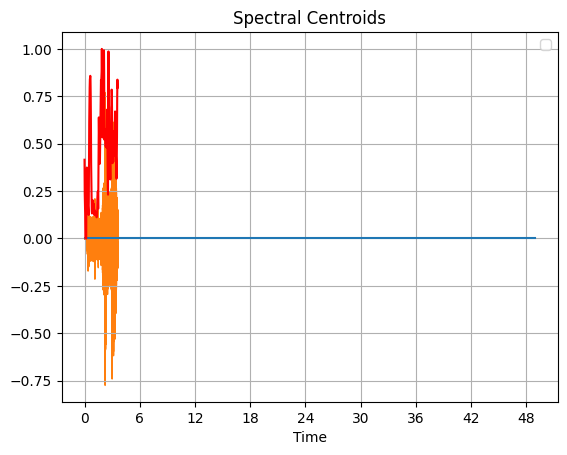

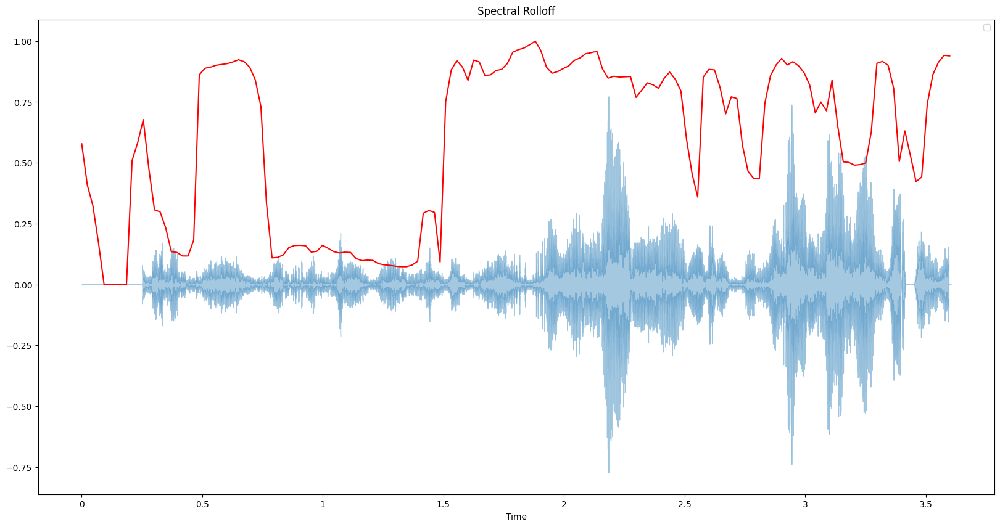

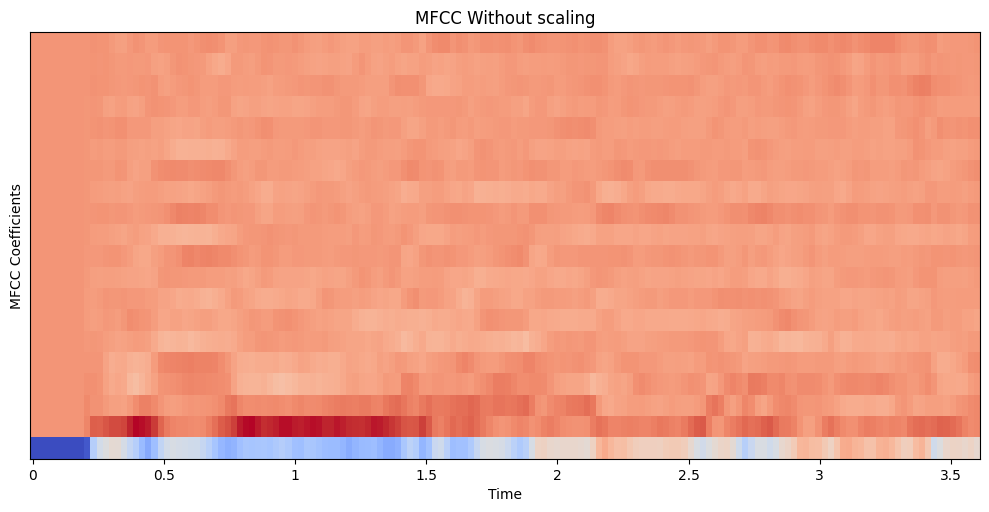

[-2.4453188e-08  0.0000000e+00  1.2226594e-08  0.0000000e+00
  0.0000000e+00 -1.5283243e-08 -1.5283242e-09  0.0000000e+00
  1.2226594e-08  0.0000000e+00  0.0000000e+00  0.0000000e+00
  0.0000000e+00  0.0000000e+00  1.2226594e-08 -9.1699457e-09
 -1.2226594e-08  0.0000000e+00  0.0000000e+00  1.2226594e-08]
[1.        1.        1.0000001 1.        1.        1.0000001 1.
 1.        1.0000001 1.        1.        0.9999999 0.9999999 1.
 1.        1.        1.        1.        1.        1.       ]


/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


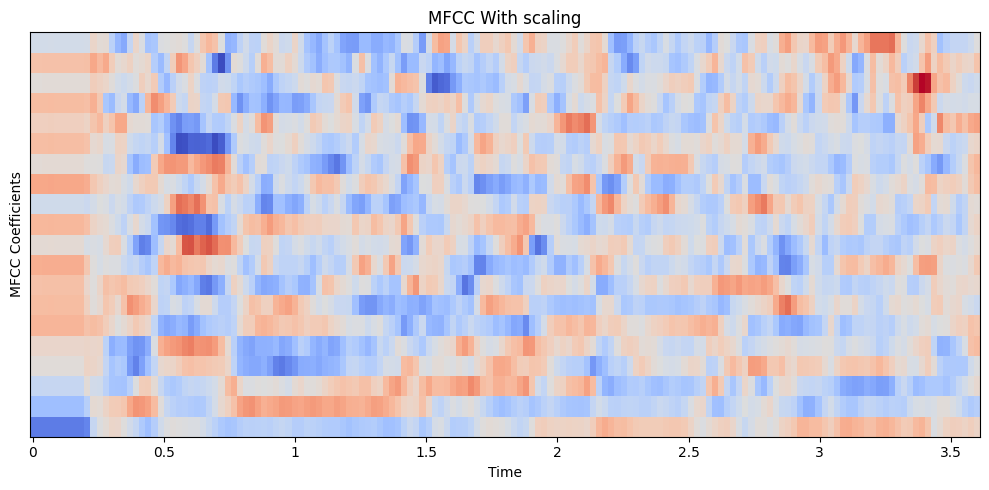

Note: Illegal Audio-MPEG-Header 0x408c1436 at offset 54333.
Note: Trying to resync...
Note: Skipped 30 bytes in input.




Total MFCC features are: 20 for total 156 frames.


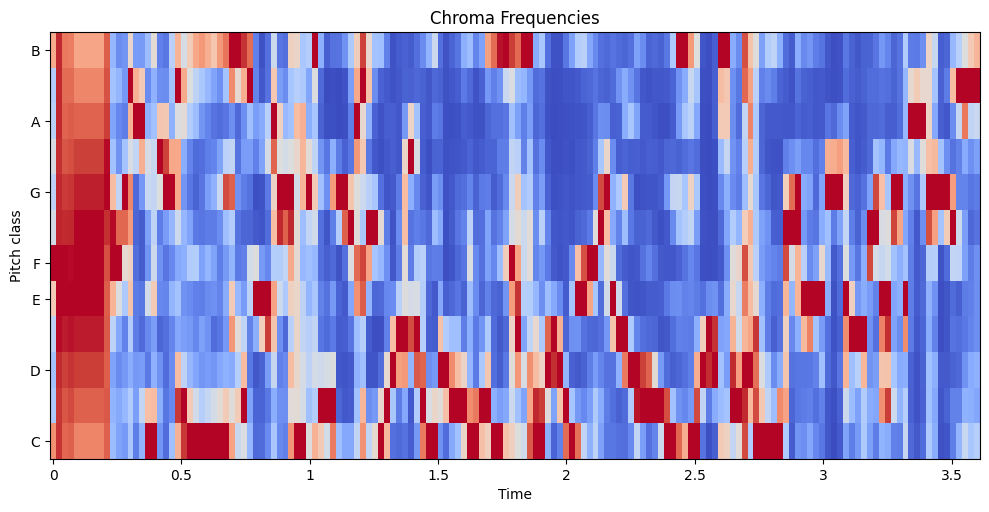

Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

audios/2023_06_10_11_59_20.mp3


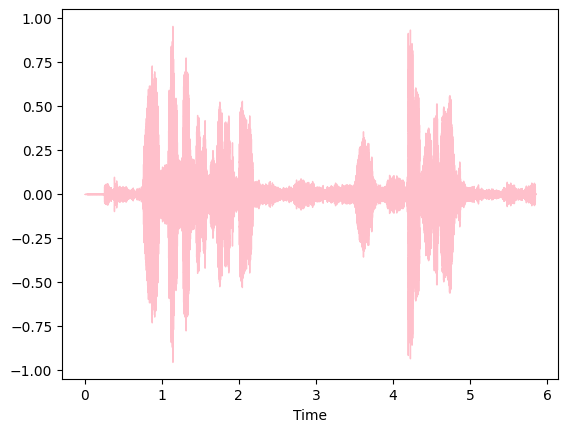

<Figure size 640x480 with 0 Axes>

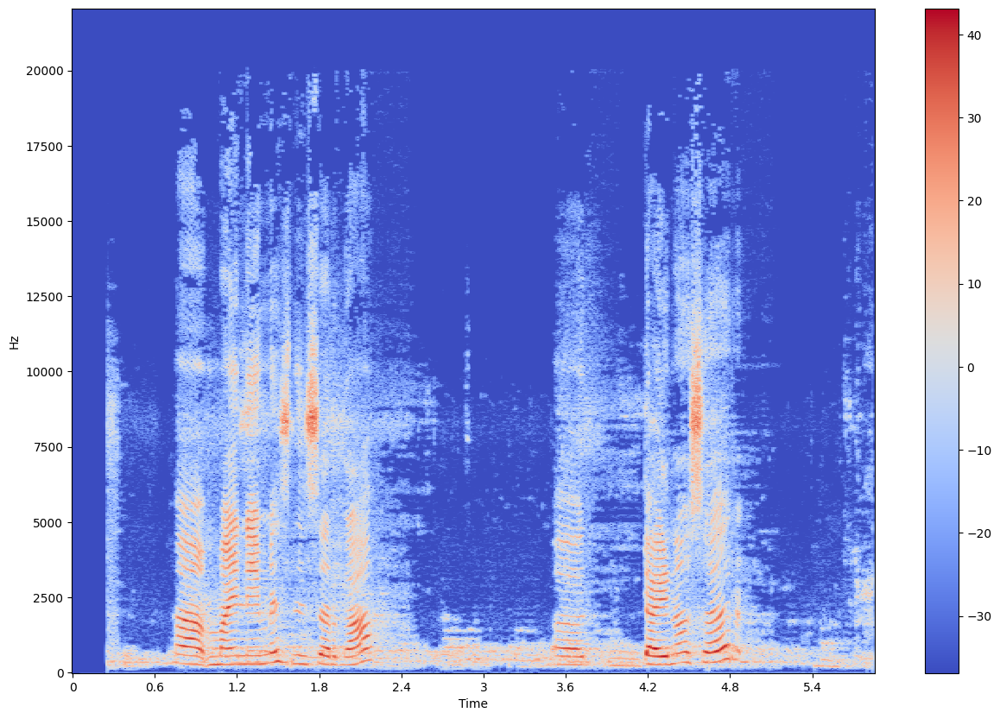

    
Pitch Range: 3990.2556
    


<Figure size 640x480 with 0 Axes>

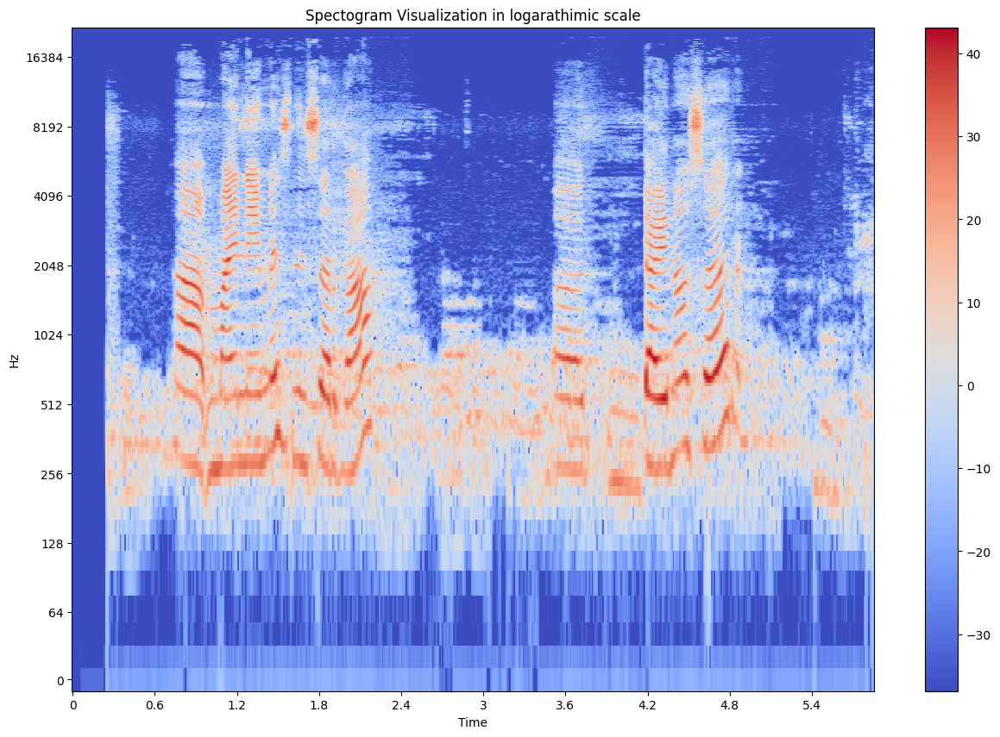

estimated temopo is  90.66611842105263
(7,)


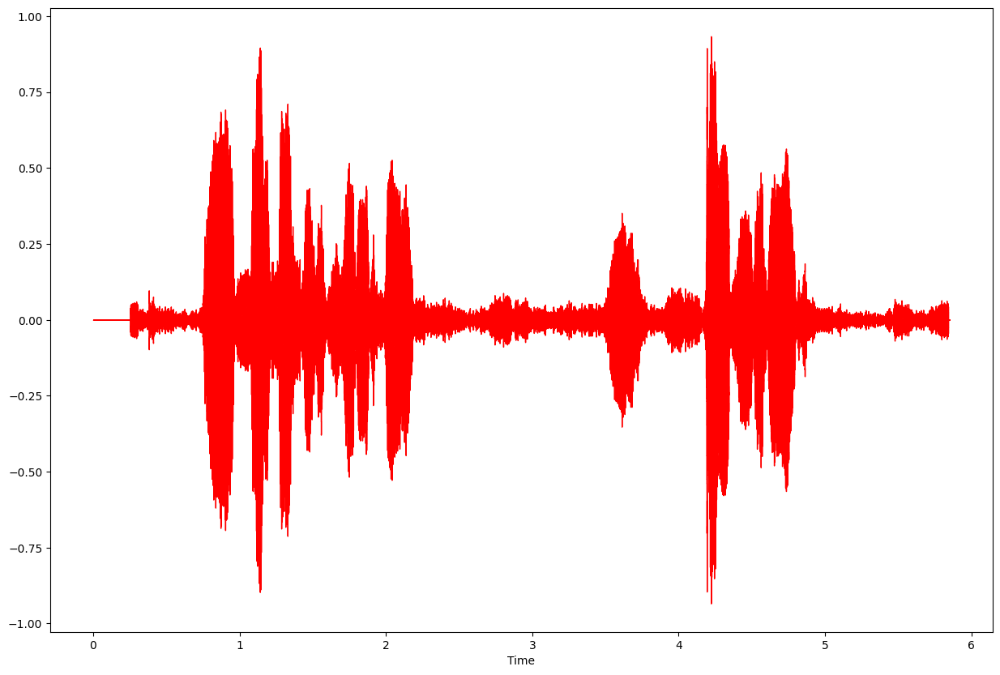

zero crossing ################
Zero Crossings in totla are :  14857
frames :   range(0, 253)
Shape of frames to time is  : (253,)
Plotting the Spectral Centroid along with the wave form


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


The audio wave form is in blue color
The spectral centroid in red color
Shape of Spectral Rolloff (253,)
Shape of frames to time is  : (253,)
Plotting the Spectral Centroid along with the wave form
The audio wave form is in blue color
The spectral Rolloff in red color


Enter the number of MFCC to be extracted:  


No input provided. Using default value for num_mfcc.


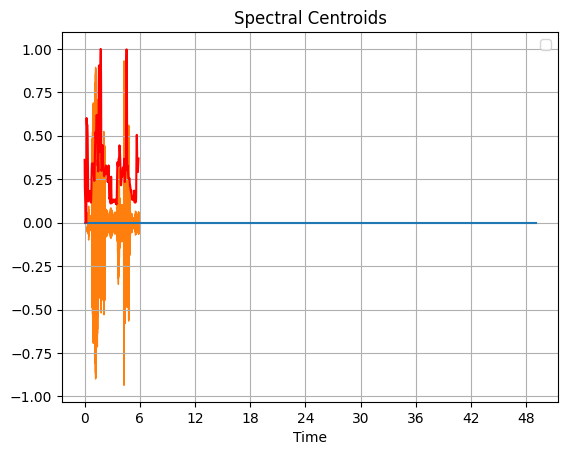

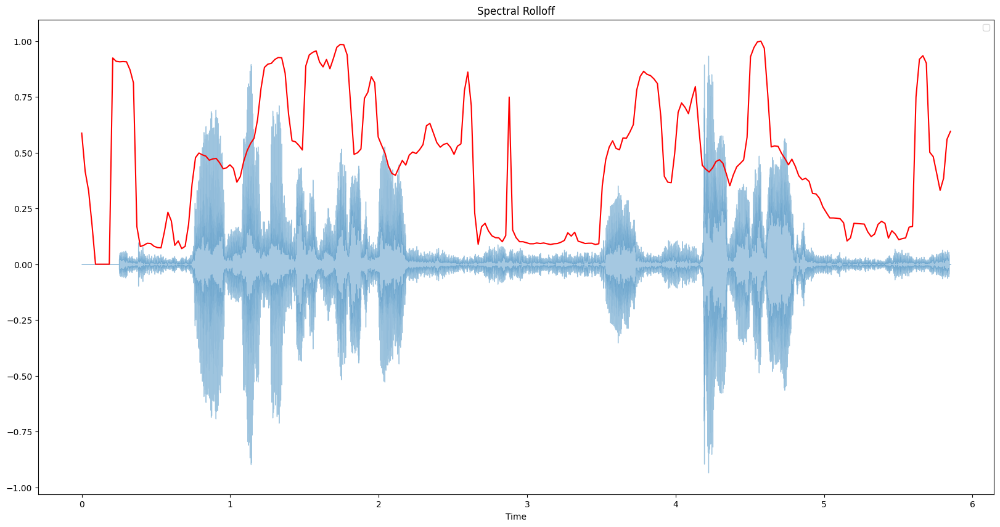

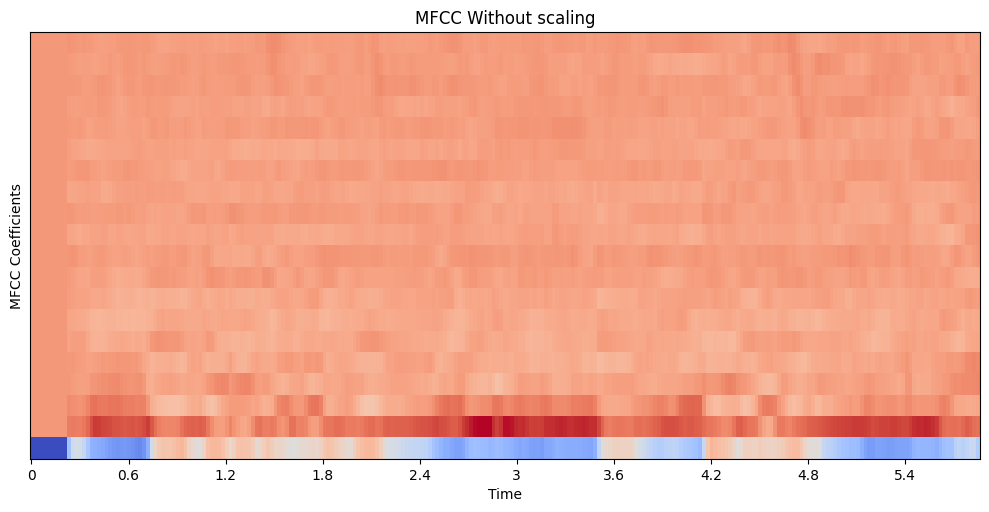

[ 0.0000000e+00  0.0000000e+00  0.0000000e+00  0.0000000e+00
 -1.5077855e-08  1.5077855e-08  3.7694639e-09  0.0000000e+00
  0.0000000e+00 -7.5389277e-09  0.0000000e+00  6.0311422e-08
  0.0000000e+00  1.8847319e-09  0.0000000e+00 -7.5389277e-09
 -7.5389277e-09 -7.5389277e-09  1.5077855e-08 -3.7694639e-09]
[0.99999994 0.99999994 0.99999994 1.0000001  1.         0.9999999
 0.99999976 1.0000001  0.99999994 1.         1.0000001  0.99999994
 0.9999999  1.0000001  0.99999994 1.         0.9999999  1.0000001
 1.0000001  1.        ]


/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:240: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/Users/nanda/miniforge3/envs/env_tensor/lib/python3.8/site-packages/sklearn/preprocessing/_data.py:259: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


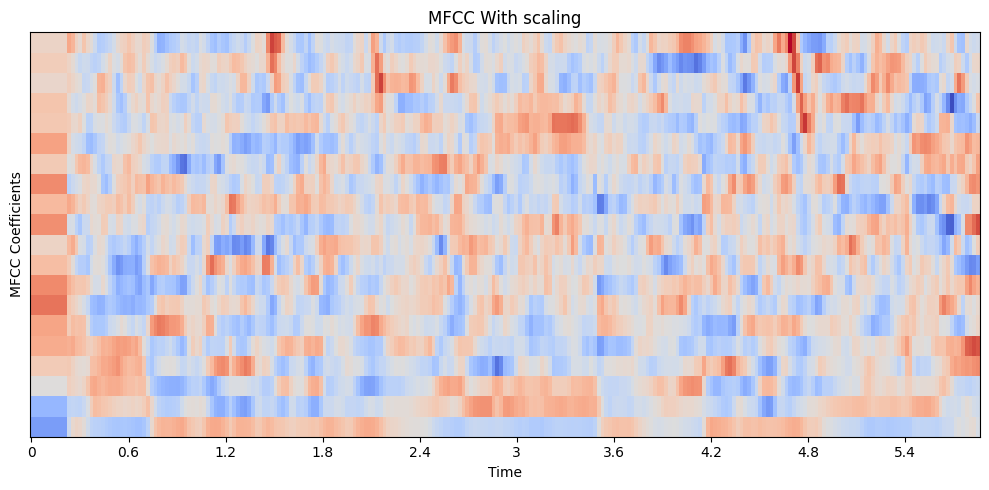



Total MFCC features are: 20 for total 253 frames.


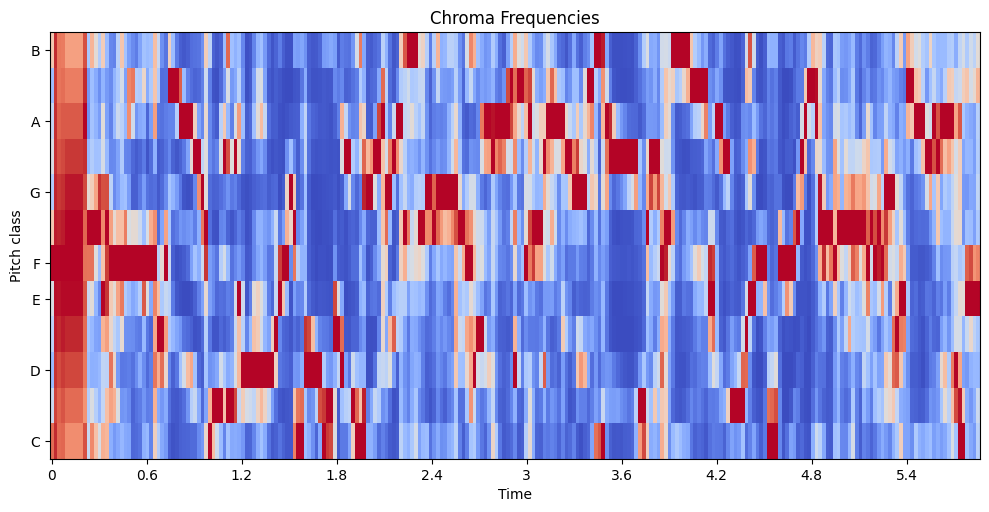

Press Enter to process the next file... 


Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

audios/2023_06_10_15_55_00.mp3


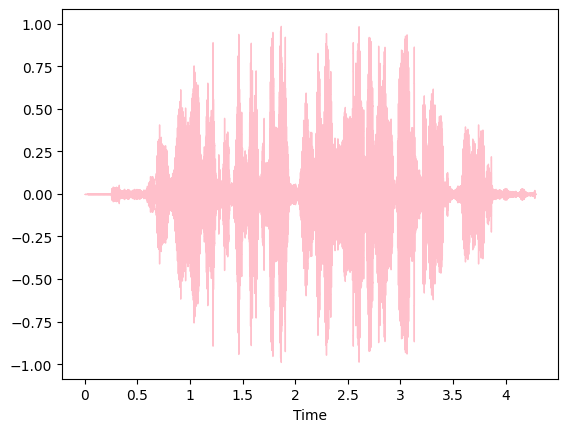

<Figure size 640x480 with 0 Axes>

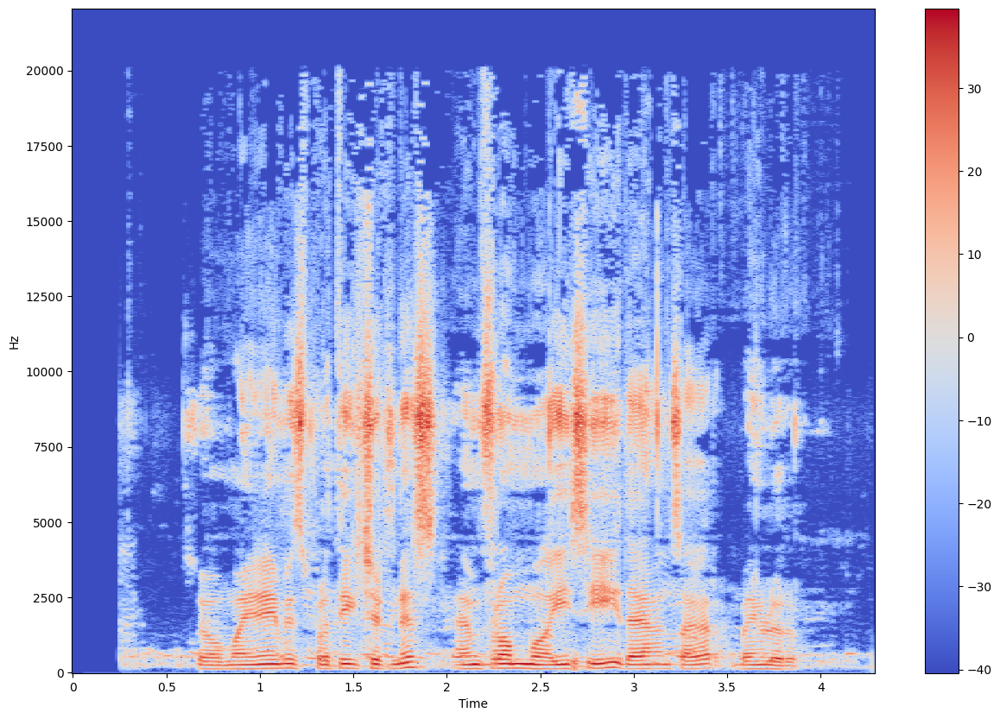

    
Pitch Range: 3986.338
    


<Figure size 640x480 with 0 Axes>

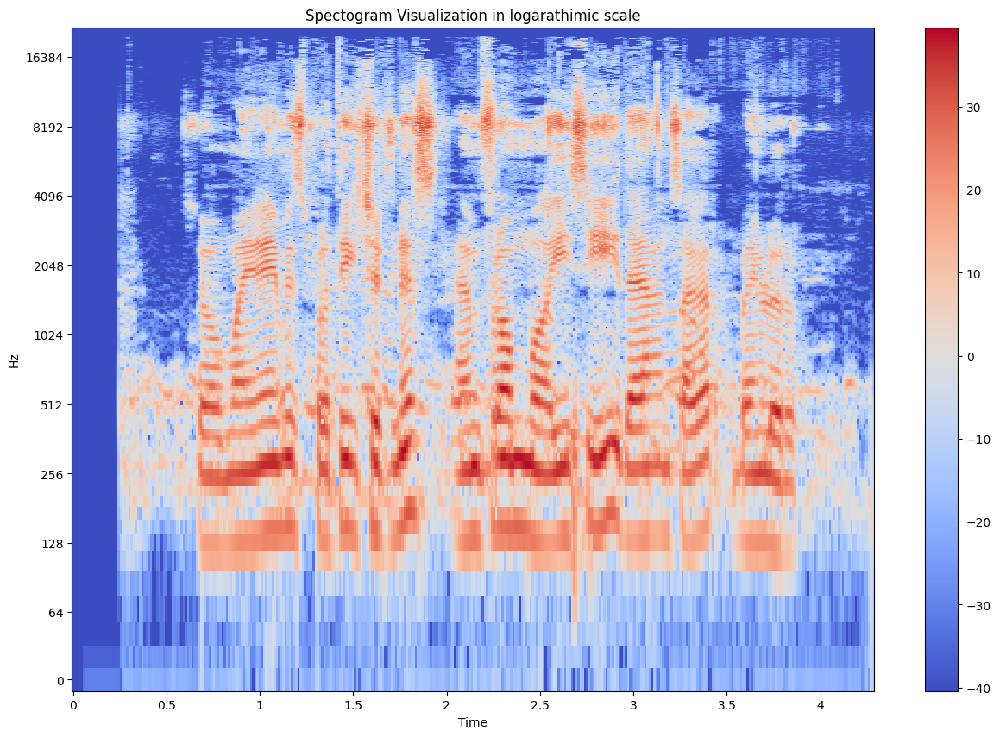

estimated temopo is  135.99917763157896
(6,)


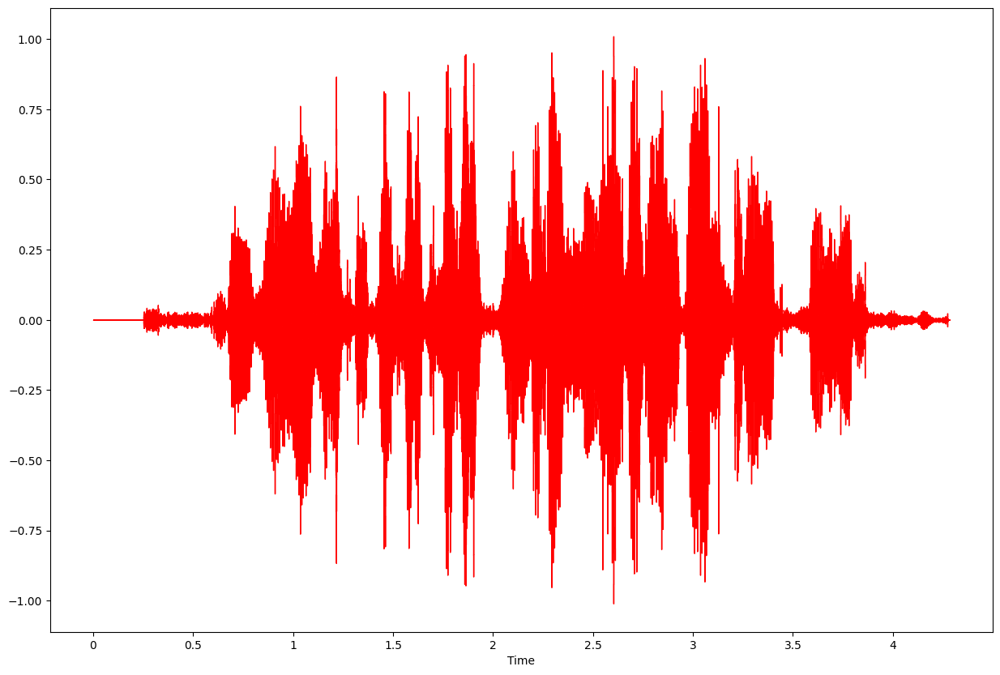

zero crossing ################
Zero Crossings in totla are :  19471
frames :   range(0, 185)
Shape of frames to time is  : (185,)
Plotting the Spectral Centroid along with the wave form


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


The audio wave form is in blue color
The spectral centroid in red color
Shape of Spectral Rolloff (185,)
Shape of frames to time is  : (185,)
Plotting the Spectral Centroid along with the wave form
The audio wave form is in blue color
The spectral Rolloff in red color


KeyboardInterrupt: Interrupted by user

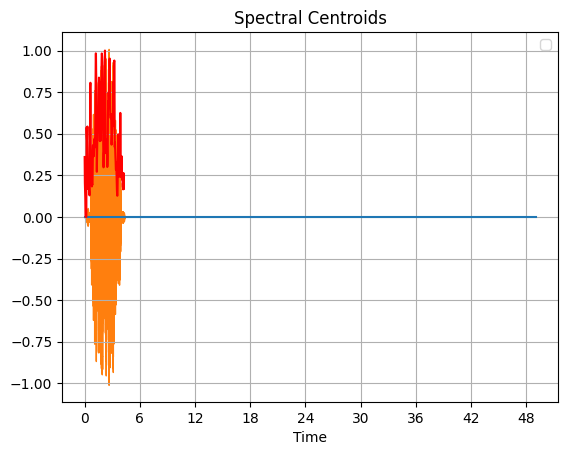

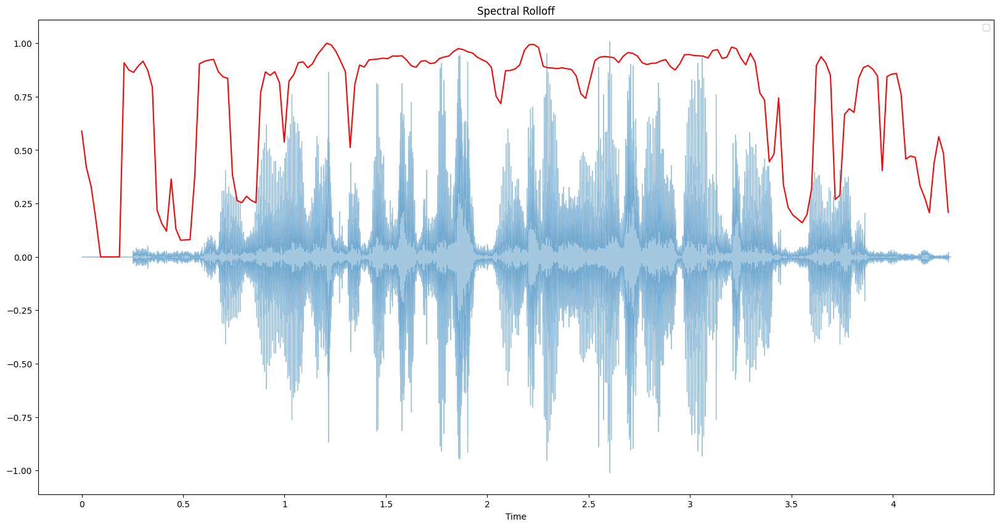

In [50]:
##### import os
import subprocess
from IPython.display import Audio

data_folder = 'audios/'  # Path to your data folder

# Iterate over audio files in the data folder
for filename in os.listdir(data_folder):
    if filename.endswith('.mp3'):  # Adjust the file extension if necessary
        file1 = os.path.join(data_folder, filename)
        command = f"python test.py --file {file1}"
        subprocess.run(command, shell=True)
        audio = Audio(file1)
        display(audio)
        print(file1)
        
        feature_viz(file1)
        
        input("Press Enter to process the next file...")
        
        

In [151]:
import IPython.display as ipd
!python test1.py --file "new3"


Metal device set to: Apple M1 Pro

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                         

In [120]:
x = extract_feature('audios/2023_06_10_13_00_29.mp3',mel=True)
print(x.shape)
x

(128,)


array([6.79950172e-04, 9.73353628e-03, 8.30321088e-02, 2.21784532e-01,
       5.40320992e-01, 7.45572865e-01, 7.91211128e-01, 2.81241488e+00,
       5.82943106e+00, 4.55186081e+00, 2.13408303e+00, 1.98660171e+00,
       9.82016385e-01, 7.27218926e-01, 2.07658315e+00, 4.10779381e+00,
       6.15336180e+00, 6.51039171e+00, 4.06693077e+00, 3.44126892e+00,
       1.37207842e+00, 1.14184439e+00, 9.89210069e-01, 1.32938147e+00,
       2.43020344e+00, 5.24992323e+00, 5.00972700e+00, 2.43565130e+00,
       3.73389816e+00, 3.04967332e+00, 1.75447237e+00, 1.76556456e+00,
       2.35334253e+00, 7.38768148e+00, 7.75386858e+00, 6.16872978e+00,
       2.56716180e+00, 7.58501351e-01, 1.67963696e+00, 1.33705413e+00,
       2.28357720e+00, 3.34445000e+00, 5.60325480e+00, 2.96951294e+00,
       2.53235555e+00, 2.82385200e-01, 7.05995560e-01, 1.08031309e+00,
       5.07454538e+00, 5.75841379e+00, 1.88687980e+00, 1.49648237e+00,
       2.93120801e-01, 4.65701461e-01, 4.59168822e-01, 3.48660797e-01,
      

## Function for Running Multiple Voice Samples

Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                                                 
 dense_3 (Dense)      

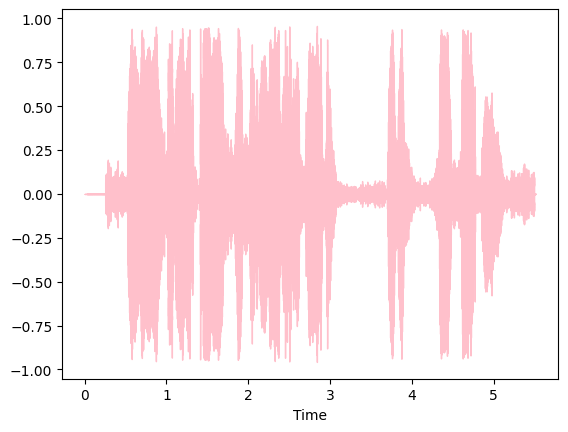

<Figure size 640x480 with 0 Axes>

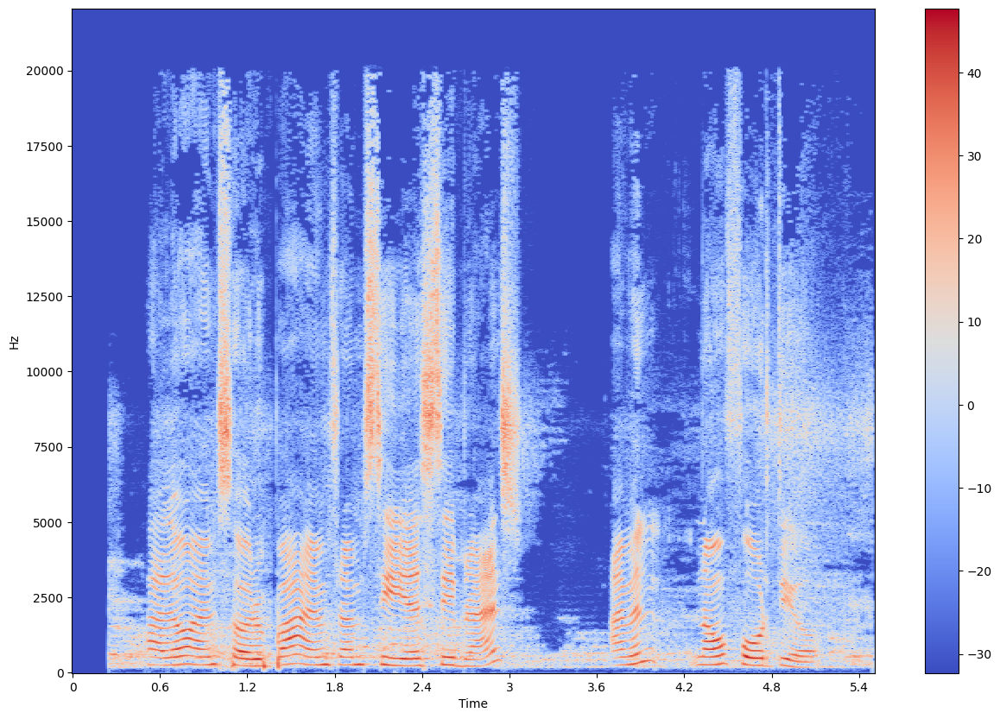

    
Pitch Range: 3988.9822
    
Energy Distributions: [2.66353095e-09 4.14454115e-09 5.62552938e-09 5.92406035e-09
 5.92403948e-09 5.92403948e-09 5.92403104e-09 5.01172908e-04
 5.70920669e-03 1.67797133e-02 2.16468945e-02 2.33458970e-02
 2.11599302e-02 1.35323675e-02 1.45172114e-02 1.52774807e-02
 1.62543152e-02 1.56960376e-02 1.16652055e-02 2.94780526e-02
 7.38951042e-02 1.57168731e-01 2.22462013e-01 2.80245692e-01
 2.91506857e-01 2.57938772e-01 2.89413333e-01 3.38888884e-01
 3.94987077e-01 4.76452261e-01 5.09539068e-01 5.25073767e-01
 4.98430610e-01 4.43377525e-01 3.91188413e-01 2.95515895e-01
 2.45787442e-01 2.02500284e-01 1.60954192e-01 1.26648396e-01
 1.39360934e-01 1.97552457e-01 2.87621975e-01 3.03804815e-01
 2.95496523e-01 3.00909609e-01 3.34135383e-01 5.00145733e-01
 6.48846745e-01 6.38950050e-01 5.76802254e-01 5.48937201e-01
 4.68224168e-01 4.49302167e-01 3.56844872e-01 1.92760080e-01
 8.14036950e-02 7.75123388e-02 1.23756766e-01 2.75029927e-01
 4.53320682e-01 5.35309255e-01

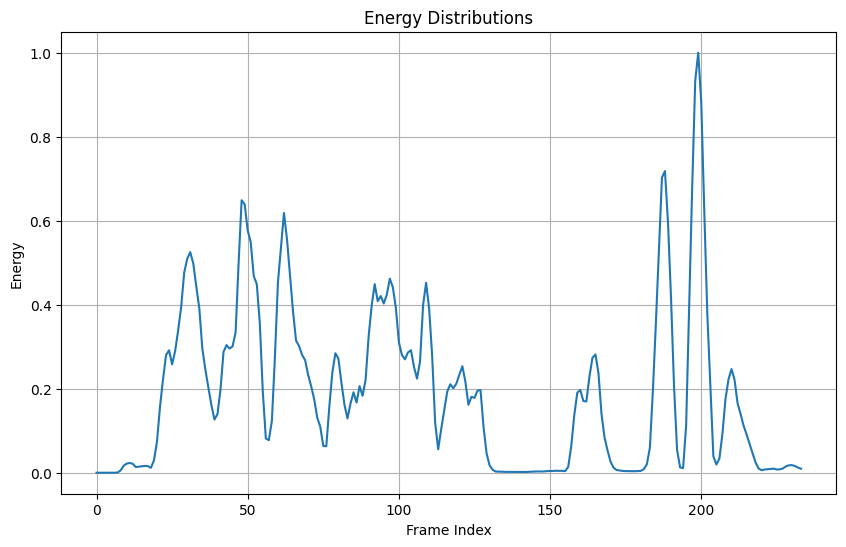

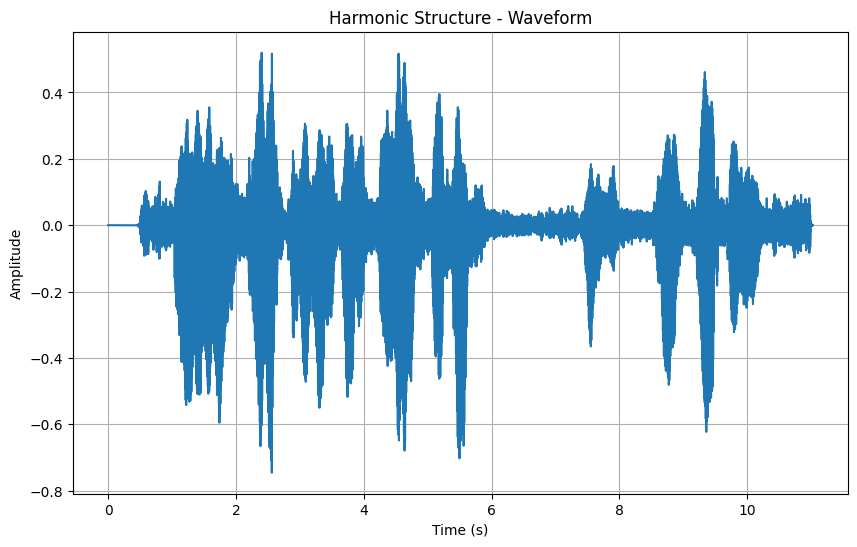

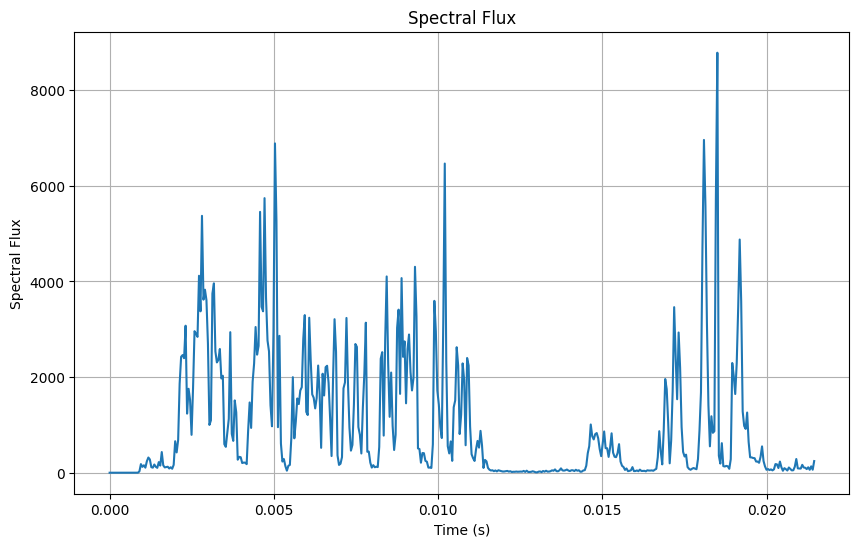

<Figure size 640x480 with 0 Axes>

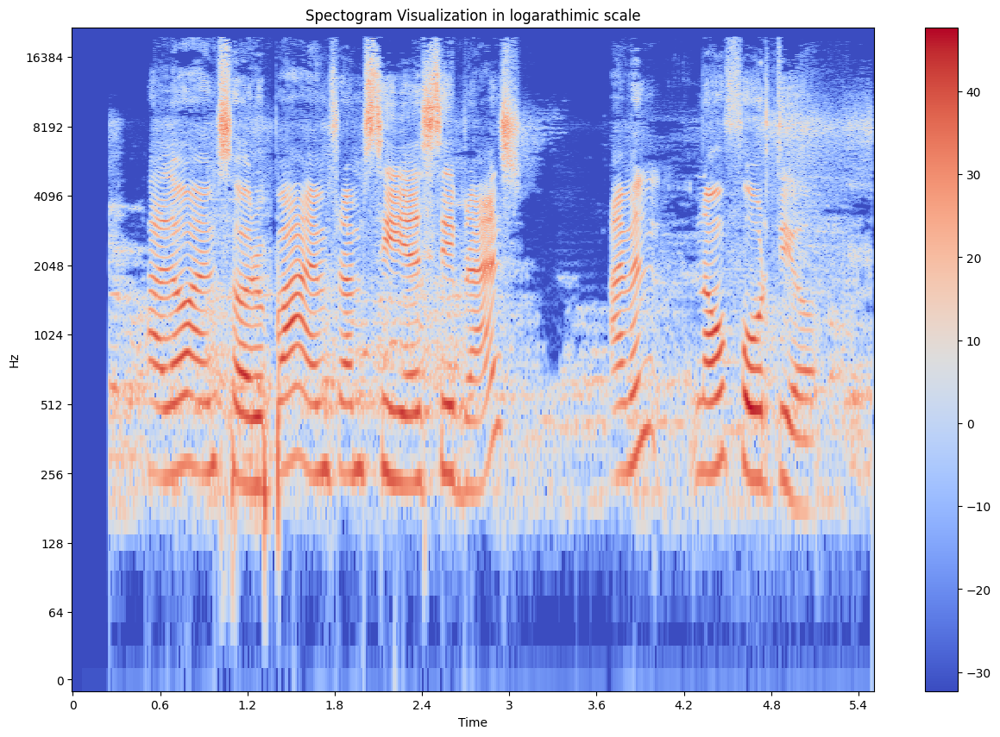

estimated temopo is  95.703125
(8,)


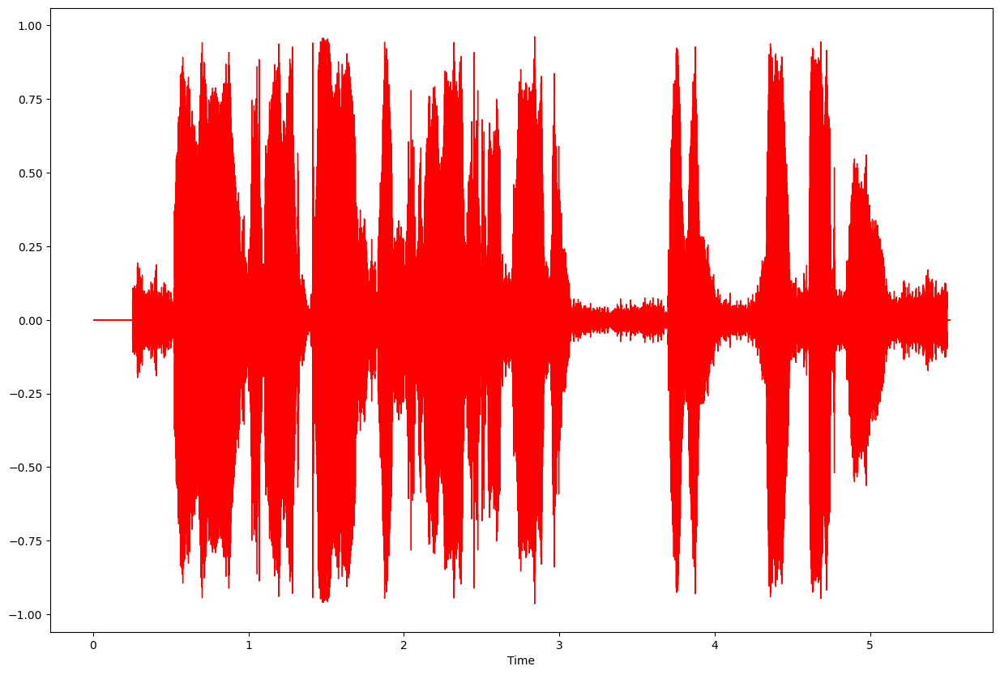

zero crossing ################
Zero Crossings in totla are :  21312
frames :   range(0, 238)
Shape of frames to time is  : (238,)
Plotting the Spectral Centroid along with the wave form


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


The audio wave form is in blue color
The spectral centroid in red color
Shape of Spectral Rolloff (238,)
Shape of frames to time is  : (238,)
Plotting the Spectral Centroid along with the wave form


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


The audio wave form is in blue color
The spectral Rolloff in red color


KeyboardInterrupt: Interrupted by user

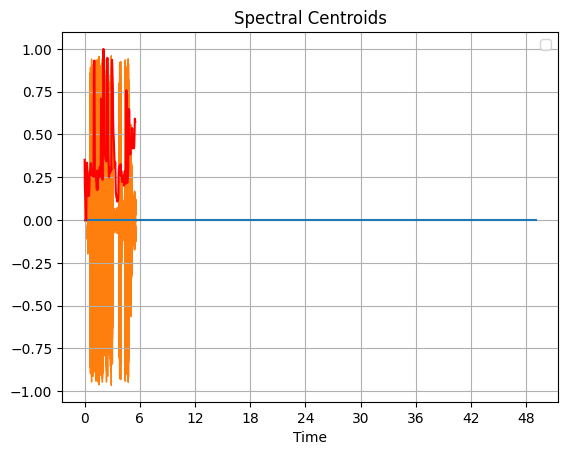

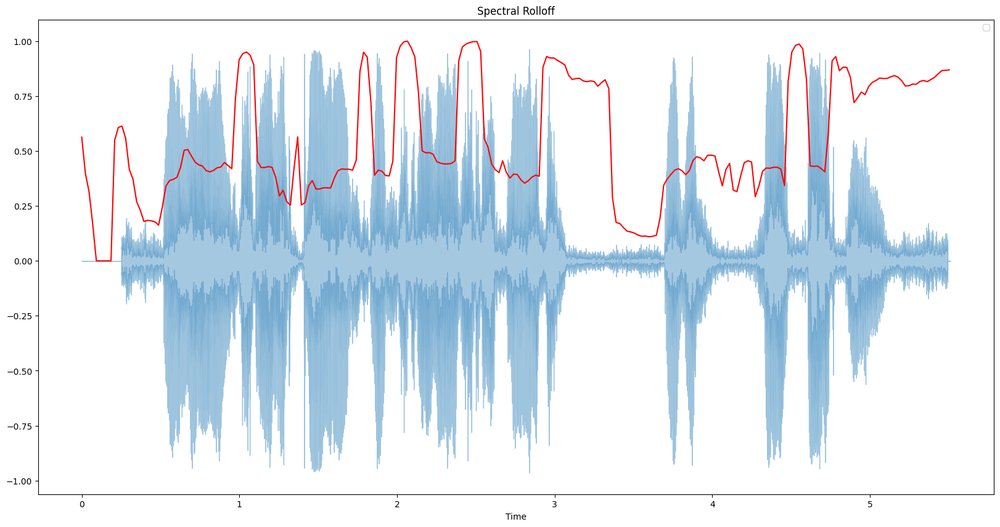

In [198]:
import os
import subprocess
from IPython.display import Audio

data_folder = 'audios/'  # Path to your data folder

# Iterate over audio files in the data folder
for filename in os.listdir(data_folder):
    if filename.endswith('.mp3'):  # Adjust the file extension if necessary
        file1 = os.path.join(data_folder, filename)
        command = f"python test1.py --file {file1}"
        subprocess.run(command, shell=True)
        audio = Audio(file1)
        display(audio)
        feature_viz(file1)
        input("Press Enter to process the next file...")


In [201]:
import IPython.display as ipd
!python test1.py --file "rghghjhfjffujjs"


Metal device set to: Apple M1 Pro

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               33024     
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 dropout_1 (Dropout)         (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dropout_2 (Dropout)         (None, 128)               0         
                                         

In [177]:
record_to_file('new16',duration=5)

'/Users/nanda/Documents/min_project2/new12'

In [179]:
ipd.Audio('/Users/nanda/Documents/min_project2/new12')